In [1]:
!pip3 install scikit-learn
!pip3 install --upgrade ../.

     |████████████████████████████████| 22.3 MB 1.8 MB/s eta 0:00:01
     |████████████████████████████████| 303 kB 30.1 MB/s eta 0:00:01
Processing /app/alphafold
  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.


  Created wheel for alphafold: filename=alphafold-2.0.0-py3-none-any.whl size=167358 sha256=323b60b926c90c80016dab4034019f20056850620d4803c6a9c0ba55ffb6330e
  Stored in directory: /tmp/pip-ephem-wheel-cache-_q81qy_j/wheels/24/78/39/1d9adc7578a3110de260b58b488a10309326e694fcdf4c2b43
Successfully built alphafold


In [2]:
from IPython.utils import io
import os
import subprocess
import tqdm.notebook

import jax
import jax.numpy as jnp
import jax.lax as lax
from jax import jit
import haiku as hk

import sys
sys.path.append('/opt/conda/lib/python3.7/site-packages')

import os
os.environ['TF_FORCE_UNIFIED_MEMORY'] = '1'
os.environ['XLA_PYTHON_CLIENT_MEM_FRACTION'] = '2.0'

from urllib import request
from concurrent import futures
import json
from matplotlib import gridspec
import matplotlib.pyplot as plt
import numpy as np
#import py3Dmol

from functools import partial
import math
import sklearn
from sklearn.decomposition import PCA
import scipy

import alphafold

from alphafold.data import parsers
from alphafold.data import pipeline
from alphafold.data.tools import jackhmmer

from alphafold.common import protein

from alphafold.relax import relax
from alphafold.relax import utils

from IPython import display
from ipywidgets import GridspecLayout
from ipywidgets import Output

from enum import Enum

from numpy.polynomial import polynomial as P

In [3]:
## alphafold-inspect

class MODEL_NAMES(Enum):
    model_1 = 'model_1'
    model_2 = 'model_2'
    model_3 = 'model_3'
    model_4 = 'model_4'
    model_5 = 'model_5'
    model_1_ptm = 'model_1_ptm'
    model_2_ptm = 'model_2_ptm'
    model_3_ptm = 'model_3_ptm'
    model_4_ptm = 'model_4_ptm'
    model_5_ptm = 'model_5_ptm'
    
    
def load_model(folder, model_name):
    model_name = MODEL_NAMES[model_name].value
    from alphafold.model import config
    from alphafold.model import data
    config = config.model_config(model_name)
    params = data.get_model_haiku_params(model_name, folder)
    return config, params


class _LayerWrapper:
    layer_name = "layer/"
    param_basename = 'alphafold/'
    param_keys = []
    pca_param_key = 0
    base_model = None
    
    def __init__(self, config, params=None, batch_shape=(1,), rng_key=0):
        self.config = config
        self.batch_shape = tuple(batch_shape)
        self.rng_key = jax.random.PRNGKey(rng_key)
        
        self.param_basename += self.layer_name
        self.param_names = [self.param_basename + k for k in self.param_keys]
        self.layer_param_names = [self.layer_name + k for k in self.param_keys]
        
        self.params = self.init_params()
        if params is not None:
            self.load_params(params)
            
        self.pca = PCA().fit(self.params[self.layer_param_names[self.pca_param_key]]["weights"].T)
        self.components = jax.device_put(self.pca.components_)
        
    @property
    def from_pca(self):
        @jax.jit
        def _from_pca(x):
            n_components = x.shape[-1]
            return jnp.matmul(x, self.components[:n_components])
        return _from_pca
    
    @property
    def to_pca(self, n_components=3):
        @jax.jit
        def _to_pca(x):
            return jnp.matmul(x, self.components[:n_components].T)
        return _to_pca
      
    @property
    def random_key(self):
        return jax.random.split(self.rng_key)[1]
        
    @property
    def init_shape(self):
        return (0,)
        
    def init_params(self):
        init_tensor = jnp.zeros(self.init_shape)
        layer_params = hk.data_structures.to_mutable_dict(self.forward_init(self.random_key, init_tensor))
        return layer_params
    
    def load_params(self, params):
        for b, p in zip(self.layer_param_names, self.param_names):
            pdict = {}
            for k, v in params[p].items():
                if getattr(self, 'layer_id', False):
                    v = v[self.layer_id]
                pdict[k] = v
            self.params[b] = pdict
    
    @property
    def local_config(self):
        return self.config
    
    @property
    def global_config(self):
        return self.config.model.global_config
    
    @property
    def model(self):
        name = self.layer_name.replace('/', '')
        return self.base_model(self.local_config, self.global_config, name=name)

    @property
    def _forward(self):
        def _forward(x):
            return self.model(x)
        return _forward
    
    @property
    def forward_init(self):
        return hk.transform(self._forward).init
    
    @property
    def forward_apply(self):
        apply = hk.transform(self._forward).apply
        return partial(apply, self.params, self.random_key)
    
    @property
    def forward_residual(self):
        @jax.jit
        def _forward_residual(x):
            return x + self.forward_apply(x)
        return _forward_residual
    
    @property
    def jacobian(self):
        return jax.jacfwd(self.forward_apply)
    
class Linear(hk.Module):
    def __init__(self,
               num_output: int,
               initializer: str = 'linear',
               use_bias: bool = True,
               bias_init: float = 0.,
               name: str = 'linear'):
        super().__init__(name=name)
        self.num_output = num_output
        self.initializer = initializer
        self.use_bias = use_bias
        self.bias_init = bias_init

    def __call__(self, inputs: jnp.ndarray) -> jnp.ndarray:
        n_channels = int(inputs.shape[-1])

        weight_shape = [n_channels, self.num_output]
        if self.initializer == 'linear':
            weight_init = hk.initializers.VarianceScaling(mode='fan_in', scale=1.)
        elif self.initializer == 'relu':
            weight_init = hk.initializers.VarianceScaling(mode='fan_in', scale=2.)
        elif self.initializer == 'zeros':
            weight_init = hk.initializers.Constant(0.0)

        weights = hk.get_parameter('weights', weight_shape, inputs.dtype,
                                   weight_init)

        output = jnp.einsum('...c,cd->...d', inputs, weights)
        # this is equivalent to einsum('...c,cd->...d', inputs, weights)
        # but turns out to be slightly faster
        #inputs = jnp.swapaxes(inputs, -1, -2)
        #output = jnp.einsum('...cb,cd->...db', inputs, weights)
        #output = jnp.swapaxes(output, -1, -2)

        if self.use_bias:
            bias = hk.get_parameter('bias', [self.num_output], inputs.dtype,
                                  hk.initializers.Constant(self.bias_init))
            output += bias

        return output
    
class TransitionRunner(hk.Module):
    def __init__(self, config, global_config, name='transition_block'):
        super().__init__(name=name)
        self.config = config
        self.global_config = global_config

    def __call__(self, act):
        nc = act.shape[-1]
        num_intermediate = int(nc * self.config.num_intermediate_factor)

        return hk.Sequential([
            hk.LayerNorm(
                axis=[-1],
                create_scale=True,
                create_offset=True,
                name='input_layer_norm'),
            Linear(
                num_intermediate,
                initializer='relu',
                name='transition1'),
            jax.nn.relu,
            Linear(
                nc,
                initializer=alphafold.model.utils.final_init(self.global_config),
                name='transition2')
        ])(act)
    
class PairTransition(_LayerWrapper):
    layer_name = "pair_transition/"
    param_basename = "alphafold/alphafold_iteration/evoformer/evoformer_iteration/"
    param_keys = ['input_layer_norm', 'transition1', 'transition2']
    pca_param_key = 1
    base_model = TransitionRunner
    
    def __init__(self, layer_id, *args, **kwargs):
        self.layer_id = layer_id
        super(PairTransition, self).__init__(*args, **kwargs)
        
    @property
    def init_shape(self):
        c = self.config.model.embeddings_and_evoformer.pair_channel
        return (c,)
        
    @property
    def local_config(self):
        return self.config.model.embeddings_and_evoformer.evoformer.pair_transition
    
    
def from_spherical(angle_grid, r):
    return np.stack([
        r * np.cos(angle_grid[...,0]) * np.sin(angle_grid[...,1]),
        r * np.sin(angle_grid[...,0]) * np.sin(angle_grid[...,1]),
        r * np.cos(angle_grid[..., 1])
    ], axis=-1)

def to_spherical(xyz):
    return np.stack([
        np.atan2(xyz[...,1], xyz[...,0]),
        np.atan2(np.linalg.norm(xyz[...,:2], axis=-1), xyz[...,2]),
        np.linalg.norm(xyz, axis=-1)
    ], axis=-1)

def get_grid_ns(n: int = 300, dims: int = 2, sizes = (-1.0, 1.0)):
    if type(n) is int:
        n = [n] * dims
    if type(sizes[0]) in [float, int]:
        sizes = [sizes] * dims

    steps = [np.linspace(sizes[i][0], sizes[i][1], n[i]) for i in range(dims)]
    return np.stack(np.meshgrid(*steps), axis=-1)

  0%|          | 0/50 [00:00<?, ?it/s]

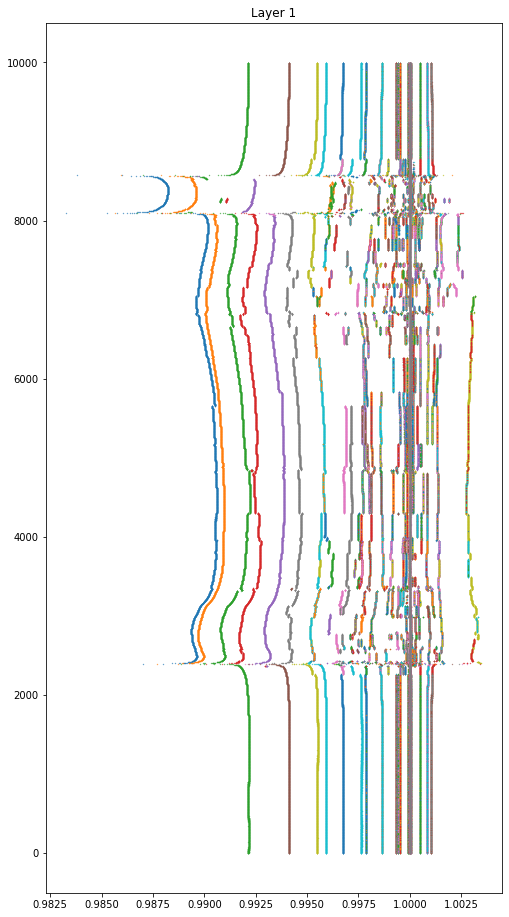

  0%|          | 0/50 [00:00<?, ?it/s]

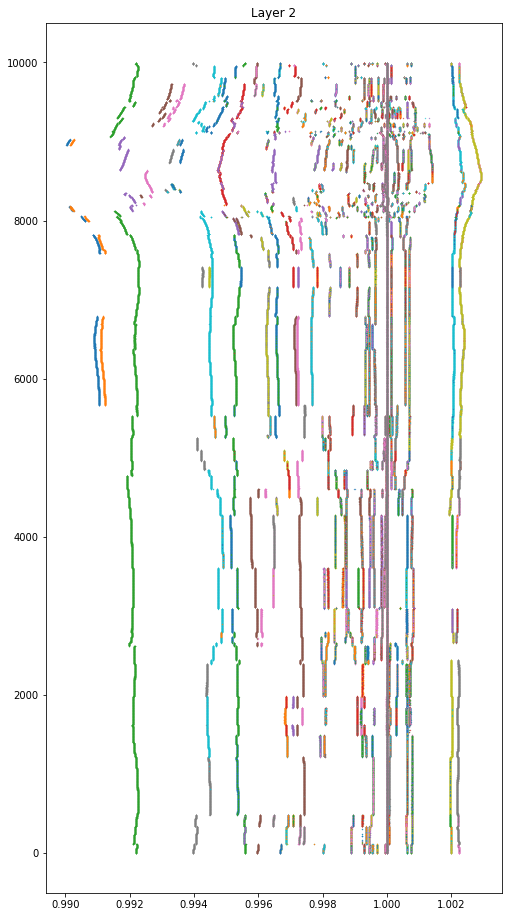

  0%|          | 0/50 [00:00<?, ?it/s]

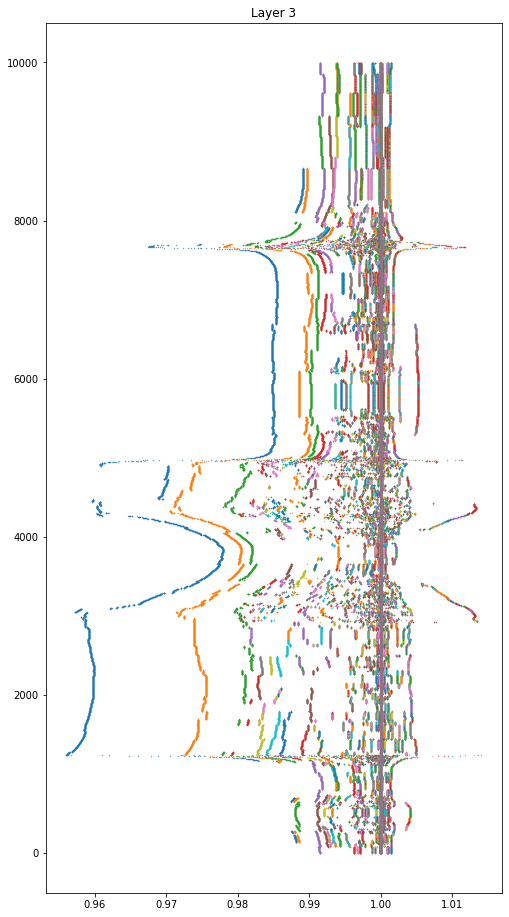

  0%|          | 0/50 [00:00<?, ?it/s]

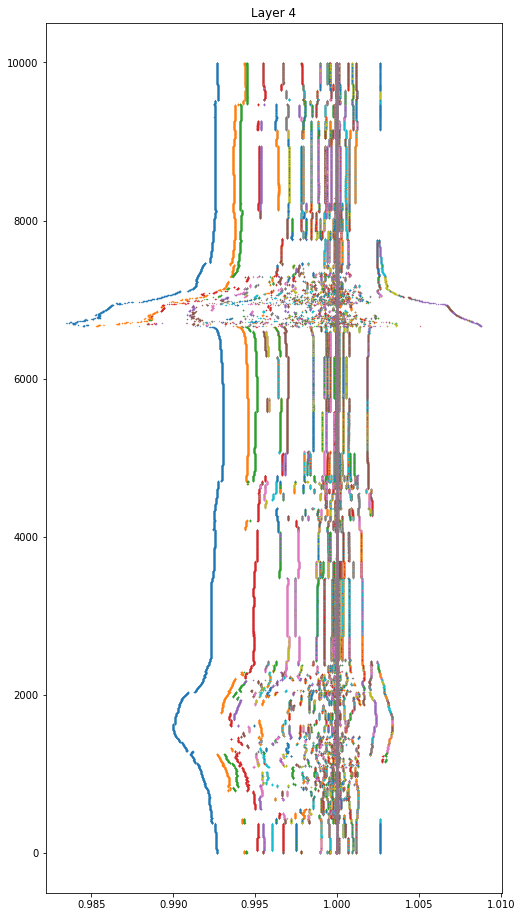

  0%|          | 0/50 [00:00<?, ?it/s]

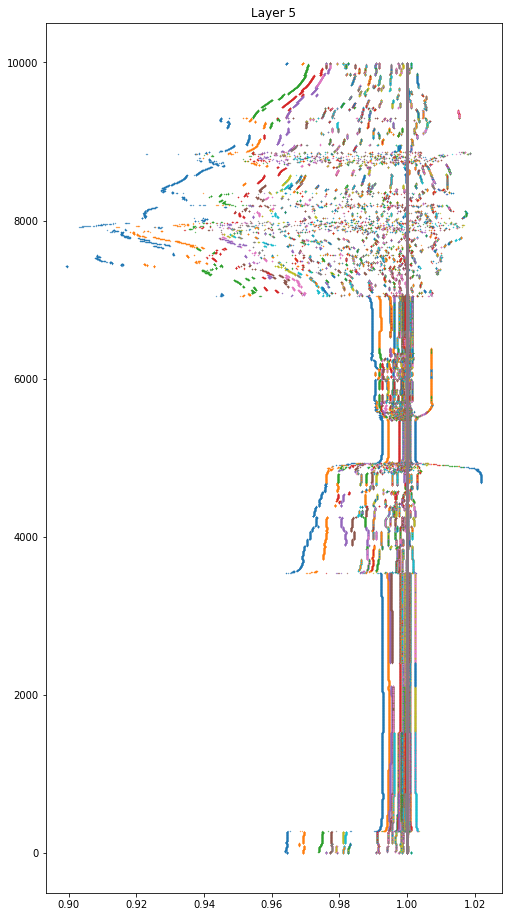

  0%|          | 0/50 [00:00<?, ?it/s]

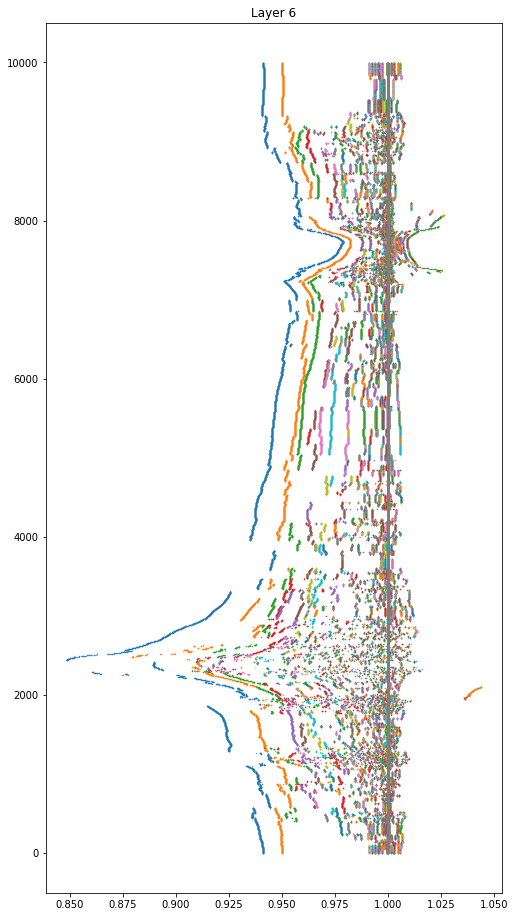

  0%|          | 0/50 [00:00<?, ?it/s]

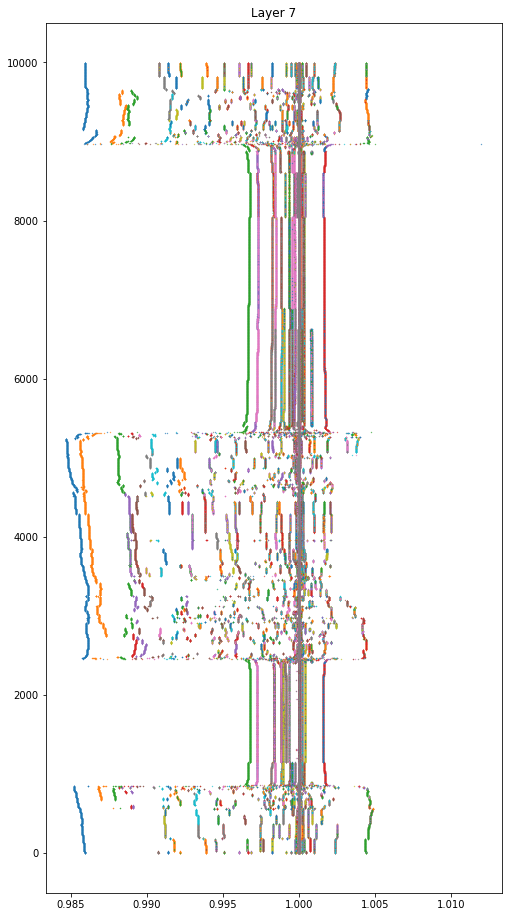

  0%|          | 0/50 [00:00<?, ?it/s]

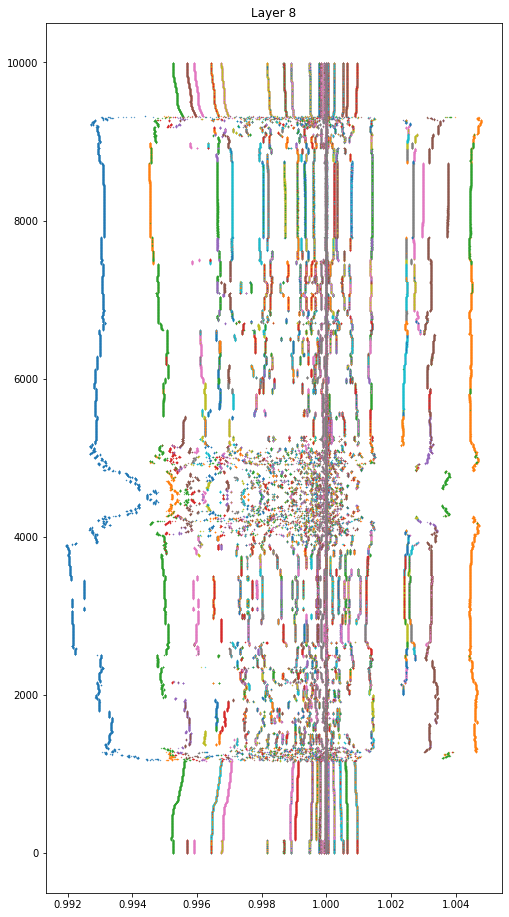

  0%|          | 0/50 [00:00<?, ?it/s]

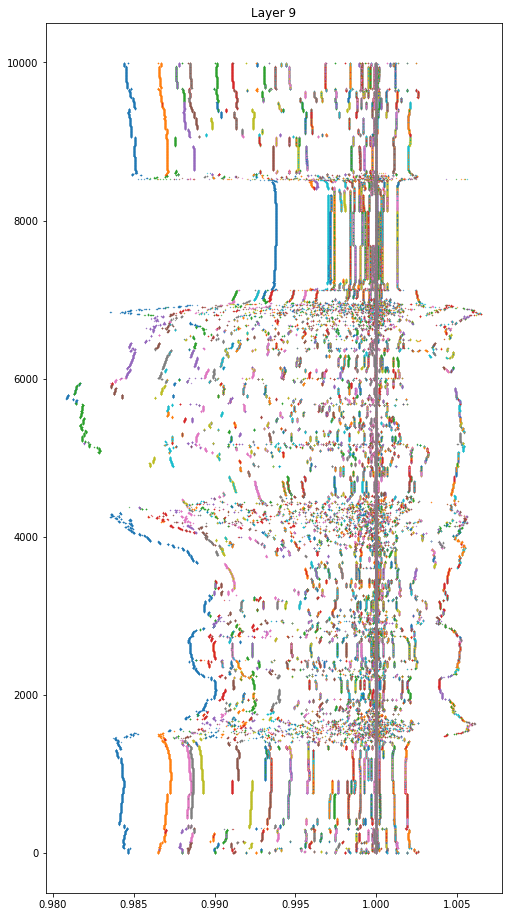

  0%|          | 0/50 [00:00<?, ?it/s]

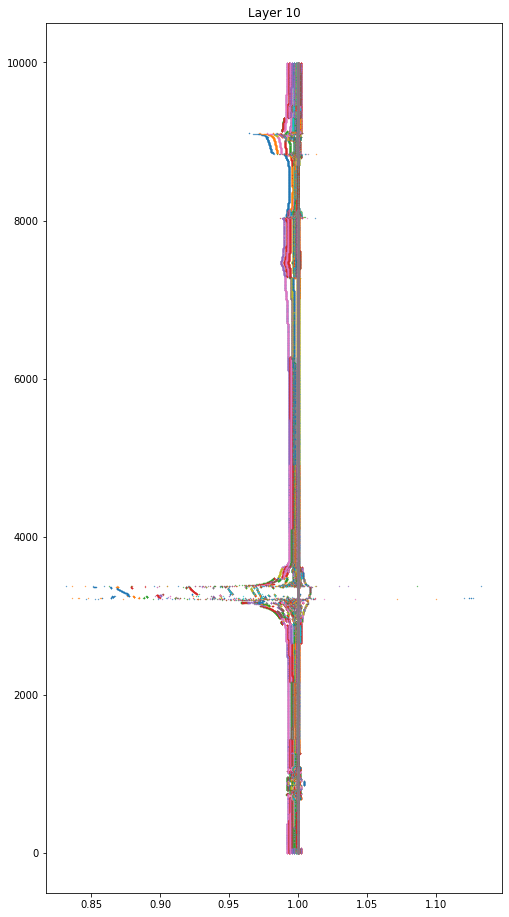

  0%|          | 0/50 [00:00<?, ?it/s]

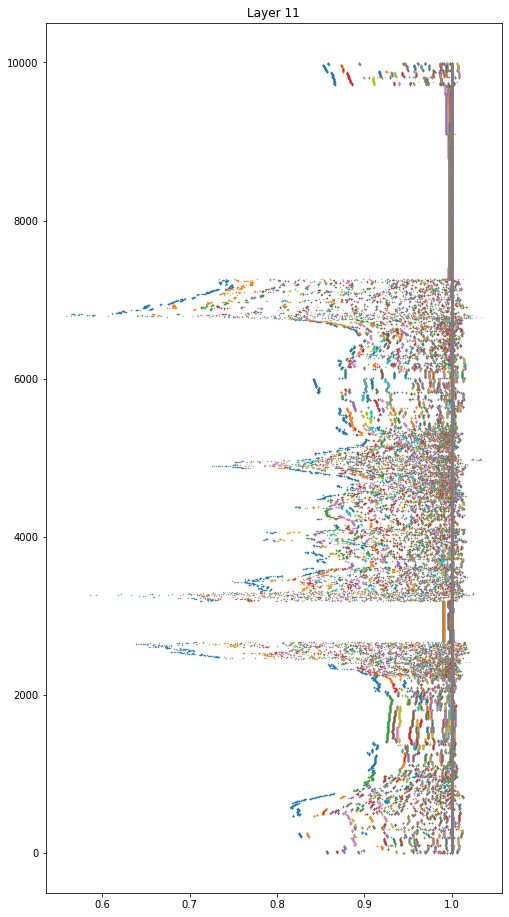

  0%|          | 0/50 [00:00<?, ?it/s]

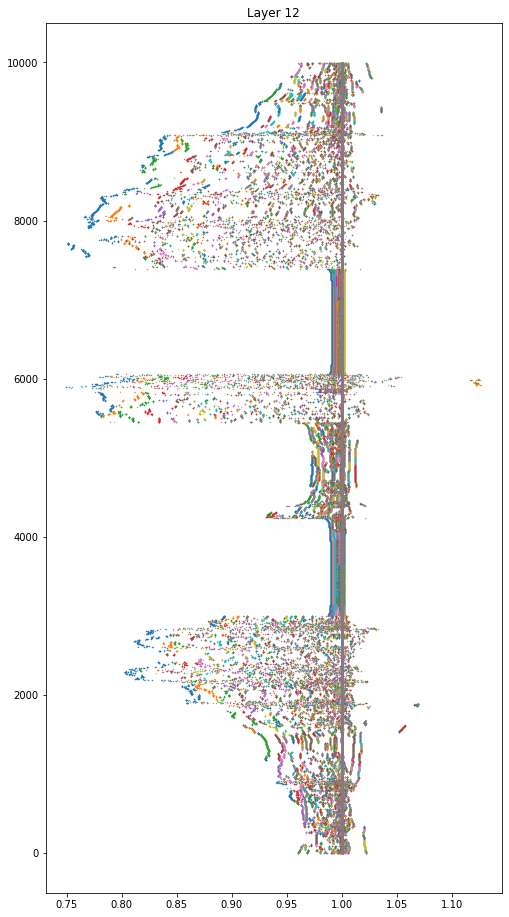

  0%|          | 0/50 [00:00<?, ?it/s]

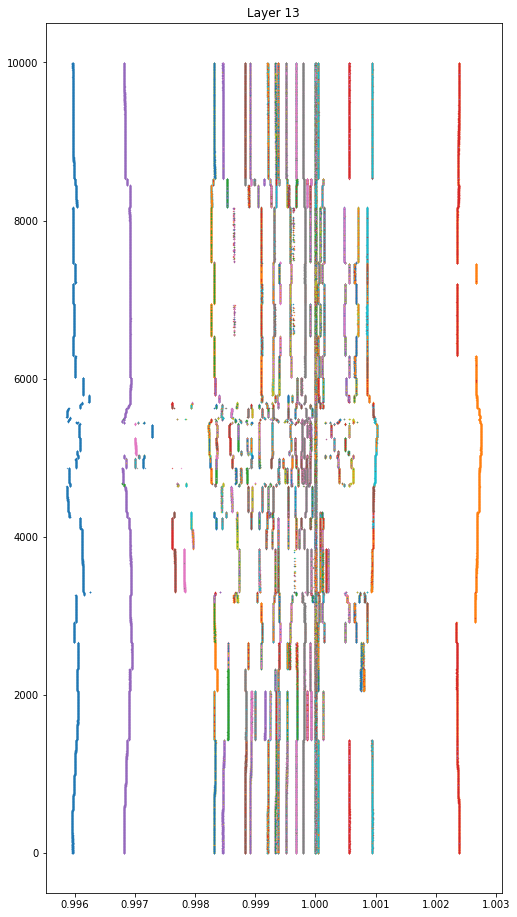

  0%|          | 0/50 [00:00<?, ?it/s]

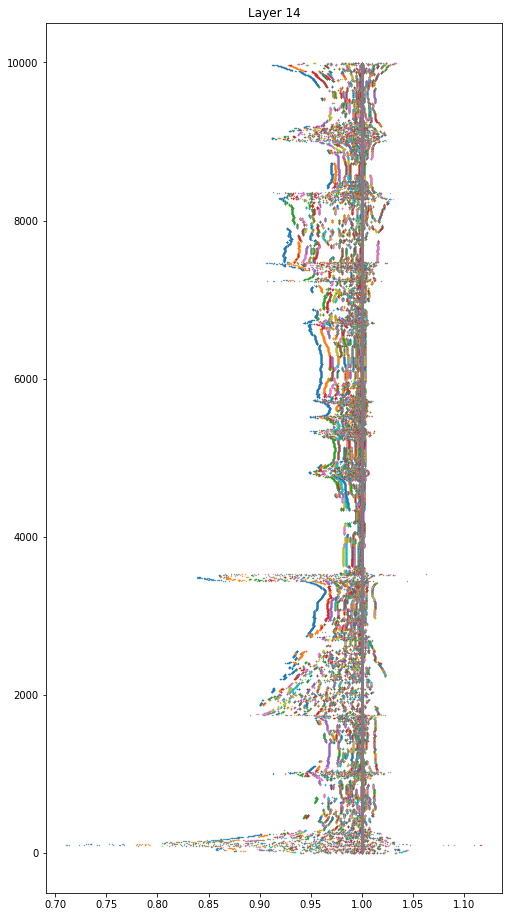

  0%|          | 0/50 [00:00<?, ?it/s]

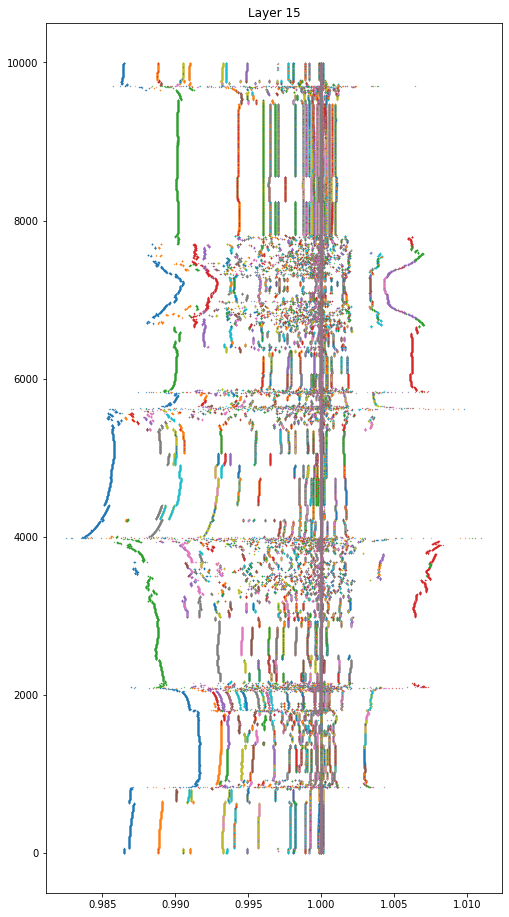

  0%|          | 0/50 [00:00<?, ?it/s]

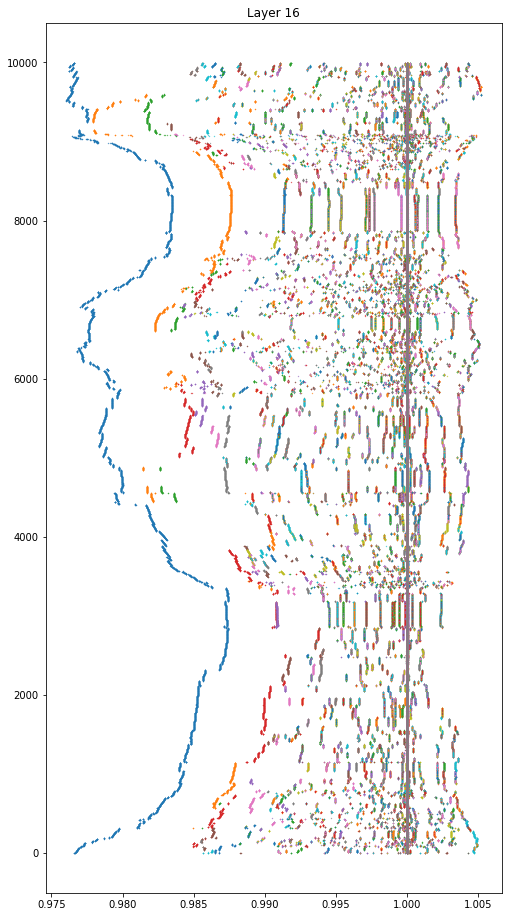

  0%|          | 0/50 [00:00<?, ?it/s]

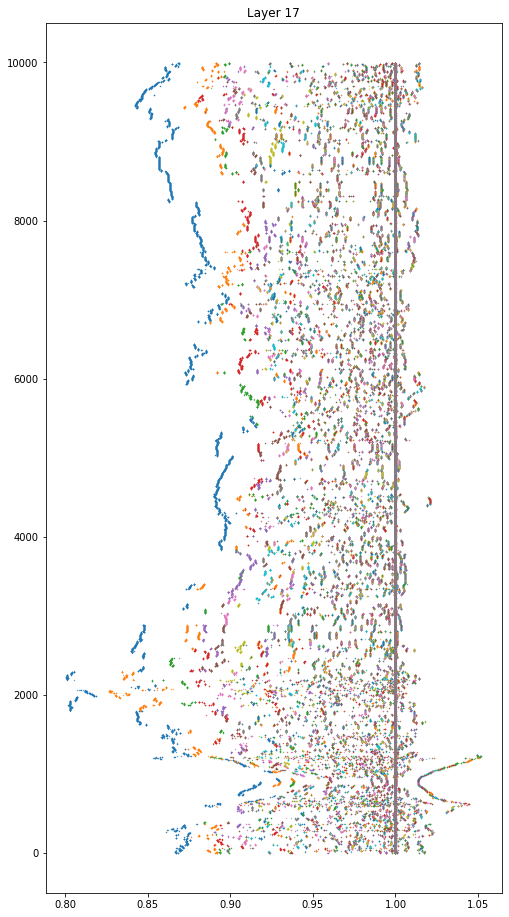

  0%|          | 0/50 [00:00<?, ?it/s]

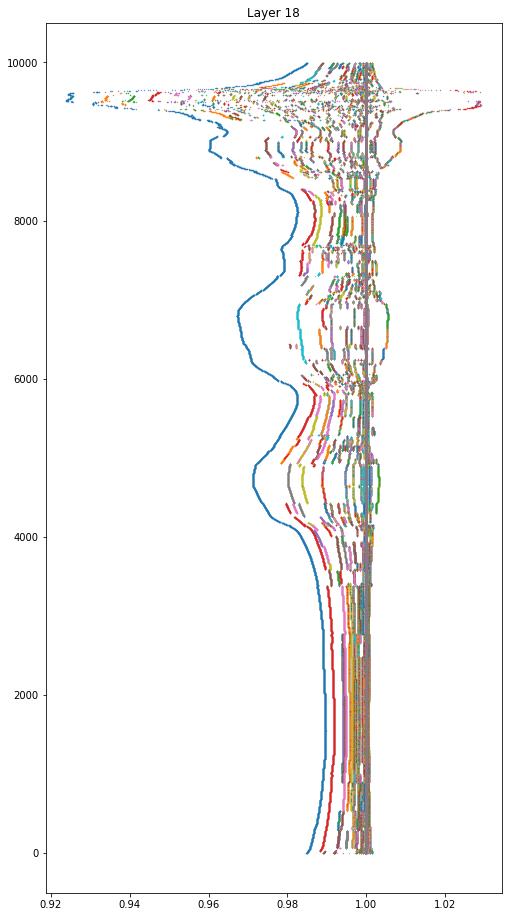

  0%|          | 0/50 [00:00<?, ?it/s]

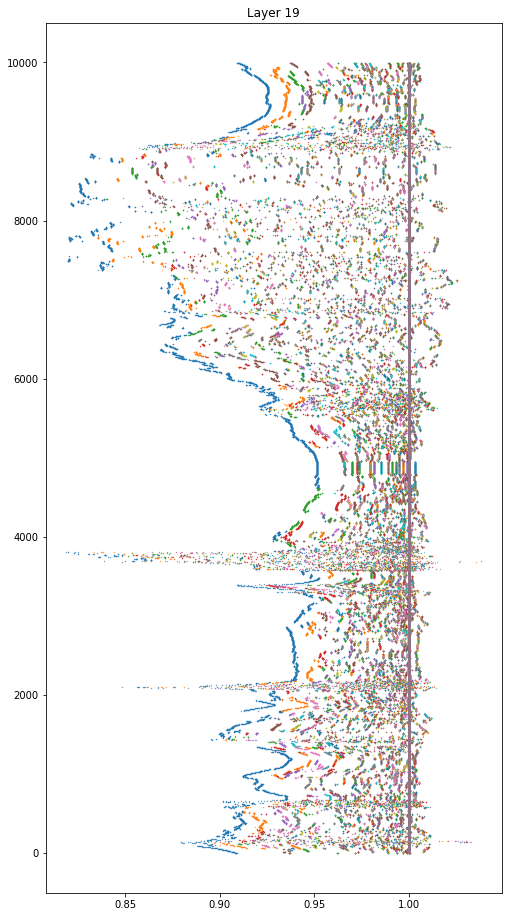

  0%|          | 0/50 [00:00<?, ?it/s]

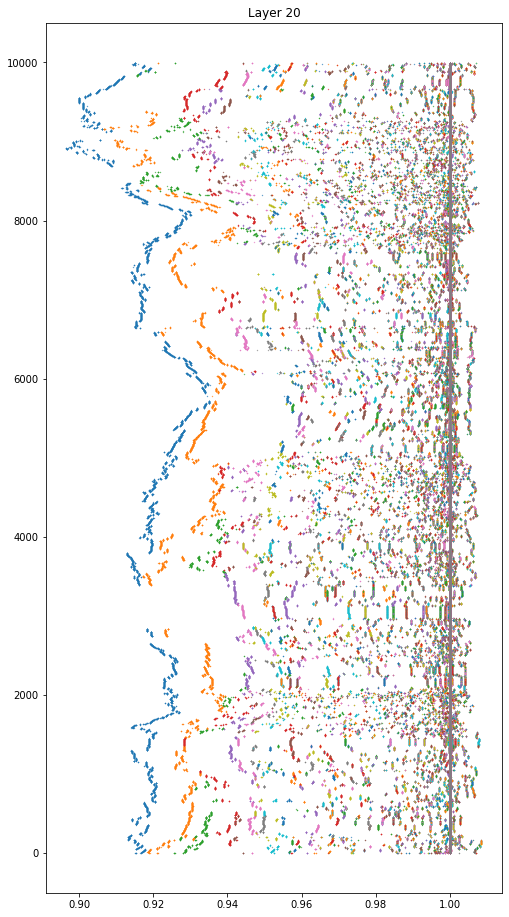

  0%|          | 0/50 [00:00<?, ?it/s]

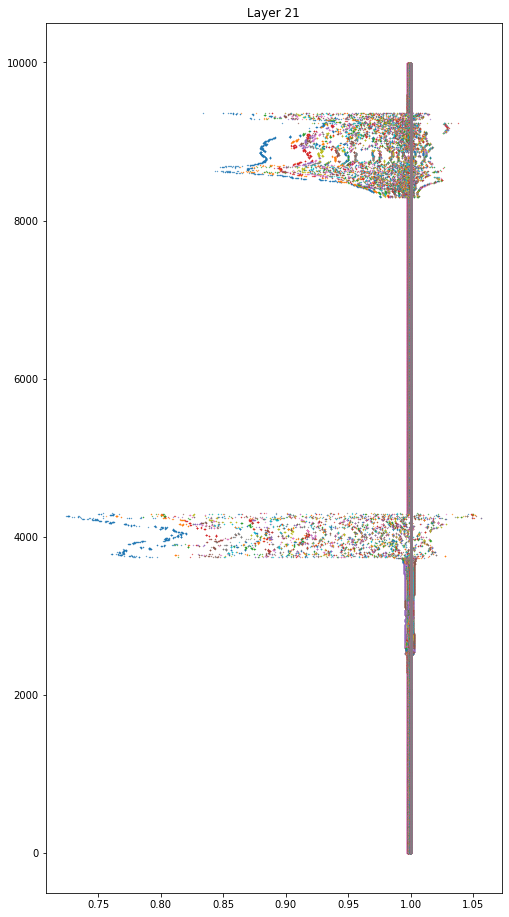

  0%|          | 0/50 [00:00<?, ?it/s]

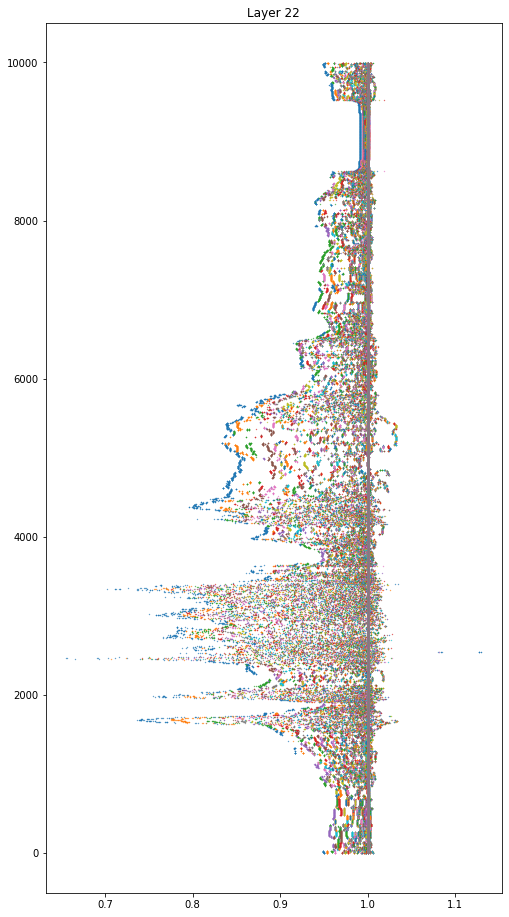

  0%|          | 0/50 [00:00<?, ?it/s]

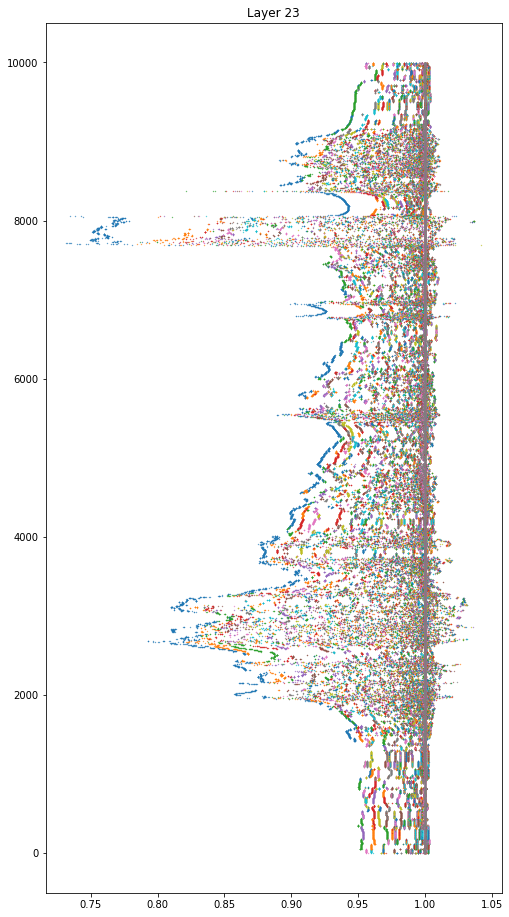

  0%|          | 0/50 [00:00<?, ?it/s]

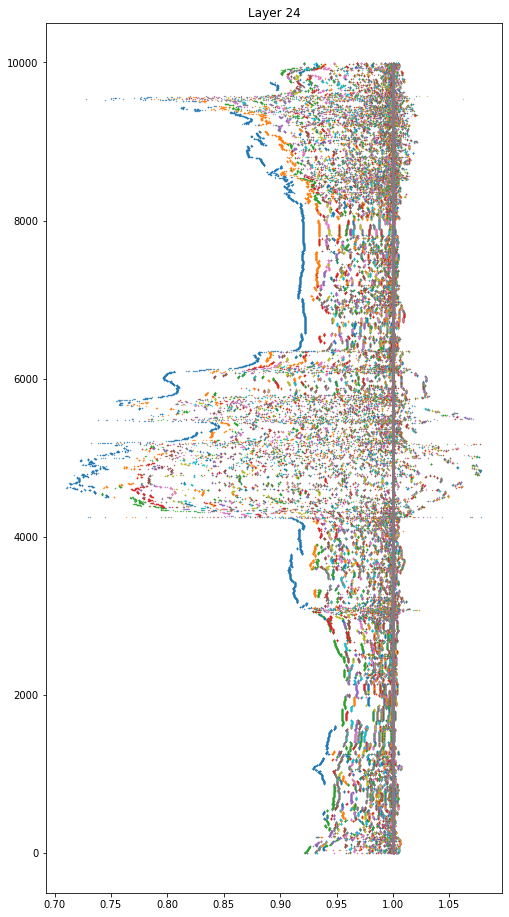

  0%|          | 0/50 [00:00<?, ?it/s]

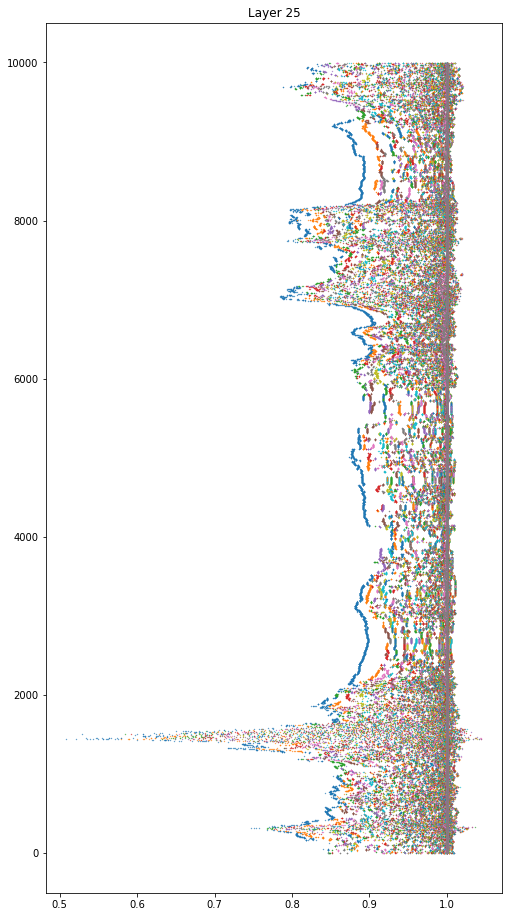

  0%|          | 0/50 [00:00<?, ?it/s]

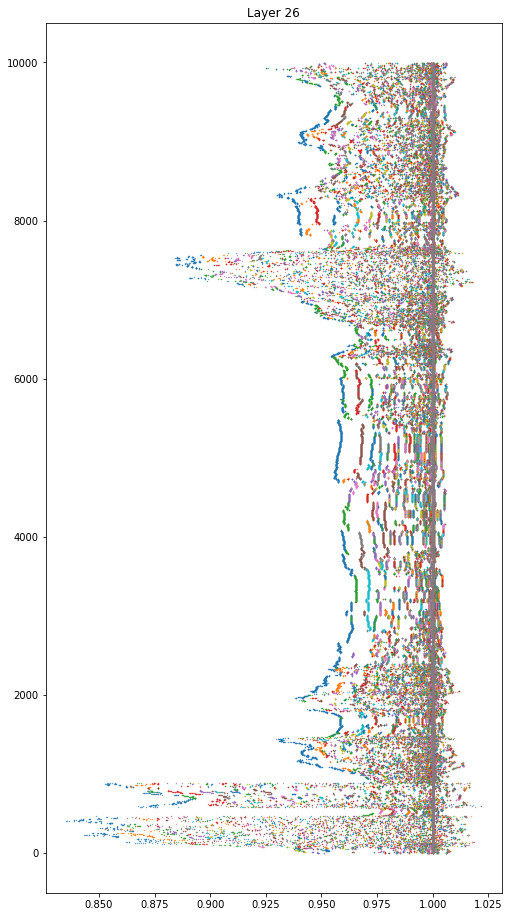

  0%|          | 0/50 [00:00<?, ?it/s]

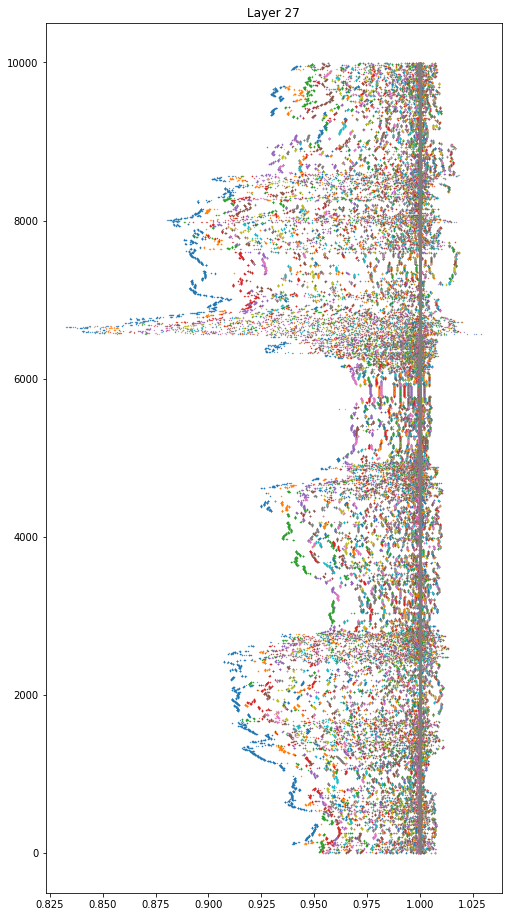

  0%|          | 0/50 [00:00<?, ?it/s]

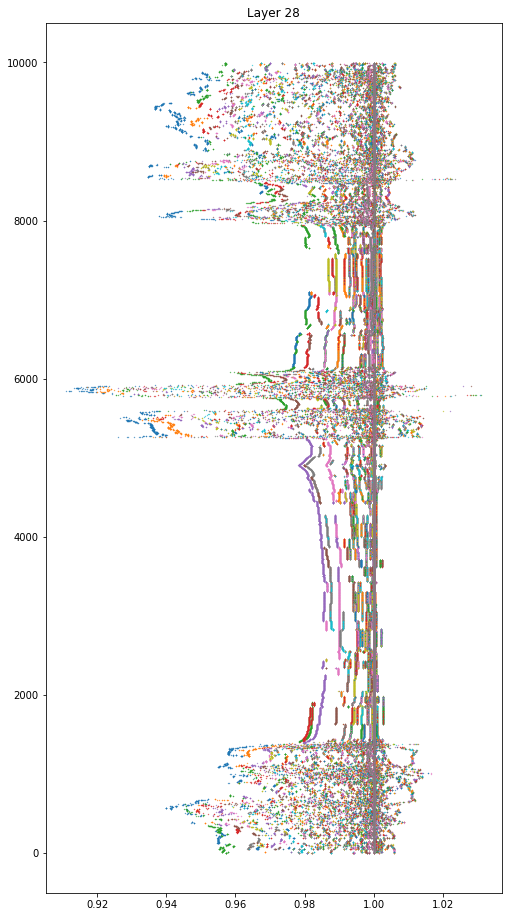

  0%|          | 0/50 [00:00<?, ?it/s]

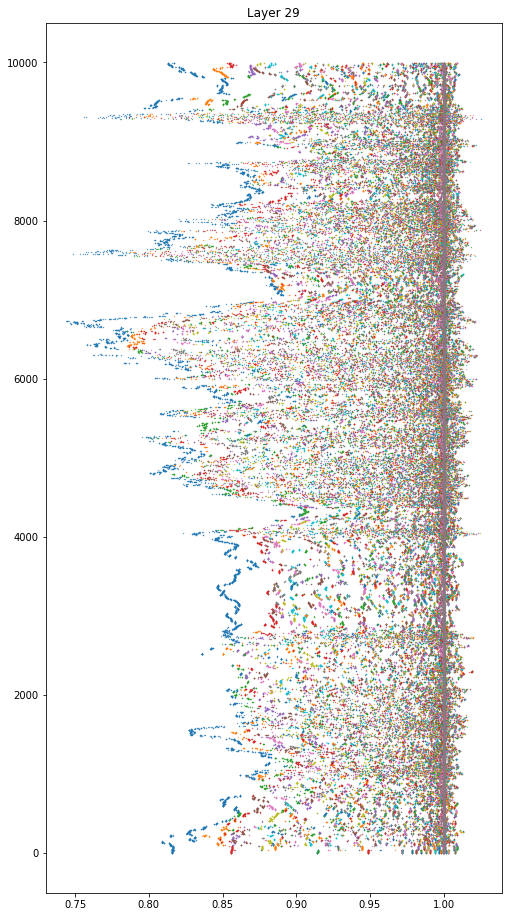

  0%|          | 0/50 [00:00<?, ?it/s]

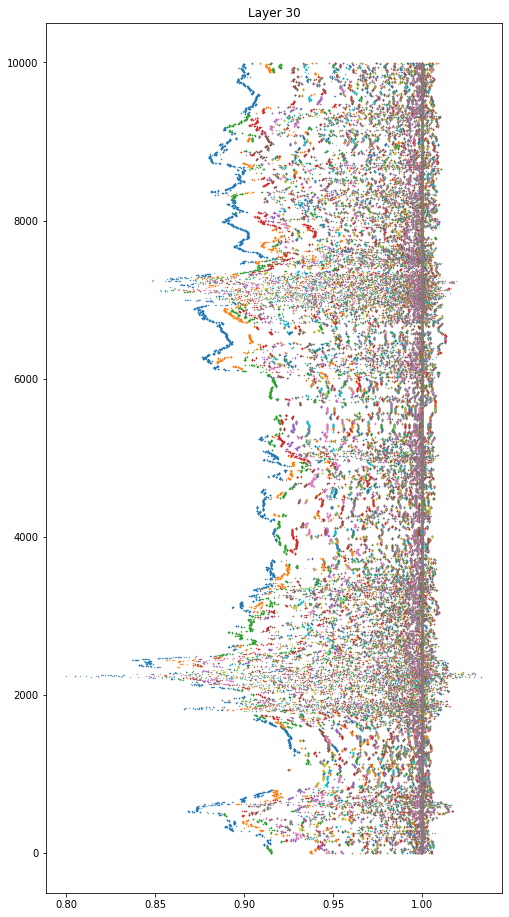

  0%|          | 0/50 [00:00<?, ?it/s]

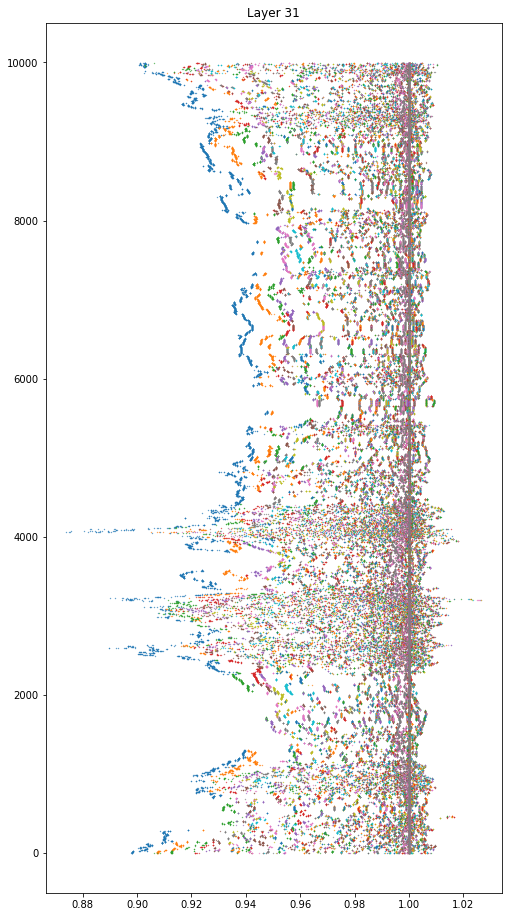

  0%|          | 0/50 [00:00<?, ?it/s]

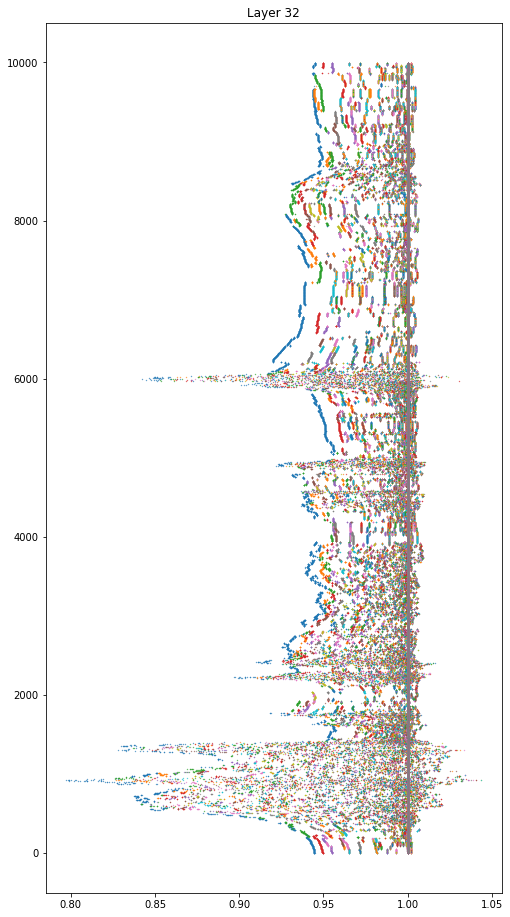

  0%|          | 0/50 [00:00<?, ?it/s]

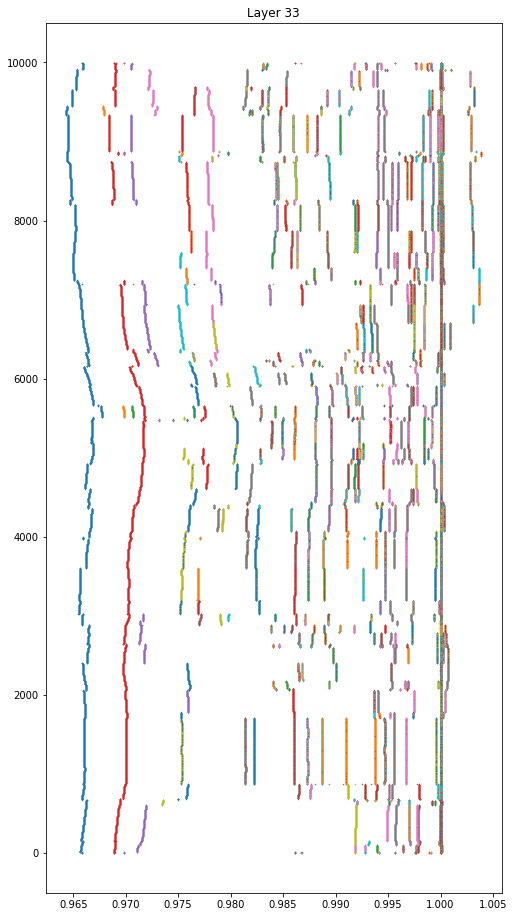

  0%|          | 0/50 [00:00<?, ?it/s]

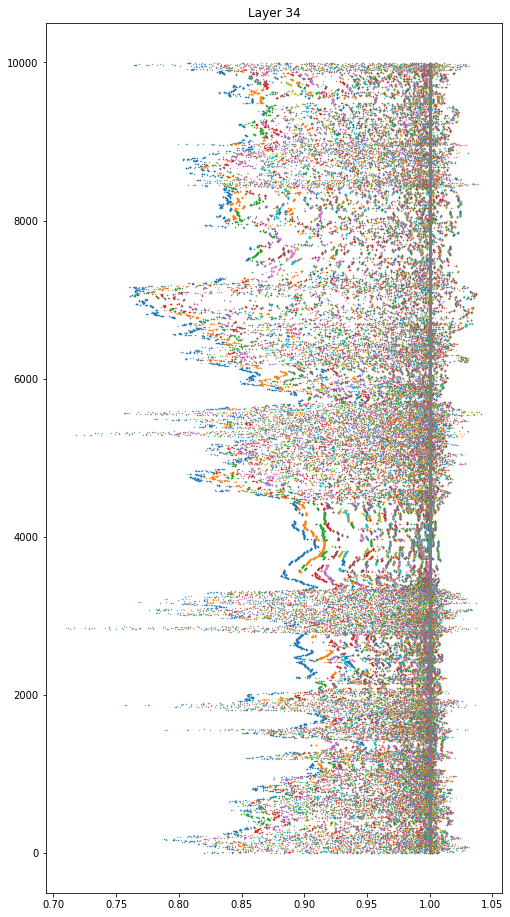

  0%|          | 0/50 [00:00<?, ?it/s]

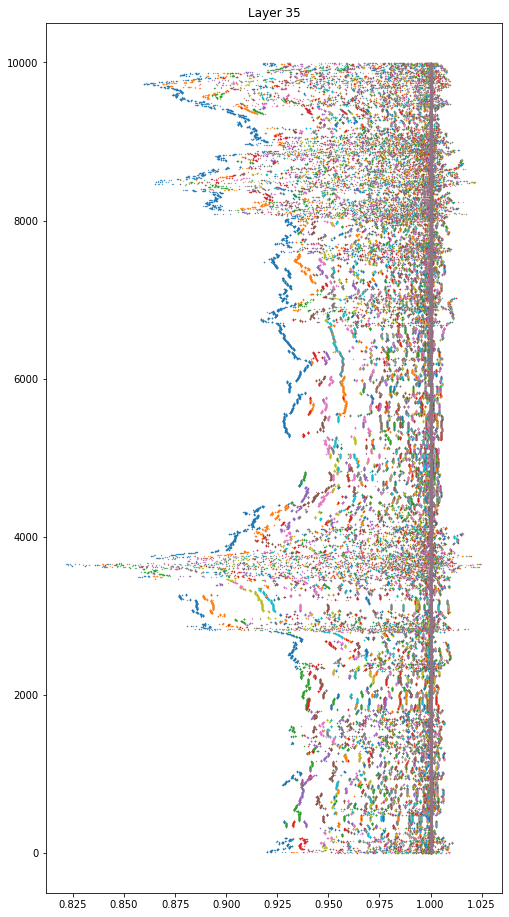

  0%|          | 0/50 [00:00<?, ?it/s]

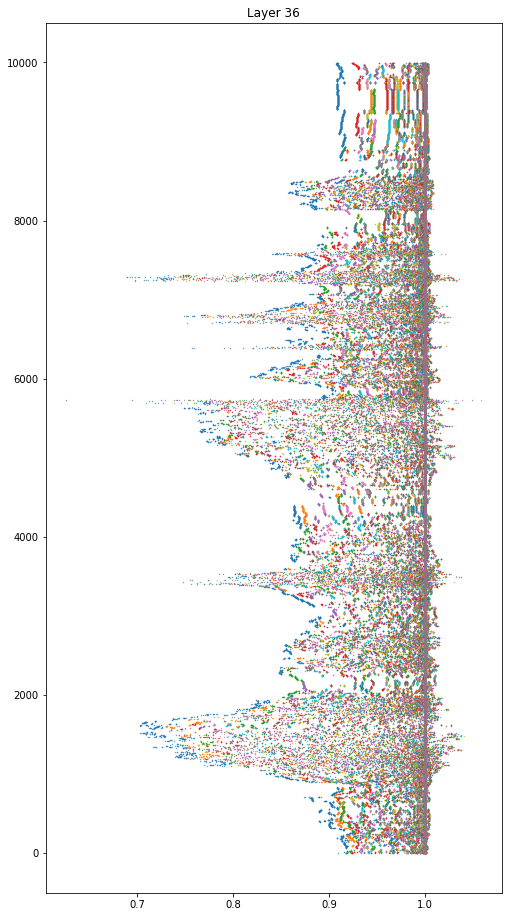

  0%|          | 0/50 [00:00<?, ?it/s]

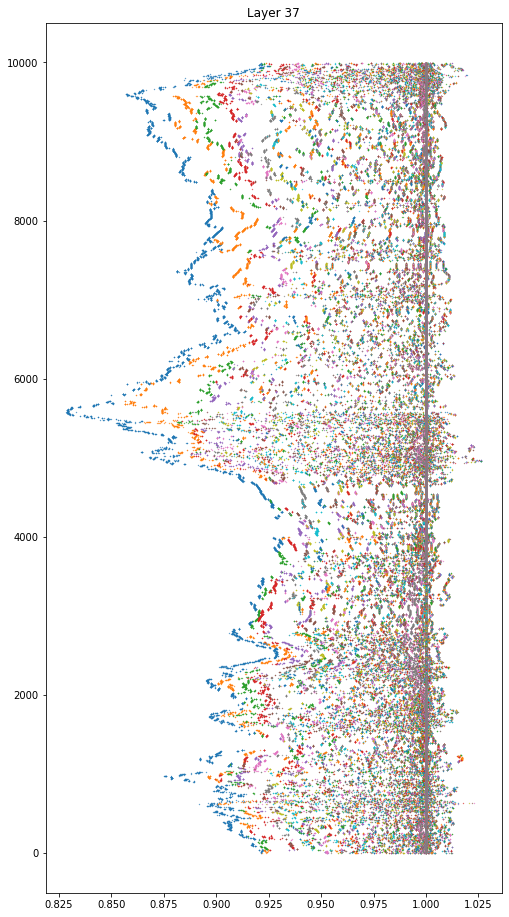

  0%|          | 0/50 [00:00<?, ?it/s]

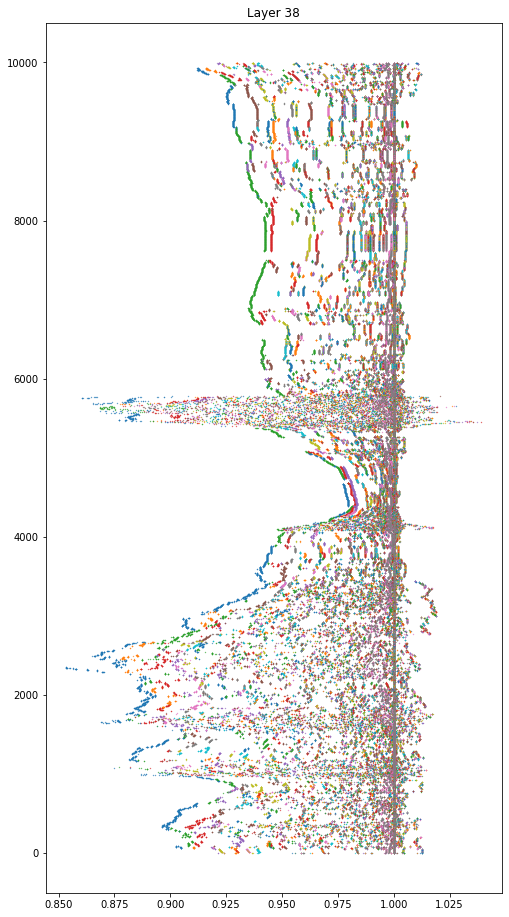

  0%|          | 0/50 [00:00<?, ?it/s]

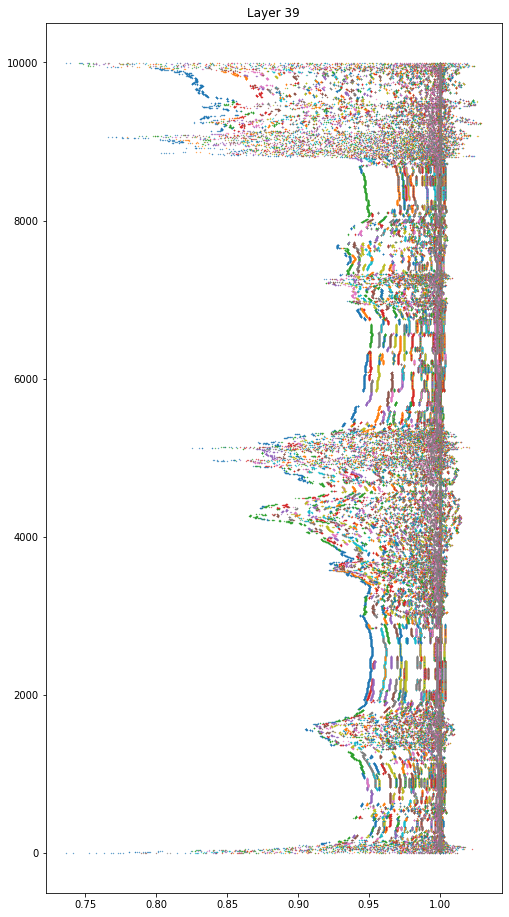

  0%|          | 0/50 [00:00<?, ?it/s]

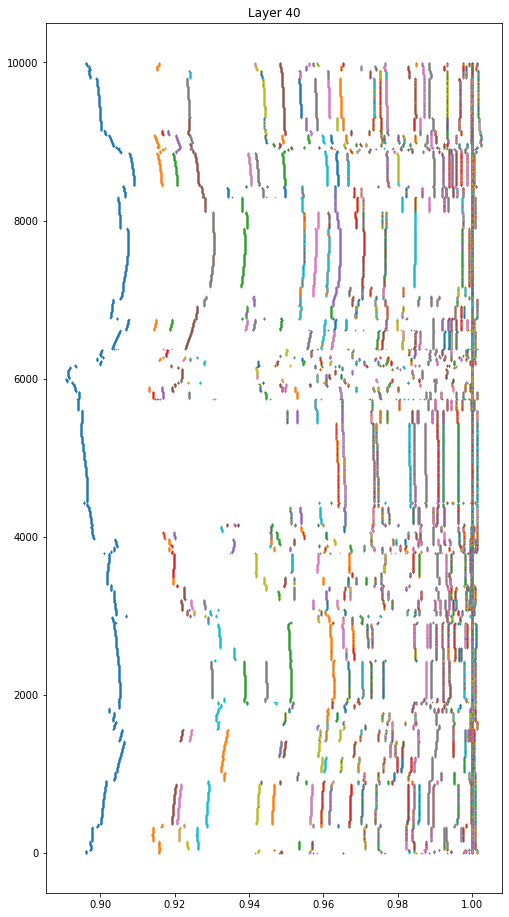

  0%|          | 0/50 [00:00<?, ?it/s]

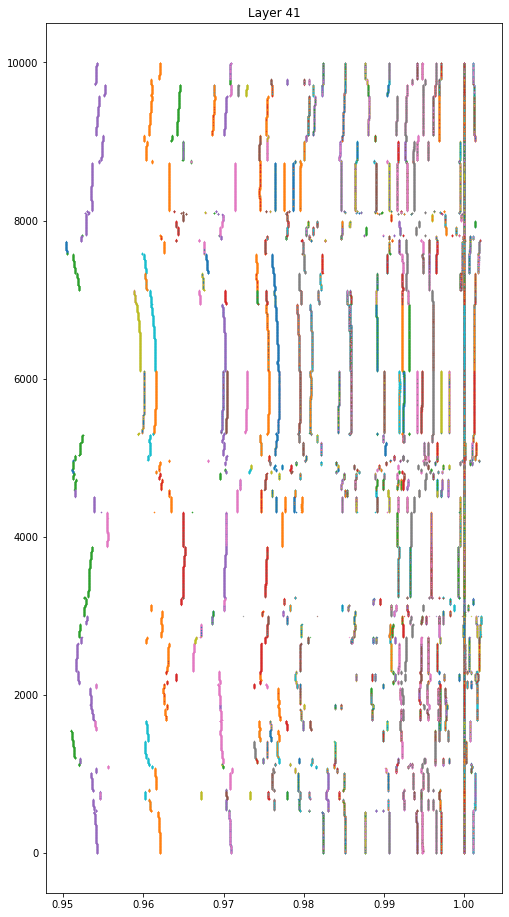

  0%|          | 0/50 [00:00<?, ?it/s]

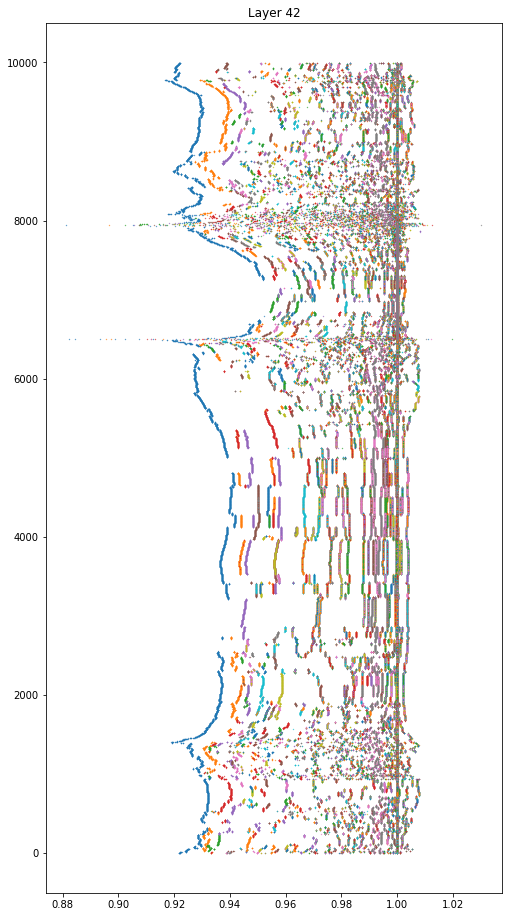

  0%|          | 0/50 [00:00<?, ?it/s]

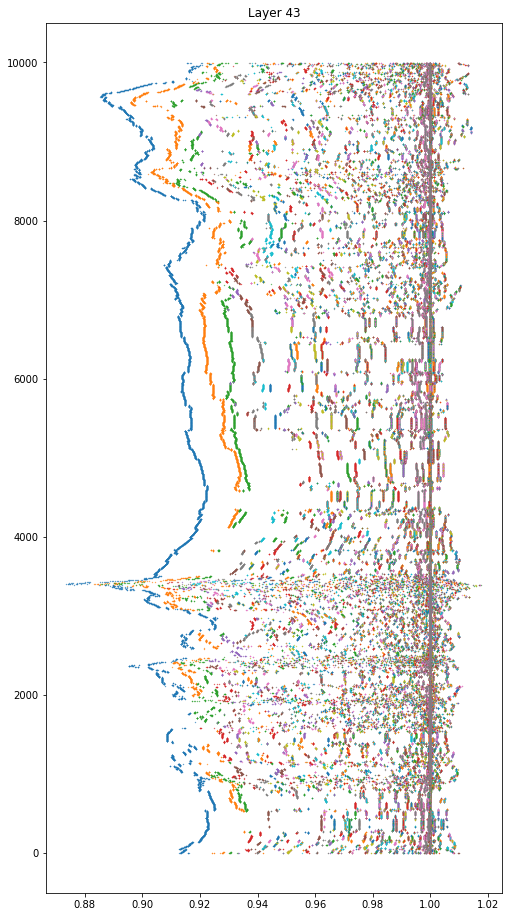

  0%|          | 0/50 [00:00<?, ?it/s]

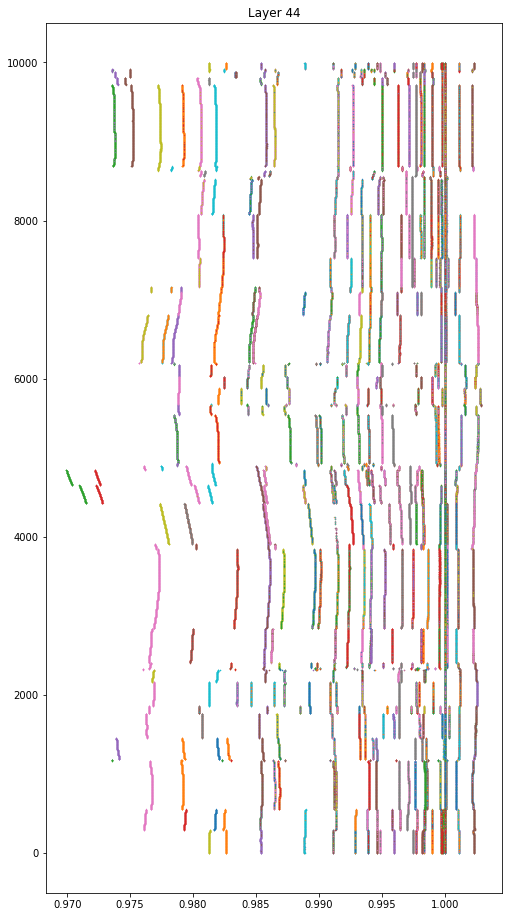

  0%|          | 0/50 [00:00<?, ?it/s]

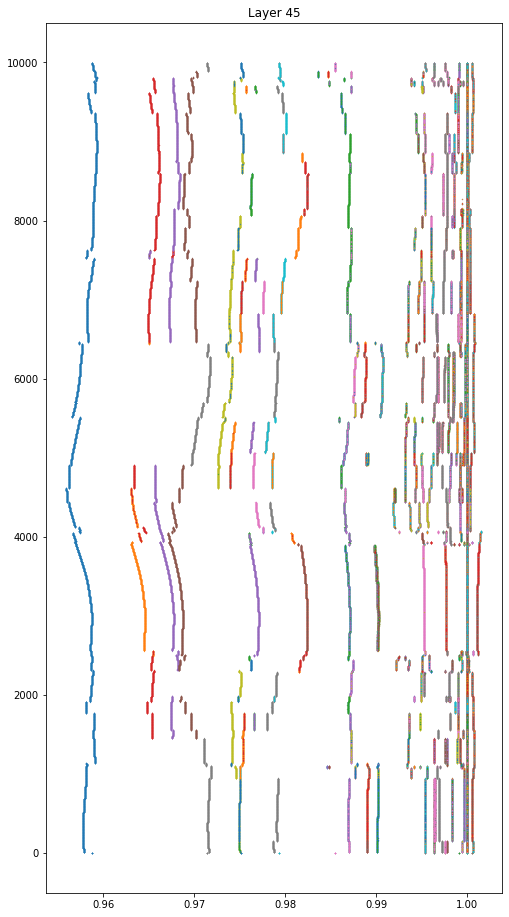

  0%|          | 0/50 [00:00<?, ?it/s]

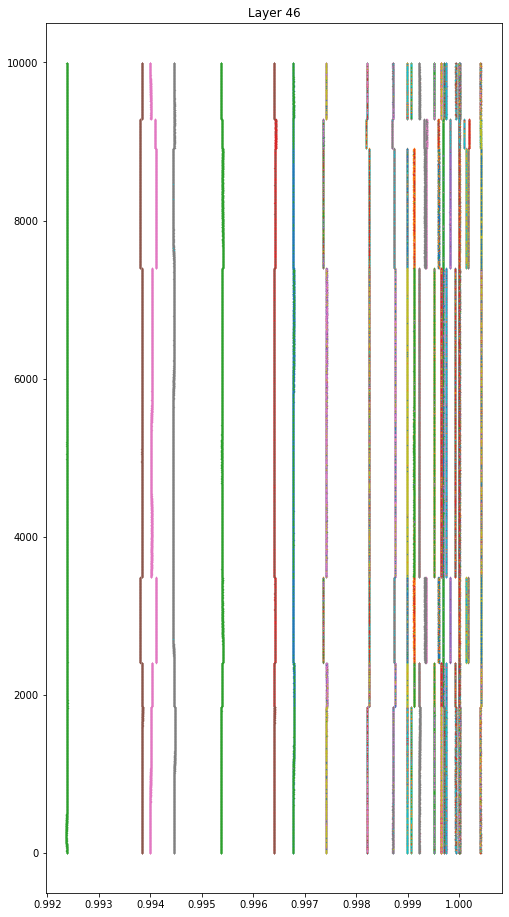

  0%|          | 0/50 [00:00<?, ?it/s]

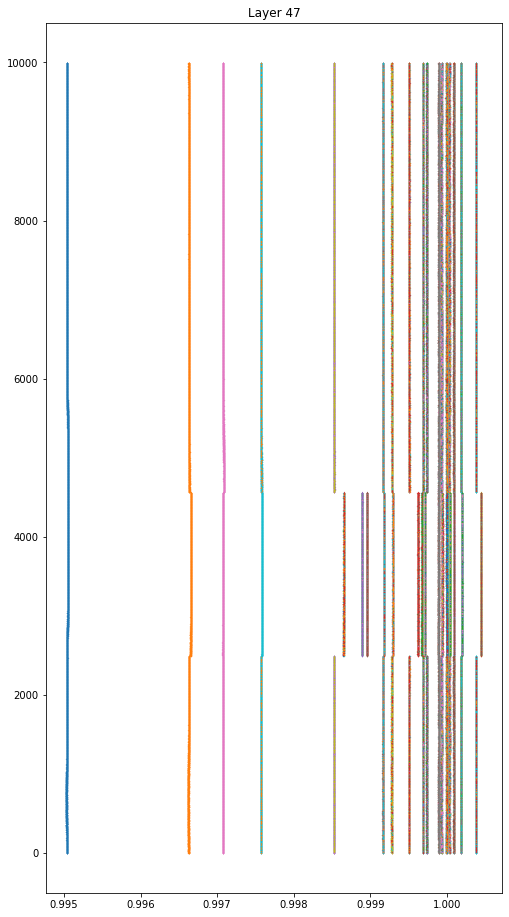

  0%|          | 0/50 [00:00<?, ?it/s]

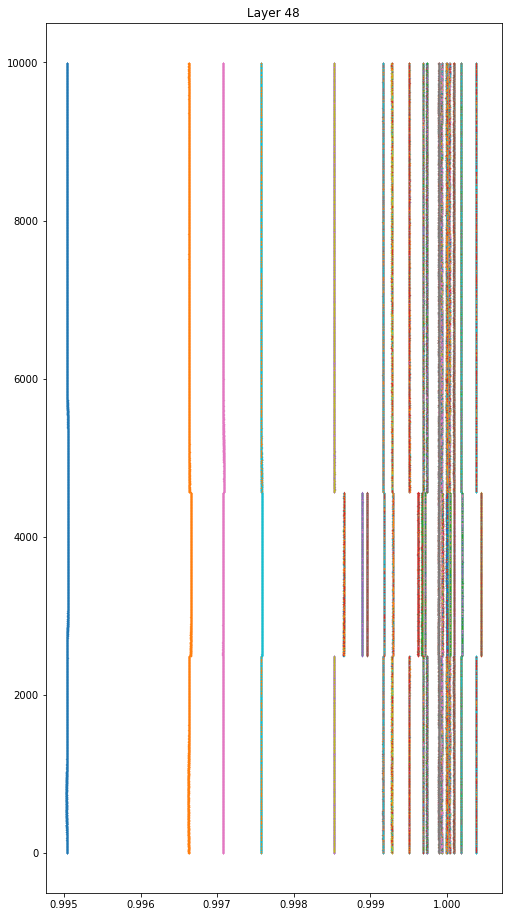

In [17]:
#interpolation along axis

scale = 30
interp_steps = 10000
_batch_size = 100
pre_iters = 256

batch_size = _batch_size * jax.device_count()

def loop(f, n):
    @jax.jit
    def step(i, x):
        return f(x)
    return partial(jax.lax.fori_loop, 1, n, step)

params_folder = '../alphafold/data'
model_name = 'model_2'

config, params = load_model(params_folder, model_name)

for layer_idx in range(48):
    layer = PairTransition(layer_idx+1, config, params)

    @jax.pmap
    @jax.vmap
    @jit
    def pre_fn(x):
        proj = layer.from_pca(x)
        return loop(layer.forward_residual, pre_iters)(proj)
    fn = jax.pmap(jax.vmap(jit(layer.jacobian)))
    cpu_fn = jax.vmap(jax.vmap(jit(jnp.linalg.eigvals, backend='cpu')))
    
    
    grid = get_grid_ns(
        n=interp_steps, 
        dims=1, 
        sizes=(-np.pi, np.pi)
    )
    grid = scale * jnp.stack([jnp.cos(grid), jnp.sin(grid)], axis=-1)
    points = points = grid.reshape(-1, grid.shape[-1])
    
    
    eigvals = jnp.zeros((points.shape[0], layer.init_shape[-1]), dtype=np.complex64)
    for i_start in tqdm.notebook.tqdm(range(0, interp_steps, batch_size)):
        i_end = min(interp_steps, i_start + batch_size)
        batch = points[i_start:i_end].reshape(jax.device_count(), _batch_size, *points.shape[1:])
        out = cpu_fn(fn(pre_fn(batch)))
        eigvals = jax.ops.index_update(
            eigvals, 
            jax.ops.index[i_start:i_end],
            out.reshape(batch_size, layer.init_shape[-1])
        )

    real_mask = jnp.isclose(eigvals.imag, 0)
    real_roots = jnp.full(eigvals.shape, np.nan)
    imag_roots = jnp.full(eigvals.shape, np.nan)
    real_roots = jax.ops.index_update(
        real_roots, 
        jax.ops.index[real_mask], 
        eigvals.real[real_mask]
    )
    imag_roots = jax.ops.index_update(
        imag_roots, 
        jax.ops.index[~real_mask], 
        eigvals.real[~real_mask]
    )
        
    start = 0
    step = 10000
    plt.gcf().set_size_inches(18, 16)
    plt.subplot(1, 2, 1)
    for i in range(real_roots.shape[-1]):
        plt.scatter(real_roots[start:start+step,i], np.arange(step), s=0.1)
    plt.title(F"Layer {layer_idx+1}")
    plt.show()

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

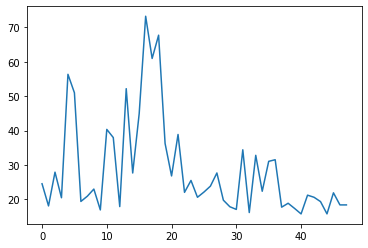

In [20]:
#interpolation along axis

scale = 30
interp_steps = 1000
_batch_size = 100
pre_iters = 256

batch_size = _batch_size * jax.device_count()

def loop(f, n):
    @jax.jit
    def step(i, x):
        return f(x)
    return partial(jax.lax.fori_loop, 1, n, step)

params_folder = '../alphafold/data'
model_name = 'model_2'

config, params = load_model(params_folder, model_name)

stable_counts = []
for layer_idx in range(48):
    layer = PairTransition(layer_idx+1, config, params)

    @jax.pmap
    @jax.vmap
    @jit
    def pre_fn(x):
        proj = layer.from_pca(x)
        return loop(layer.forward_residual, pre_iters)(proj)
    fn = jax.pmap(jax.vmap(jit(layer.jacobian)))
    cpu_fn = jax.vmap(jax.vmap(jit(jnp.linalg.eigvals, backend='cpu')))
    
    
    grid = get_grid_ns(
        n=interp_steps, 
        dims=1, 
        sizes=(-np.pi, np.pi)
    )
    grid = scale * jnp.stack([jnp.cos(grid), jnp.sin(grid)], axis=-1)
    points = points = grid.reshape(-1, grid.shape[-1])
    
    
    eigvals = jnp.zeros((points.shape[0], layer.init_shape[-1]), dtype=np.complex64)
    for i_start in tqdm.notebook.tqdm(range(0, interp_steps, batch_size)):
        i_end = min(interp_steps, i_start + batch_size)
        batch = points[i_start:i_end].reshape(jax.device_count(), _batch_size, *points.shape[1:])
        out = cpu_fn(fn(pre_fn(batch)))
        eigvals = jax.ops.index_update(
            eigvals, 
            jax.ops.index[i_start:i_end],
            out.reshape(batch_size, layer.init_shape[-1])
        )

    real_mask = jnp.isclose(eigvals.imag, 0)
    real_roots = jnp.full(eigvals.shape, np.nan)
    imag_roots = jnp.full(eigvals.shape, np.nan)
    real_roots = jax.ops.index_update(
        real_roots, 
        jax.ops.index[real_mask], 
        eigvals.real[real_mask]
    )
    imag_roots = jax.ops.index_update(
        imag_roots, 
        jax.ops.index[~real_mask], 
        eigvals.real[~real_mask]
    )
    stable_counts.append(jnp.logical_not(jnp.isnan(real_roots)).sum(axis=-1).mean())
        
    #start = 0
    #step = 10000
    #plt.gcf().set_size_inches(18, 16)
    #plt.subplot(1, 2, 1)
    #for i in range(real_roots.shape[-1]):
    #    plt.scatter(real_roots[start:start+step,i], np.arange(step), s=0.4)
    #plt.title(F"Layer {layer_idx+1}")
    #plt.show()
stable_counts = jnp.array(stable_counts)
plt.plot(stable_counts)
plt.show()

  0%|          | 0/5000 [00:00<?, ?it/s]

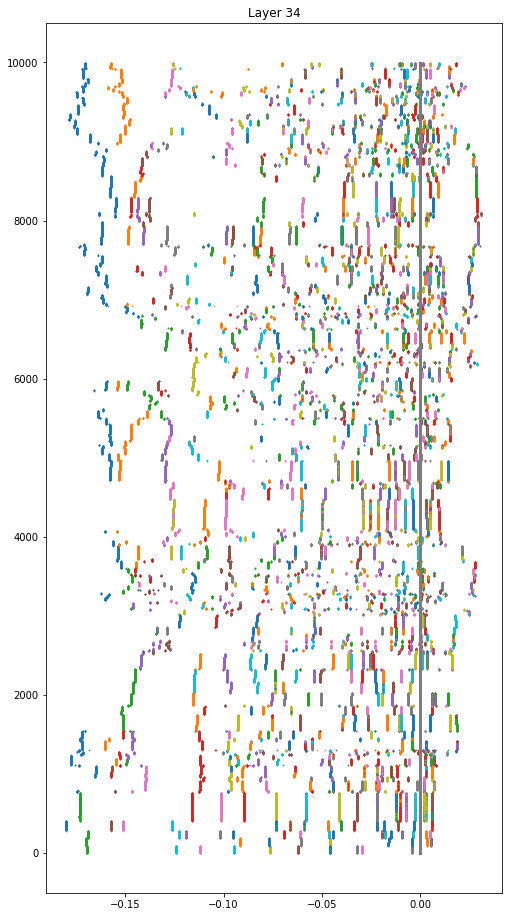

In [4]:
#interpolation along axis

layer_idx = 34
scale = 30
interp_steps = 1000000
_batch_size = 100
pre_iters = 256

batch_size = _batch_size * jax.device_count()

def loop(f, n):
    @jax.jit
    def step(i, x):
        return f(x)
    return partial(jax.lax.fori_loop, 1, n, step)

params_folder = '../alphafold/data'
model_name = 'model_2'

config, params = load_model(params_folder, model_name)

stable_counts = []
layer = PairTransition(layer_idx, config, params)

@jax.pmap
@jax.vmap
@jit
def pre_fn(x):
    proj = layer.from_pca(x)
    return loop(layer.forward_residual, pre_iters)(proj)
fn = jax.pmap(jax.vmap(jit(layer.jacobian)))
cpu_fn = jax.vmap(jax.vmap(jit(jnp.linalg.eigvals, backend='cpu')))


grid = get_grid_ns(
    n=interp_steps, 
    dims=1, 
    sizes=(-np.pi, np.pi)
)
grid = scale * jnp.stack([jnp.cos(grid), jnp.sin(grid)], axis=-1)
points = points = grid.reshape(-1, grid.shape[-1])


eigvals = jnp.zeros((points.shape[0], layer.init_shape[-1]), dtype=np.complex64)
for i_start in tqdm.notebook.tqdm(range(0, interp_steps, batch_size)):
    i_end = min(interp_steps, i_start + batch_size)
    batch = points[i_start:i_end].reshape(jax.device_count(), _batch_size, *points.shape[1:])
    out = cpu_fn(fn(pre_fn(batch)))
    eigvals = jax.ops.index_update(
        eigvals, 
        jax.ops.index[i_start:i_end],
        out.reshape(batch_size, layer.init_shape[-1])
    )

real_mask = jnp.isclose(eigvals.imag, 0)
real_roots = jnp.full(eigvals.shape, np.nan)
imag_roots = jnp.full(eigvals.shape, np.nan)
real_roots = jax.ops.index_update(
    real_roots, 
    jax.ops.index[real_mask], 
    eigvals.real[real_mask]
)
imag_roots = jax.ops.index_update(
    imag_roots, 
    jax.ops.index[~real_mask], 
    eigvals.real[~real_mask]
)

start = 0
step = 10000
plt.gcf().set_size_inches(18, 16)
plt.subplot(1, 2, 1)
for i in range(real_roots.shape[-1]):
    plt.scatter(real_roots[start:start+step,i], np.arange(step), s=0.4)
plt.title(F"Layer {layer_idx}")
plt.show()

In [ ]:
sorted_real_roots = jnp.sort(real_roots)
nan_counts = jnp.isnan(sorted_real_roots).sum(axis=-1)
pos_counts = jnp.logical_or(sorted_real_roots > 0, jnp.isclose(sorted_real_roots, 0)).sum(axis=-1)
sorted_real_roots[:,-nan_counts-pos_counts].shape

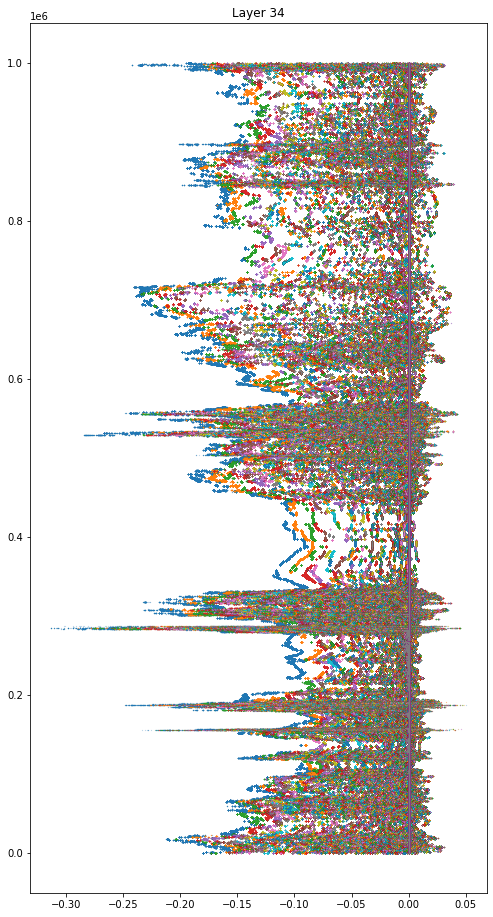

In [8]:
start = 0
step = 1000000
plt.gcf().set_size_inches(18, 16)
plt.subplot(1, 2, 1)
for i in range(real_roots.shape[-1]):
    plt.scatter(real_roots[start:start+step,i], np.arange(step), s=0.01)
plt.title(F"Layer {layer_idx}")
plt.show()

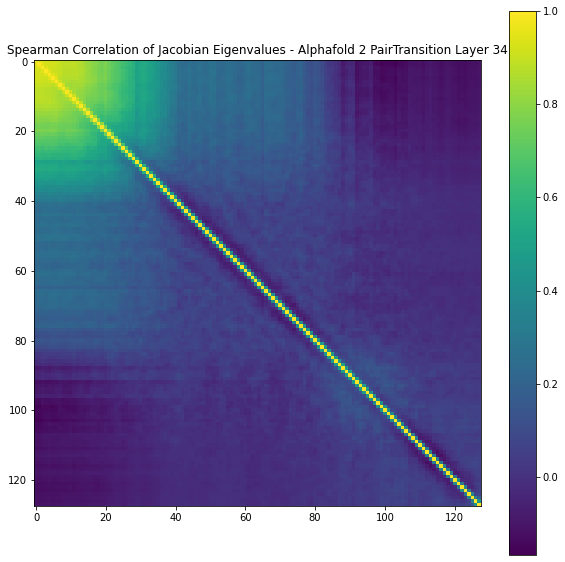

In [54]:
corr_mat = scipy.stats.spearmanr(eigvals.real)[0]

plt.gcf().set_size_inches(10, 10)
plt.imshow(corr_mat)
plt.colorbar()
plt.title(F"Spearman Correlation of Jacobian Eigenvalues - Alphafold 2 PairTransition Layer 34")
#plt.axis('off')
plt.show()

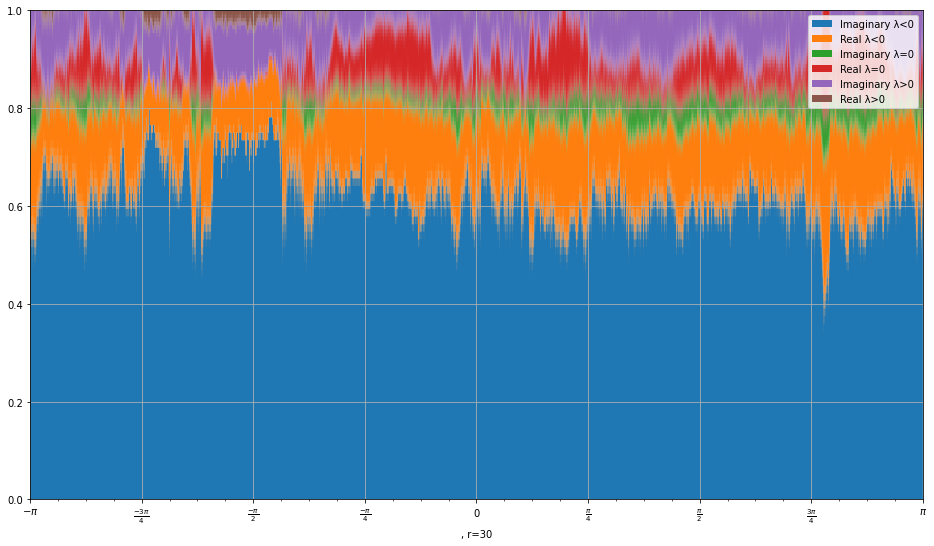

In [51]:
class Multiple:
    def __init__(self, denominator=2, number=np.pi, latex='\pi'):
        self.denominator = denominator
        self.number = number
        self.latex = latex

    def locator(self):
        return plt.MultipleLocator(self.number / self.denominator)

    def formatter(self):
        return plt.FuncFormatter(multiple_formatter(self.denominator, self.number, self.latex))

    
real_zeros = np.isclose(real_roots, 0).sum(axis=-1) / real_roots.shape[-1]
real_pos = (real_roots > 0).sum(axis=-1) / real_roots.shape[-1]
real_neg = (real_roots < 0).sum(axis=-1) / real_roots.shape[-1]
imag_zeros = np.isclose(imag_roots, 0).sum(axis=-1) / imag_roots.shape[-1]
imag_pos = (imag_roots > 0).sum(axis=-1) / imag_roots.shape[-1]
imag_neg = (imag_roots < 0).sum(axis=-1) / imag_roots.shape[-1]

plt.gcf().set_size_inches(16, 9)
x = np.linspace(-np.pi, np.pi, real_zeros.shape[0])
bottom = np.zeros_like(real_zeros)
top = np.ones_like(real_zeros)

plt.fill_between(
    x,
    bottom, 
    imag_neg, 
    label=r"Imaginary λ<0"
)
plt.fill_between(
    x,
    imag_neg, 
    imag_neg + real_neg, 
    label=r"Real λ<0"
)
plt.fill_between(
    x,
    imag_neg + real_neg, 
    imag_neg + real_neg + imag_zeros, 
    label=r"Imaginary λ=0"
)
plt.fill_between(
    x,
    imag_neg + real_neg + imag_zeros, 
    imag_neg + real_neg + imag_zeros + real_zeros, 
    label=r"Real λ=0"
)
plt.fill_between(
    x,
    imag_neg + real_neg + imag_zeros + real_zeros, 
    imag_neg + real_neg + imag_zeros + real_zeros + imag_pos, 
    label=r"Imaginary λ>0"
)
plt.fill_between(
    x,
    imag_neg + real_neg + imag_zeros + real_zeros + imag_pos, 
    imag_neg + real_neg + imag_zeros + real_zeros + imag_pos + real_pos, 
    label=r"Real λ>0"
)
plt.fill_between(
    x,
    imag_neg + real_neg + imag_zeros + real_zeros + imag_pos + real_pos, 
    top
)

ax = plt.gca()
major = Multiple(4, np.pi, r'\pi')
minor = Multiple(16, np.pi, r'\pi')
ax.xaxis.set_major_locator(major.locator())
ax.xaxis.set_minor_locator(minor.locator())
ax.xaxis.set_major_formatter(major.formatter())
plt.xlim(-np.pi, np.pi)
plt.ylim(0, 1)
plt.grid('on')
plt.xlabel(F", r={scale}")
plt.legend()
plt.show()

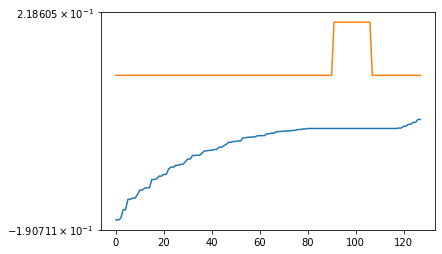

In [230]:
count = (eigvals_sorted >= 0).sum()
num = eigvals_sorted[-count:].sum()
denom = np.abs(eigvals_sorted[:-count-1])
dim = count + (num / denom)
#plt.plot(dim)
plt.plot(eigvals_sorted)
plt.plot(np.isclose(eigvals_sorted, 0) * 0.1 + 0.1)
plt.yscale('symlog')

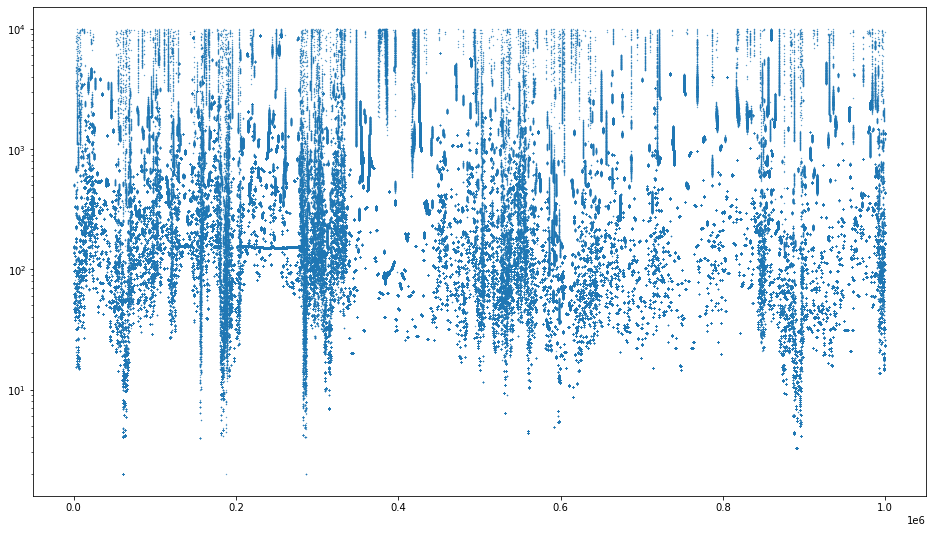

In [258]:
select_cutoff = 1e4

@jax.jit
def dimension(eigvals):
    eigvals = eigvals.sort()[::-1]
    count = jnp.arange(1, eigvals.shape[-1])
    num = jnp.cumsum(eigvals[:-1])
    denom = eigvals[1:]
    dims = count + (num / denom)
    
    select_idx = np.argmax(dims > select_cutoff) - 1
    return dims[select_idx]

dim = jax.vmap(dimension)(eigvals.real)

plt.gcf().set_size_inches(16, 9)
plt.scatter(np.arange(len(dim)), dim, s=0.1)
plt.yscale('log')
plt.show()

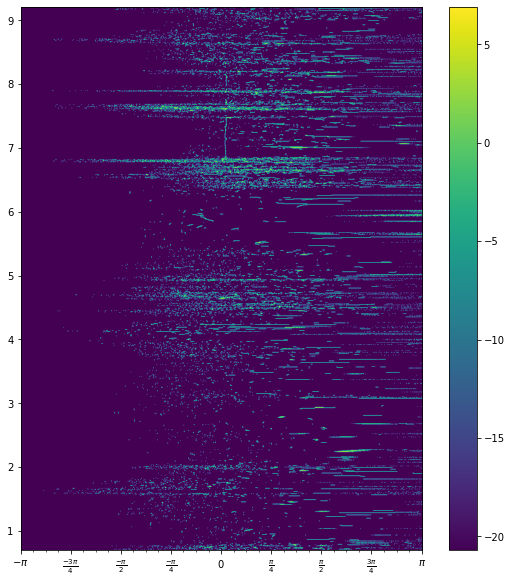

In [282]:
def hist(dim, bins=1000, step_size=1000):
    bins = np.histogram_bin_edges(dim, bins=bins)
    @jax.jit
    def _hist(dim):
        return jnp.histogram(dim, bins=bins)[0]
    dim = dim.reshape(-1, step_size)
    hist = jax.vmap(_hist)(dim)
    return hist, bins

histvals, bins = hist(jnp.log(dim))

plt.gcf().set_size_inches(10, 10)
plt.imshow(jnp.log(histvals+1e-9), extent=[-np.pi, np.pi, bins.min(), bins.max()])
ax = plt.gca()
major = Multiple(4, np.pi, r'\pi')
minor = Multiple(16, np.pi, r'\pi')
ax.xaxis.set_major_locator(major.locator())
ax.xaxis.set_minor_locator(minor.locator())
ax.xaxis.set_major_formatter(major.formatter())
plt.colorbar()
plt.show()

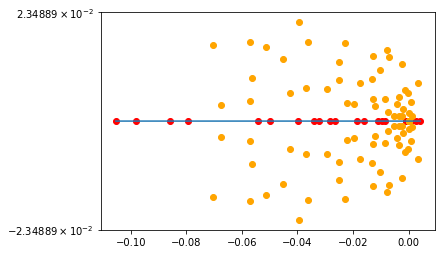

In [192]:
pad_mul = 1
samples = 10000

i = 410000
coefs = P.polyfromroots(eigvals[i])
assert np.allclose(coefs.imag, 0)
coefs = coefs.real
x = np.linspace(
    pad_mul * eigvals[i].real.min(), 
    pad_mul * eigvals[i].real.max(), 
    samples
)
y = P.polyval(x, coefs)
plt.plot(x, y)

real_idxs = np.isclose(eigvals[i].imag, 0)
plt.scatter(eigvals.real[i,real_idxs], np.zeros(real_idxs.sum()), c='red')
imag_y = eigvals.imag[i,~real_idxs]
plt.scatter(eigvals.real[i,~real_idxs], imag_y, c='orange')

plt.yscale('symlog')
plt.show()

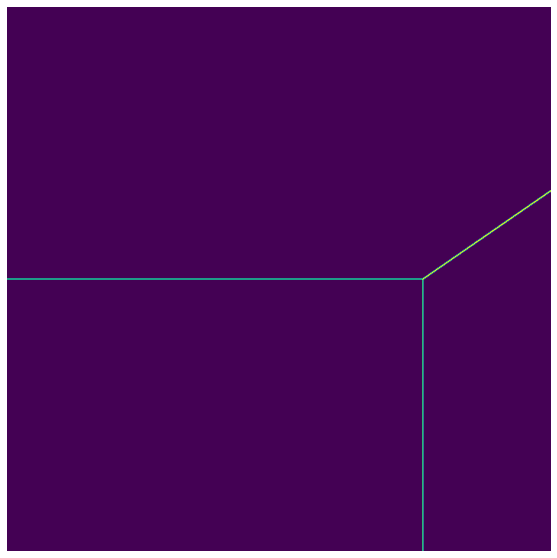

In [193]:
samples = 1000

x = np.linspace(
    pad_mul * eigvals[i].real.min(), 
    pad_mul * eigvals[i].real.max(), 
    samples
)
y = P.polyval(x, coefs)
#y = np.linspace(y.min(), y.max(), samples)
y = np.linspace(-10, 10, samples)
trop_coefs = np.arange(len(coefs))
trop_vals = trop_coefs * x[:,np.newaxis] + coefs
max_terms = np.argmax(trop_vals, axis=-1)
max_vals = np.max(trop_vals, axis=-1)
grid_terms, fill_vals = np.meshgrid(max_terms, np.full_like(y, len(coefs)))
grid_vals = np.stack(np.meshgrid(max_vals, -y), axis=-1)
fill_idxs = grid_vals.argmax(axis=-1)==1
grid_terms[fill_idxs] = fill_vals[fill_idxs]

#solution1 = scipy.signal.savgol_filter(grid_terms, 5, polyorder=2, deriv=2, axis=0)
#solution2 = scipy.signal.savgol_filter(grid_terms, 5, polyorder=2, deriv=2, axis=1)
#solution = solution1 + solution2
conv_filter = np.array([
    [-1, -1, -1],
    [-1,  8, -1],
    [-1, -1, -1]
])
solution = scipy.signal.convolve2d(grid_terms, conv_filter)
solution = np.abs(solution)[2:-2,2:-2] > 0

plt.gcf().set_size_inches(10, 10)
plt.imshow(solution)
plt.axis('off')
plt.show()

In [134]:
np.meshgrid(terms, y)

((1000, 1000), (10000,))

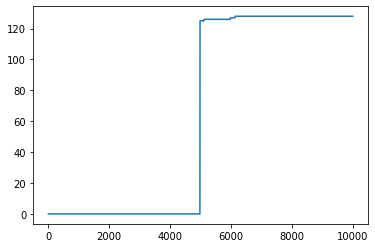

In [135]:
plt.plot(terms)
plt.show()

# Iterating the eigenspectrum

In [180]:
iterate_steps = 1000
layer_idx = 34
integrate = False

def loop(f, n):
    @jax.jit
    def step(i, x):
        return f(x)
    return partial(jax.lax.fori_loop, 1, n, step)

def loop_collect(forward_fn, out_fn, n, unroll=1):
    @jax.jit
    def step(x, _):
        y = forward_fn(x)
        return y, out_fn(y)
    return partial(jax.lax.scan, step, xs=None, length=n, unroll=unroll)

#runge-katta
def integrate(f, step_size=1):
    @jax.jit
    def _integrate(x):
        k1 = step_size * f(x)
        k2 = step_size * f(x + k1/2.)
        k3 = step_size * f(x + k2/2.)
        k4 = step_size * f(x + k3)
        
        return x + 1./6 * (k1 + 2 * k2 + 2 * k3 + k4)
    return _integrate

params_folder = '../alphafold/data'
model_name = 'model_2'

config, params = load_model(params_folder, model_name)
layer = PairTransition(layer_idx, config, params)

if integrate:
    forward_fn = integrate(layer.forward_residual, step_size=0.004)
else:
    forward_fn = layer.forward_residual
@jit
def pre_fn(x):
    proj = layer.from_pca(x)
    return loop(layer.forward_residual, 256)(proj)
jac_fn = jit(layer.jacobian)

#cpu_fn = jit(jnp.linalg.eigvals, backend='cpu')
def cpu_fn(x, n):
    ys = []
    def step(x):
        y, x = np.linalg.eig(x)
        return x, y
    for i in tqdm.notebook.tqdm(range(n)):
        x, y = step(x)
        ys.append(y)
    return np.stack(ys, axis=-1)



In [181]:
num_frames = 1
plot_skip_steps = 2
blur = True
blur_kernel_width = 20
hist_bins = 2160
eps = 1e-6
hue_truncate_scale = 1.1
log_exp_factor = 6

from matplotlib.colors import hsv_to_rgb
from scipy.signal import convolve2d
import scipy.stats as st
import scipy
from pathlib import Path

def gkern(kernlen=21, nsig=3):
    x = np.linspace(-nsig, nsig, kernlen+1)
    kern1d = np.diff(st.norm.cdf(x))
    kern2d = np.outer(kern1d, kern1d)
    return kern2d/kern2d.sum()

point = jax.random.normal(layer.rng_key, (layer.init_shape[-1],))
point = pre_fn(point)

for frame_idx in tqdm.notebook.tqdm(range(num_frames)):
    eigval_iters = cpu_fn(jac_fn(point), iterate_steps)
    point = forward_fn(point)
    
    real_axis = eigval_iters.real[:,plot_skip_steps:]
    imag_axis = eigval_iters.imag[:,plot_skip_steps:]
    hist_borders = np.array([
        [real_axis.min(), real_axis.max()],
        [imag_axis.min(), imag_axis.max()]
    ])

    hue_weights = []
    val_weights = None
    for eig_idx in range(eigval_iters.shape[0]):
        hist, _, _ = np.histogram2d(
            real_axis[eig_idx],
            imag_axis[eig_idx],
            bins=hist_bins,
            range=hist_borders,
            density=True
        )
        hue_weights.append(hist / hist.sum())
        if val_weights is None:
            val_weights = hist
        else:
            val_weights += hist

    hue_weights = np.stack(hue_weights, axis=-1)
    hue_weights /= hue_weights.sum(axis=-1, keepdims=True) + eps
    axis_hues = np.linspace(0, 1, eigval_iters.shape[0], endpoint=False)
    h = (hue_weights * axis_hues).sum(axis=-1)
    s = np.ones_like(h)
    v = val_weights
    if blur:
        h = convolve2d(h, gkern(blur_kernel_width), mode='same')
        v = convolve2d(v, gkern(blur_kernel_width), mode='same')
    h -= h.min()
    h /= h.max() * hue_truncate_scale
    v = v / v.max()

    #v = np.log((v + 1) * np.exp(log_exp_factor))
    #v -= v.min()
    #v /= v.max()

    rgb = hsv_to_rgb(np.stack((h,s,v), axis=-1))
    plt.imshow(
        (rgb * 255).astype(np.uint8), 
        extent=hist_borders.reshape(-1)
    )

    plt.title(F"Alphafold 2 - PairFeedforward Layer {layer_idx} - Eigenvalue Complex Plane")
    plt.xlabel("λ Real Component")
    plt.ylabel("λ Complex Components")
    plt.gcf().set_size_inches(30, 30)
    plt.gcf().tight_layout()

    out_path = Path(F"out/pairff-{layer_idx}_eigcomplexplane{'_blur' if blur else ''}/")
    out_path.mkdir(parents=True, exist_ok=True)
    out_path = Path(out_path, F"{frame_idx}.png")
    plt.savefig(out_path, pad_inches=0.0, facecolor='white', transparent=False)
    plt.clf()
    plt.cla()
    plt.close()

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

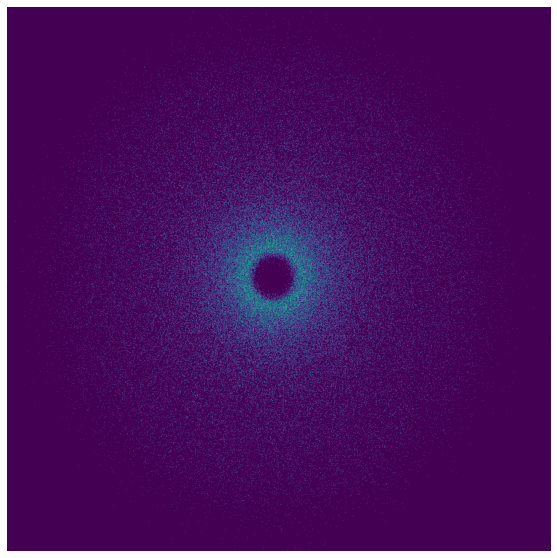

In [139]:
plt.gcf().set_size_inches(10, 10)
plt.imshow(hue_weights.sum(axis=-1) > 0)
plt.axis('off')
plt.show()

In [146]:
mat = hue_weights
frac_full = [np.logical_not(np.isclose(mat, 0)).sum(axis=0).sum(axis=0) / (mat.shape[0] * mat.shape[1])]
while mat.shape[0] % 2 == 0:
    mat = mat.reshape(
        mat.shape[0]//2, 2, 
        mat.shape[1]//2, 2,
        mat.shape[2]
    ).sum(axis=1).sum(axis=2)
    frac_full.append(np.logical_not(np.isclose(mat, 0)).sum(axis=0).sum(axis=0) / (mat.shape[0] * mat.shape[1]))
frac_full = np.log(np.stack(frac_full))

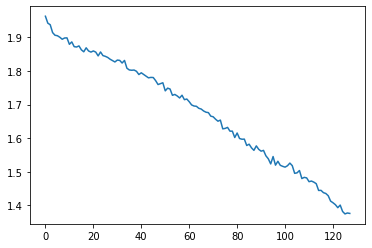

In [128]:
dims = []
xs = np.log([1/(hue_weights.shape[0]/np.power(2, i)) for i in range(frac_full.shape[0])])
for eig_idx in range(hue_weights.shape[-1]):
    ys = np.log(frac_full[:,eig_idx])
    dim = (ys[1:] - ys[:-1]) / (xs[1:] - xs[:-1])
    dims.append(dim.mean())
plt.plot(dims)
plt.show()

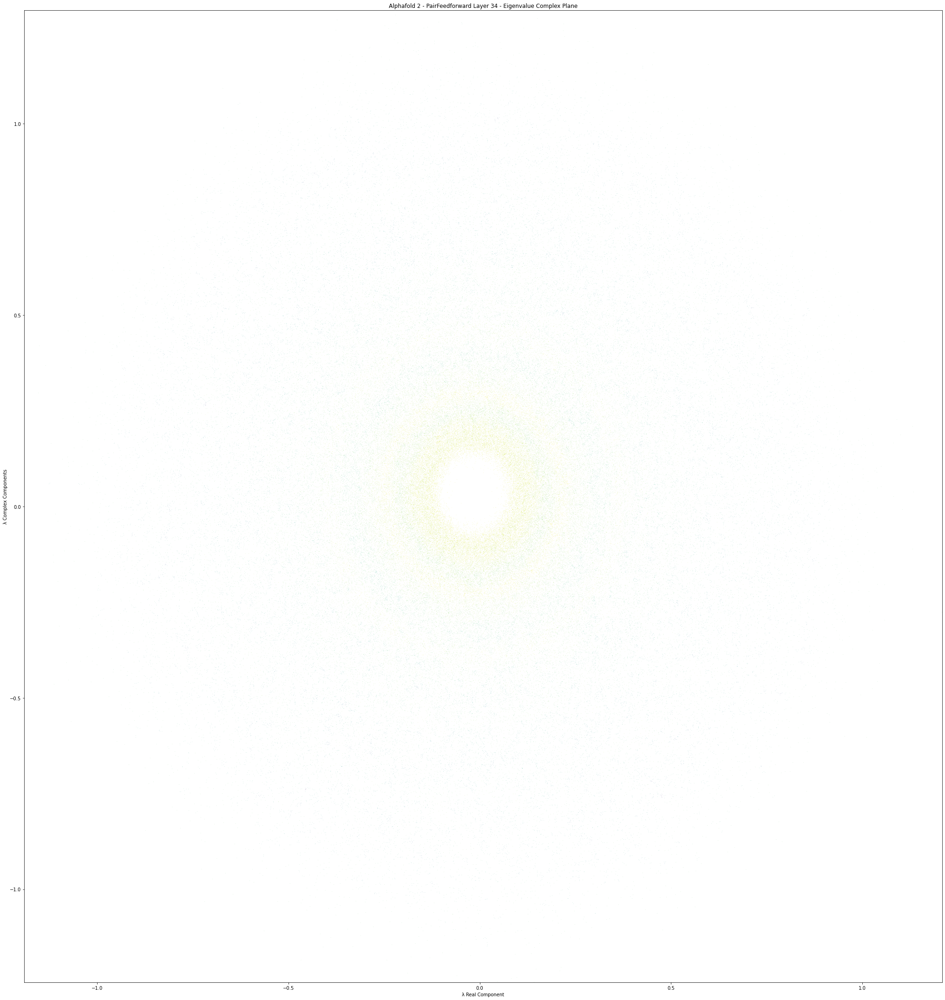

In [185]:
first_eigvals = eigval_iters[:,0]
real_idxs = np.isclose(first_eigvals.imag, 0)

real_axis = eigval_iters.real[:,plot_skip_steps:]
imag_axis = eigval_iters.imag[:,plot_skip_steps:]
hist_borders = np.array([
    [real_axis.min(), real_axis.max()],
    [imag_axis.min(), imag_axis.max()]
])

hue_weights = []
val_weights = None
for eig_idx in range(eigval_iters.shape[0]):
    hist, _, _ = np.histogram2d(
        real_axis[eig_idx],
        imag_axis[eig_idx],
        bins=hist_bins,
        range=hist_borders,
        density=True
    )
    hue_weights.append(hist / hist.sum())
    if val_weights is None:
        val_weights = hist
    else:
        val_weights += hist

hue_weights = np.stack(hue_weights, axis=-1)
hue_weights /= hue_weights.sum(axis=-1, keepdims=True) + eps
#axis_hues = np.linspace(0, 1, eigval_iters.shape[0], endpoint=False)
h = (hue_weights * first_eigvals.real).sum(axis=-1)
#h = (hue_weights * axis_hues).sum(axis=-1)
#s = np.ones_like(h)
#v = val_weights
if blur:
    h = convolve2d(h, gkern(blur_kernel_width), mode='same')
    #v = convolve2d(v, gkern(blur_kernel_width), mode='same')
h -= h.min()
h /= h.max() * (hue_truncate_scale)

#v = v / v.max()
#h[real_idxs] = 0

#v = np.log((v + 1) * np.exp(log_exp_factor))
#v -= v.min()
#v /= v.max()

#_v = np.ones_like(h)
#_v[np.isclose(v, 0, atol=1e-4)] = 0
#v = _v

val_weights -= val_weights.min()
val_weights /= val_weights.max()
#rgb = hsv_to_rgb(np.stack((h,s,v), axis=-1))
plt.imshow(
    #(rgb * 255).astype(np.uint8), 
    h,
    extent=hist_borders.reshape(-1),
    alpha=val_weights
)

plt.title(F"Alphafold 2 - PairFeedforward Layer {layer_idx} - Eigenvalue Complex Plane")
plt.xlabel("λ Real Component")
plt.ylabel("λ Complex Components")
plt.gcf().set_size_inches(30, 30)
plt.gcf().tight_layout()

In [186]:
phase = np.angle(eigval_iters[:,plot_skip_steps:])


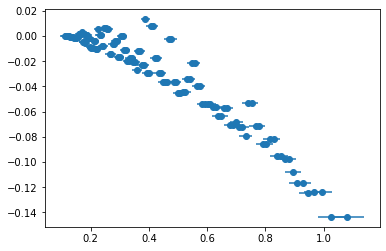

In [187]:
magnitude = np.absolute(eigval_iters[:,plot_skip_steps:])

plt.scatter(magnitude.mean(axis=-1), eigval_iters[:,0].real)
plt.hlines(
    eigval_iters[:,0].real, 
    magnitude.mean(axis=-1) - magnitude.std(axis=-1), 
    magnitude.mean(axis=-1) + magnitude.std(axis=-1)
)
plt.show()

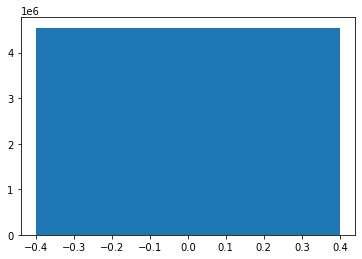

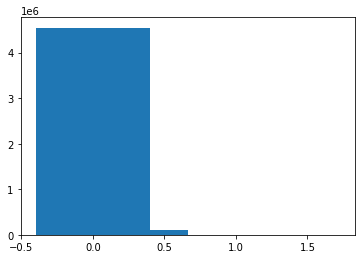

In [225]:
bins, xrange = np.histogram(val_weights.reshape(-1), bins=1000, range=(0, val_weights.max()))
x = np.linspace(xrange[0], xrange[1], 1000)
plt.bar(x, bins)
plt.show()
_x = np.linspace(0, magnitude.max(), 1000)
plt.bar(_x, bins)
plt.yscale('log')
plt.show()

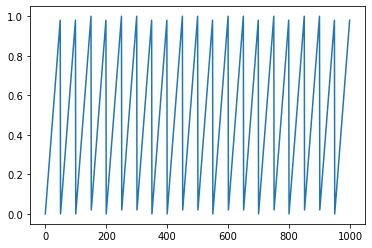

In [312]:
plt.plot(((np.linspace(0, 1, 1000, endpoint=False) % (1/20)) * 20))
plt.show()

In [504]:
def polyfit_ndeg(x, y, ndeg=500, n_interp=1000):
    _y = np.zeros((n_interp, n_interp))
    interp_prob = (np.linspace(0, 1, n_interp) % (1/ndeg)) * ndeg
    last_peak, last_poly = 0, None
    for deg in range(ndeg + 1):
        coefs, residuals, rank, singular_values, rcond = np.polyfit(x, y, deg, full=True)
        _x = np.linspace(x.min(), x.max(), n_interp)
        poly = np.polyval(coefs, _x)
        
        if deg == 0:
            last_poly = poly
            continue
            
        next_peak = last_peak
        while interp_prob[min(n_interp-1, next_peak + 1)] > interp_prob[next_peak]:
            next_peak += 1
        prob = interp_prob[last_peak:next_peak + 1].reshape(-1, 1)
        _y[last_peak:next_peak + 1] = prob * poly + (1 - prob) * last_poly
        last_poly = poly
        last_peak = next_peak + 1
        
    _y = _y[::-1]
    plt.imshow(np.sign(_y) * np.log(np.abs(_y)), extent=[0, np.sqrt(2), 0, ndeg], aspect='auto')
    plt.gcf().set_size_inches(10, 10)
    #plt.yscale('symlog')
    plt.show()
    
def polyfit_ndeg(x, y, ndeg=100, n_interp=1000):
    _y = np.zeros((ndeg + 1, n_interp))
    for deg in range(ndeg + 1):
        coefs, residuals, rank, singular_values, rcond = np.polyfit(x, y, deg, full=True)
        _x = np.linspace(x.min(), x.max(), n_interp)
        _y[ndeg - deg] = np.polyval(coefs, _x)
        
    plt.imshow(
        np.sign(_y) * np.log(np.abs(_y)), 
        extent=[0, np.sqrt(2), 0, ndeg], 
        #aspect=np.power(10, np.sqrt(2))/(np.log(ndeg) / np.log(10)),
        #aspect=np.log(ndeg) / np.power(10, np.sqrt(2)),
        aspect=np.sqrt(2) * np.log(10) / np.log(ndeg),
        #aspect='equal',
        interpolation='nearest'
    )
    plt.gcf().set_size_inches(10, 10)
    #plt.yscale('symlog')
    plt.yscale('log')
    plt.ylim(1, ndeg)
    plt.show()
    
def polyfit_ndeg(x, y, ndeg=100, n_interp=1000):
    all_roots = np.zeros((ndeg + 1, ndeg + 1))
    for deg in range(1, ndeg + 1):
        coefs, residuals, rank, singular_values, rcond = np.polyfit(x, y, deg, full=True)
        roots = np.roots(coefs)
        unique = np.unique(roots.real)
        
        num_pads = ndeg + 1 - len(unique)
        lpad, rpad = int(np.floor(num_pads/2)), int(np.ceil(num_pads/2))
        all_roots[deg,lpad:-rpad] = unique
        real_idxs = np.isclose(roots.imag, 0)
        
        if real_idxs.sum() < np.prod(real_idxs.shape):
            plt.scatter(
                roots[~real_idxs], 
                np.full_like(roots[~real_idxs], deg), 
                color='orange'
            )
        if real_idxs.sum() > 0:
            plt.scatter(
                roots[real_idxs], 
                np.full_like(roots[real_idxs], deg), 
                color='red'
            )
                
    plt.gcf().set_size_inches(10, 10)
    #plt.yscale('log')
    plt.xlim(0, np.sqrt(2))
    plt.ylim(0, ndeg)
    plt.show()
    
    return all_roots

[3913929.24587503] 2
[3852338.03383486] 3
[3444410.22230156] 4
[2640795.35987908] 5
[1374613.73016869] 6
[] 6
[] 7
[] 7
[] 7
[] 7
[] 8
[] 8
[] 8
[] 8
[] 8
[] 8
[] 8
[] 9
[] 9
[] 9
[] 9
[] 9
[] 9
[] 9
[] 9
[] 9
[] 9
[] 9
[] 10
[] 10
[] 10
[] 10
[] 10
[] 10


/opt/conda/lib/python3.7/site-packages/numpy/core/_asarray.py:136: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


[] 10
[] 10
[] 10
[] 10
[] 10
[] 10
[] 10
[] 10
[] 10
[] 10
[] 10
[] 10
[] 10
[] 10
[] 10
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11
[] 11


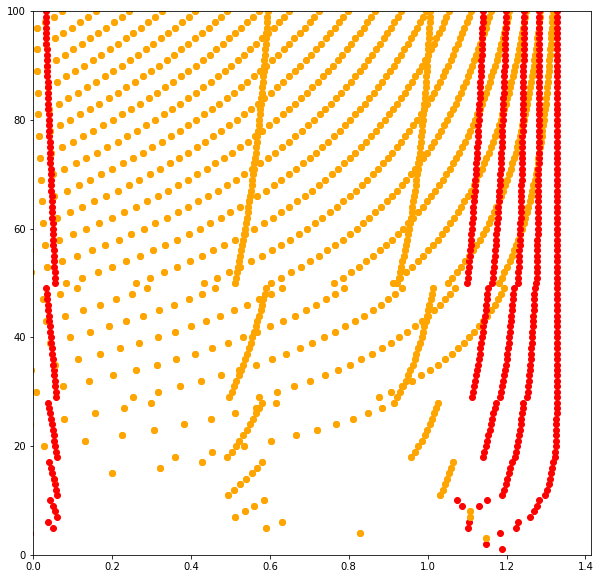

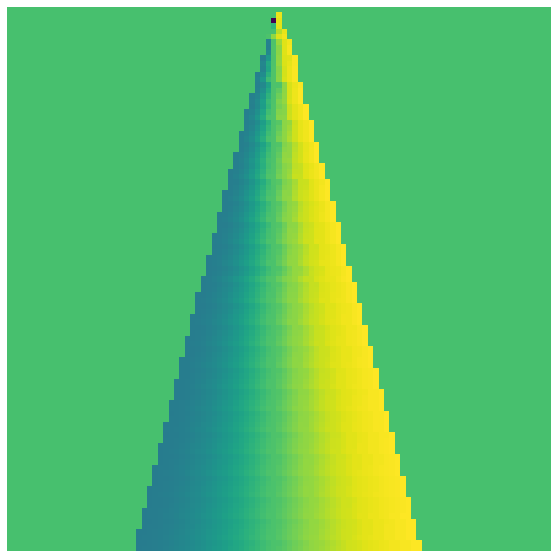

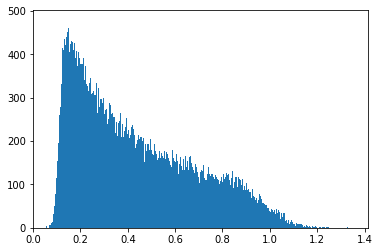

In [553]:
num_bins = 1000
xlim = np.sqrt(2) #upper bound radius within [-1,1] complex square
bins, xrange = np.histogram(magnitude.reshape(-1), bins=num_bins, range=(0, xlim))
x = ((xrange[:-1] + xrange[1:]) / 2)[bins.nonzero()]
y = bins[bins.nonzero()]
all_roots = polyfit_ndeg(x, y)
plt.gcf().set_size_inches(10, 10)
plt.imshow(all_roots)
plt.axis('off')
plt.show()
res = plt.bar(x, y, width=xlim / num_bins)
plt.xlim(0, xlim) 
plt.ylim(0)
plt.show()

In [554]:
np.absolute(np.fft.rfft(bins))[100:].mean()

316.82783886929116

23

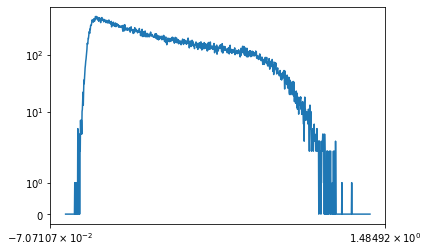

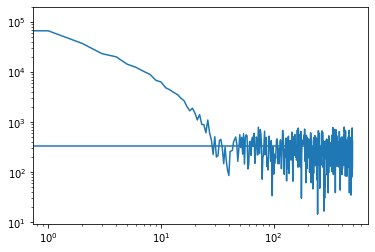

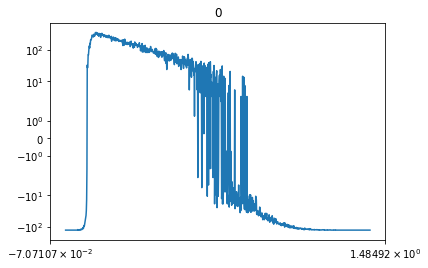

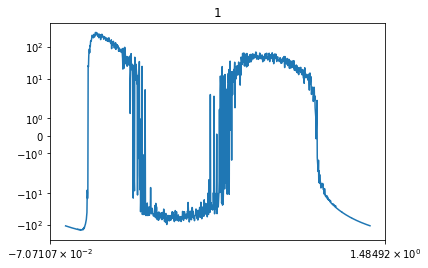

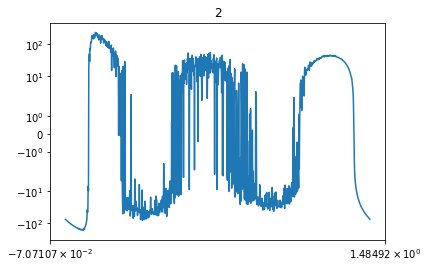

...

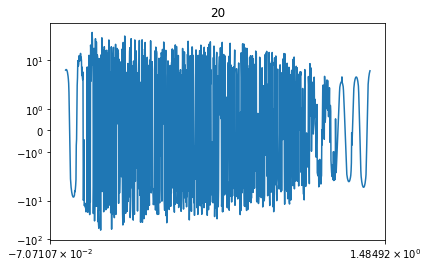

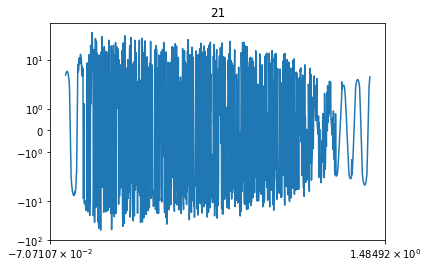

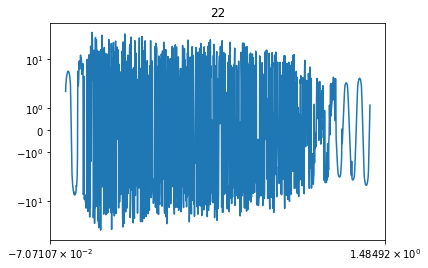

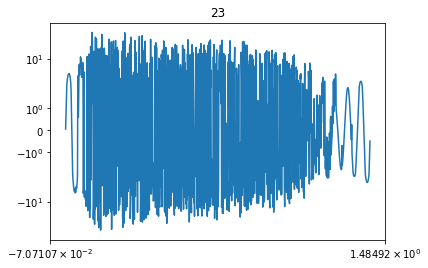

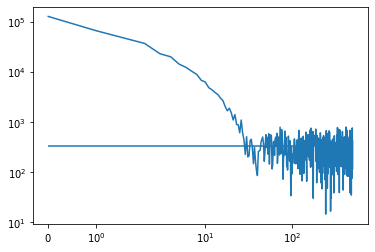

In [585]:
plt.plot(np.linspace(0, np.sqrt(2), len(bins)), bins)
plt.xscale('symlog')
plt.yscale('symlog')
plt.show()

sigma = bins / 100
fft_mag = np.absolute(np.fft.rfft(bins))
noise_mean = fft_mag[np.argmax(fft_mag < fft_mag.mean()):].mean()
plt.plot(fft_mag)
mag_filtered = scipy.ndimage.gaussian_filter1d(fft_mag, 5.0)
plt.hlines(noise_mean, 0, fft_mag.shape[0])
#plt.vlines(0, mag_filtered.max())
#plt.hist(bins[1:] - bins[:-1], bins=100)
plt.xscale('log')
plt.yscale('log')
plt.show()

sigma = bins / 100
fft = np.fft.rfft(bins)
fft_mag = np.absolute(fft)

first_cross = np.argmax(fft_mag < fft_mag.mean())
noise_mean = fft_mag[first_cross:].mean()
for i in range(first_cross + 1):
    fft[i] = 0
    dist_noise = np.fft.irfft(fft)
    plt.plot(np.linspace(0, np.sqrt(2), len(bins)), dist_noise)
    plt.title(i)
    plt.xscale('symlog')
    plt.yscale('symlog')
    plt.show()
plt.plot(fft_mag)
mag_filtered = scipy.ndimage.gaussian_filter1d(fft_mag, 5.0)
plt.hlines(noise_mean, 0, fft_mag.shape[0])
#plt.vlines(0, mag_filtered.max())
#plt.hist(bins[1:] - bins[:-1], bins=100)
plt.xscale('symlog')
plt.yscale('symlog')
plt.show()

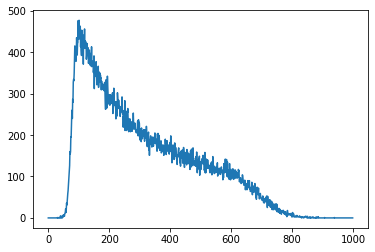

In [506]:
plt.plot(bins)
plt.show()

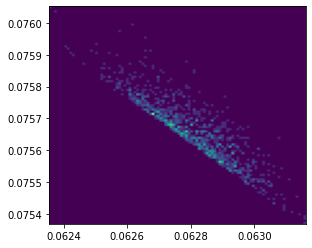

In [601]:
top3 = np.sort(np.absolute(eigval_iters[:,plot_skip_steps:]), axis=0)[:3]
hist, xedges, yedges = np.histogram2d(top3[1], top3[2], bins=100, density=True)
plt.imshow(hist, extent=[xedges[0], xedges[1], yedges[0], yedges[1]])
plt.show()

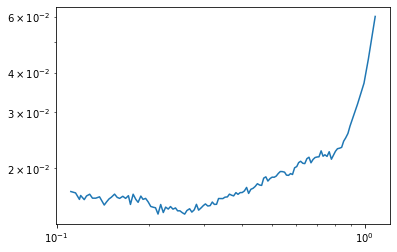

In [613]:
means, stds = [], []
for i in range(eigval_iters.shape[0]):
    iters = np.absolute(eigval_iters[i,plot_skip_steps:])
    means.append(iters.mean())
    stds.append(iters.std())
plt.plot(means, stds)
plt.xscale('log')
plt.yscale('log')
plt.show()

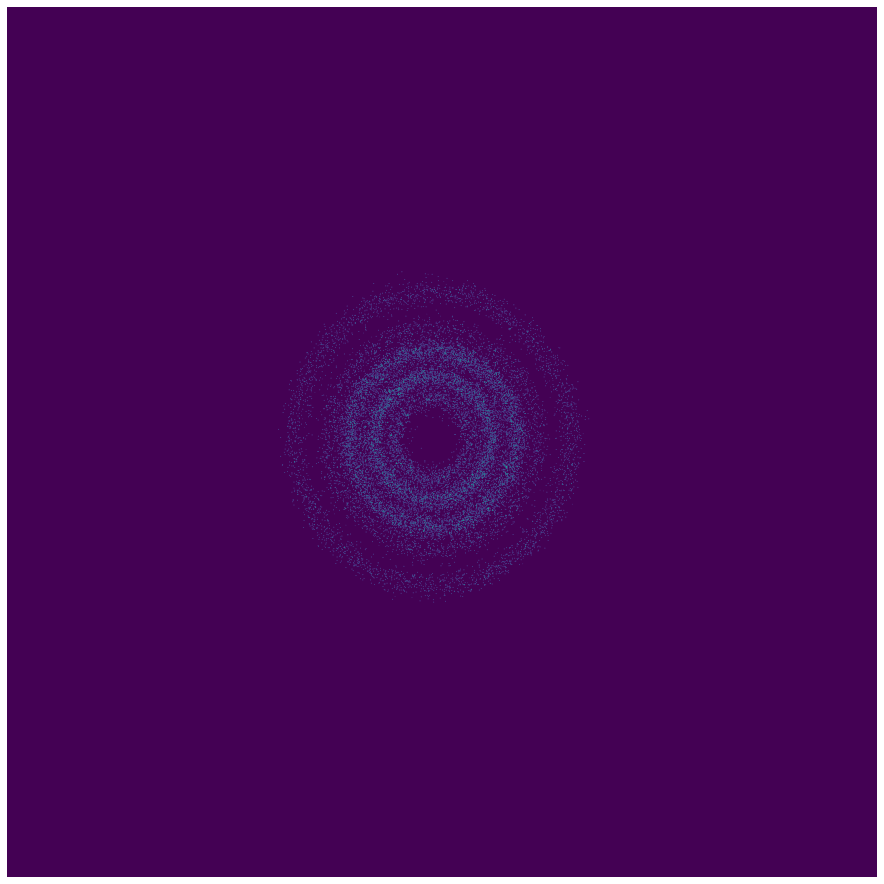

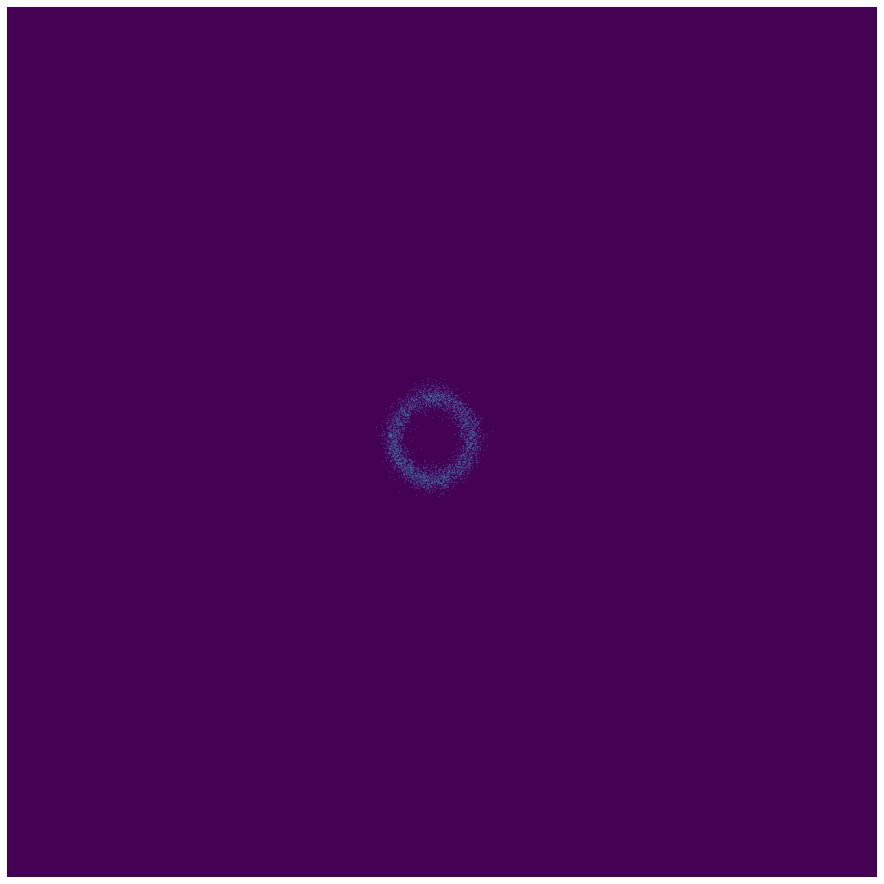

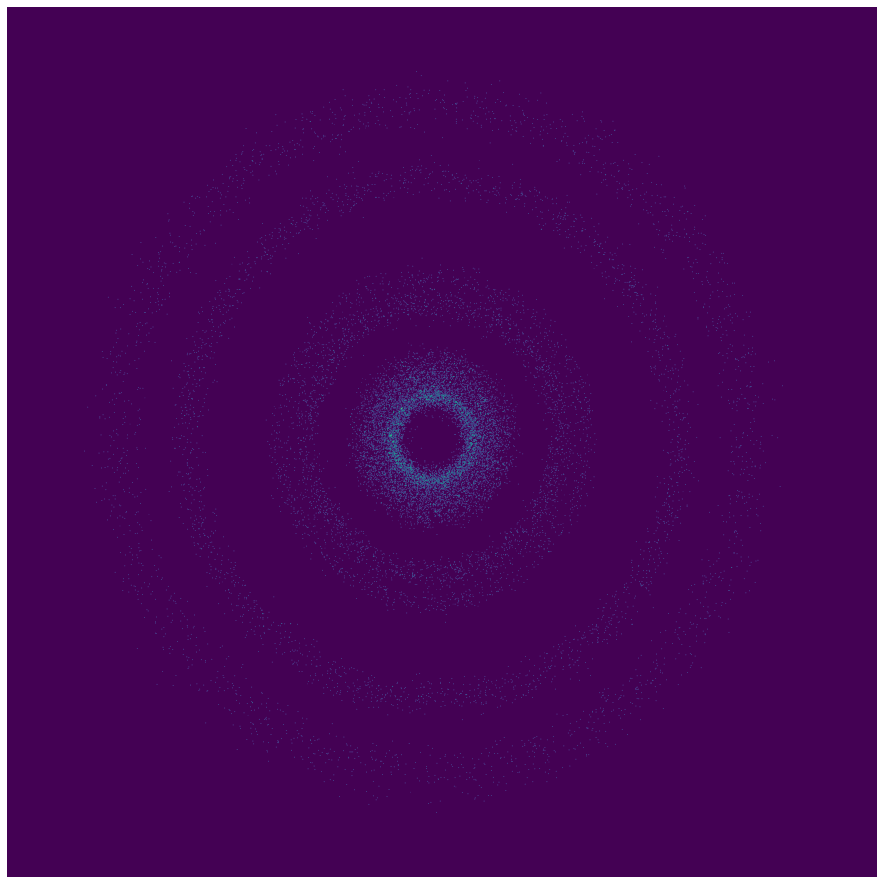

In [631]:
plt.gcf().set_size_inches(16, 16)
pos_map = hue_weights[...,eigval_iters[:,0].real>0].sum(axis=-1)
plt.imshow(pos_map)
plt.axis('off')
plt.show()
#plt.gcf().set_size_inches(16, 16)
#neg_map = hue_weights[...,eigval_iters[:,0].imag<0].sum(axis=-1)
#plt.imshow(neg_map)
#plt.axis('off')
#plt.show()
plt.gcf().set_size_inches(16, 16)
zero_map = hue_weights[...,np.isclose(eigval_iters[:,0].real, 0)].sum(axis=-1)
plt.imshow(zero_map)
plt.axis('off')
plt.show()
plt.gcf().set_size_inches(16, 16)
real_map = hue_weights[...,np.isclose(eigval_iters[:,0].imag, 0)].sum(axis=-1)
plt.imshow(real_map)
plt.axis('off')
plt.show()

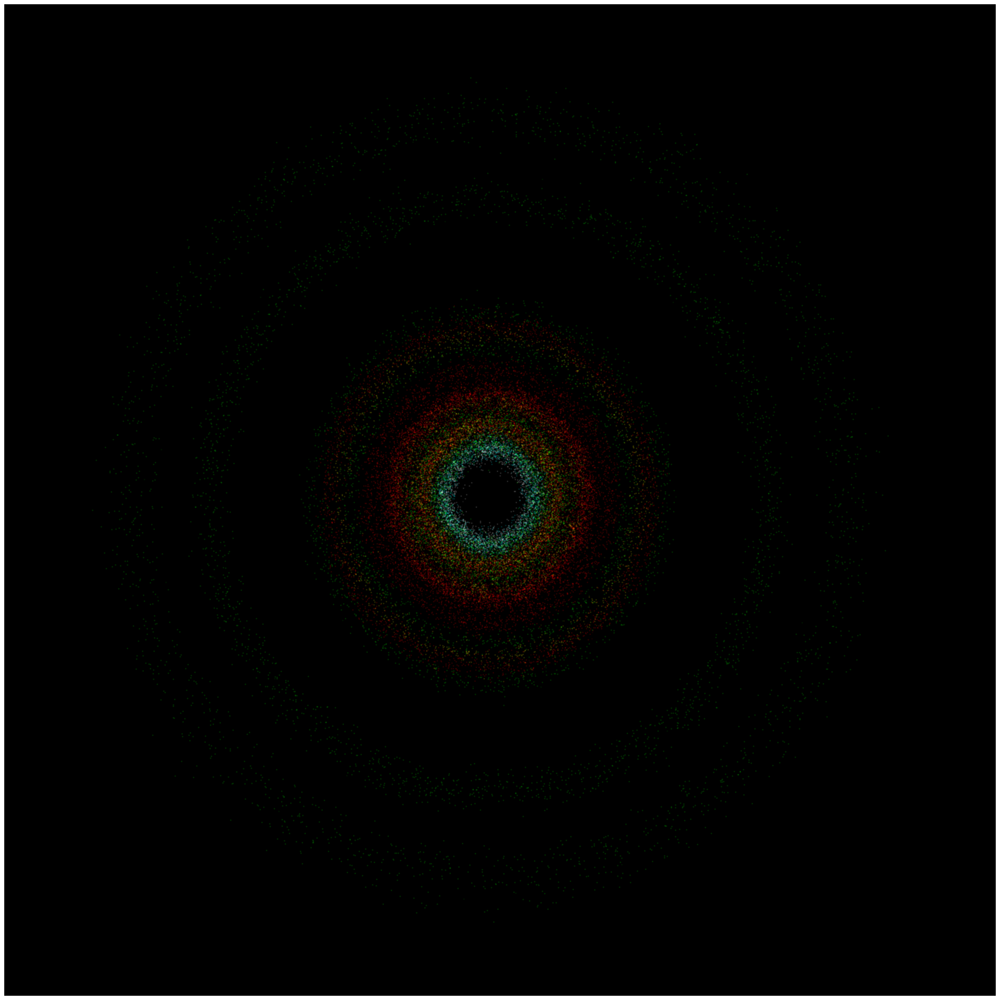

In [632]:
blur_kern = 5
plt.gcf().set_size_inches(30, 30)
combined_map = np.stack([
    convolve2d(pos_map, gkern(blur_kern), mode='same'),
    convolve2d(real_map, gkern(blur_kern), mode='same'),
    convolve2d(zero_map, gkern(blur_kern), mode='same')
], axis=-1)
combined_map /= combined_map.max()
plt.imshow(combined_map)
plt.axis('off')
plt.show()

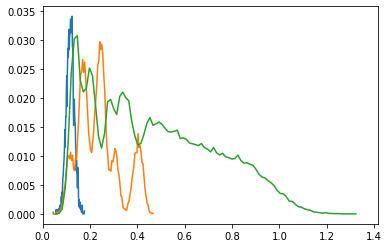

In [700]:
bins, xedges = np.histogram(np.absolute(eigval_iters[np.isclose(eigval_iters[:,0].real, 0),plot_skip_steps:]), bins=100)
bins = bins / bins.sum()
plt.plot((xedges[1:] + xedges[:-1]) / 2, bins)
bins, xedges = np.histogram(np.absolute(eigval_iters[eigval_iters[:,0].real > 0,plot_skip_steps:]), bins=100)
bins = bins / bins.sum()
plt.plot((xedges[1:] + xedges[:-1]) / 2, bins)
bins, xedges = np.histogram(np.absolute(eigval_iters[eigval_iters[:,0].real < 0,plot_skip_steps:]), bins=100)
bins = bins / bins.sum()
plt.plot((xedges[1:] + xedges[:-1]) / 2, bins)
plt.xlim(0, np.sqrt(2))
plt.show()

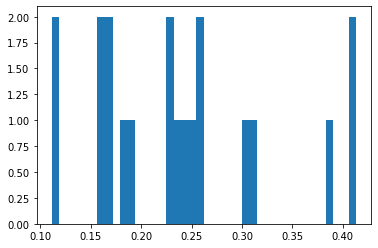

In [719]:
plt.hist(np.absolute(eigval_iters[eigval_iters[:,0].real > 0,plot_skip_steps:]).mean(axis=-1), bins=40)
plt.show()

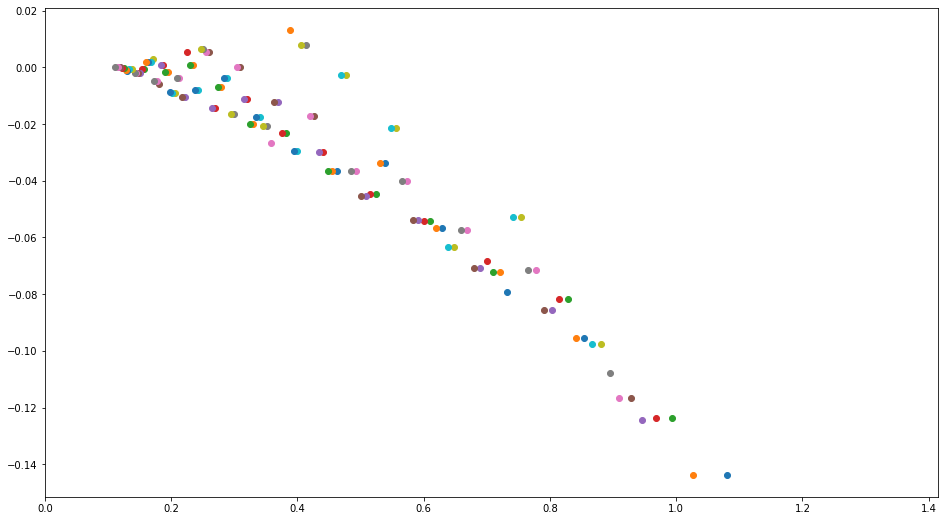

In [678]:
colors = eigval_iters[:,0].real
colors = (colors - colors.min()) / (colors.max() - colors.min())
colors = plt.cm.viridis(colors)
for i in range(eigval_iters.shape[0]):
    #if not eigval_iters[i,0].real > 0:
    #    continue
    #bins, xedges = np.histogram(np.absolute(eigval_iters[i,plot_skip_steps:]), bins=20)
    #bins = bins / bins.sum()
    #plt.plot((xedges[1:] + xedges[:-1]) / 2, bins+, color=colors[i])
    plt.scatter(np.absolute(eigval_iters[i,plot_skip_steps:]).mean(), eigval_iters[i,0].real)

plt.xlim(0, np.sqrt(2))
plt.gcf().set_size_inches(16, 9)
plt.show()

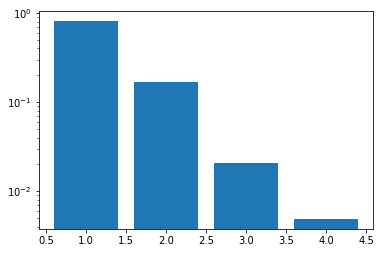

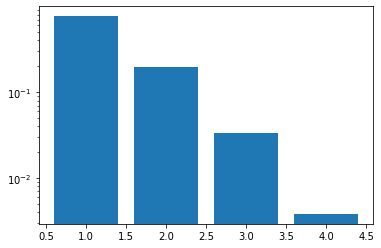

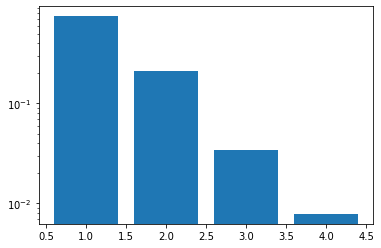

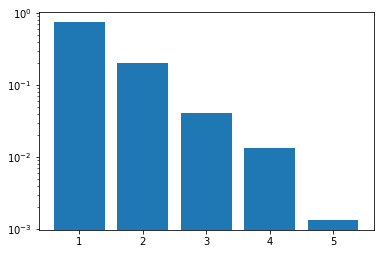

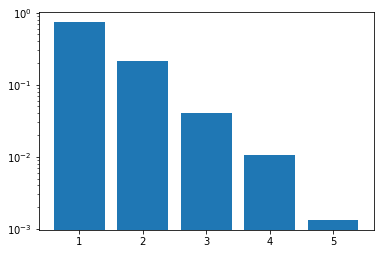

...

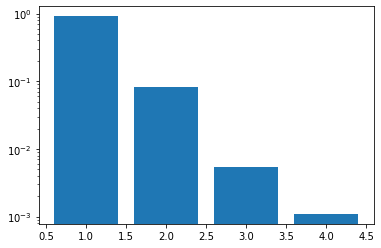

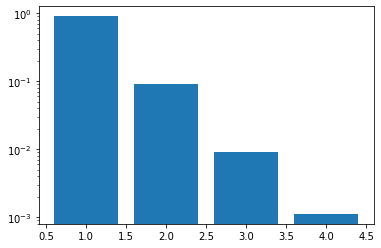

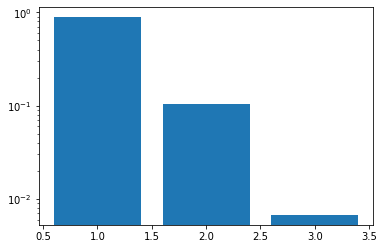

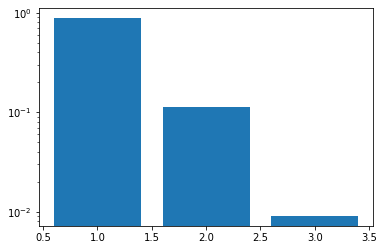

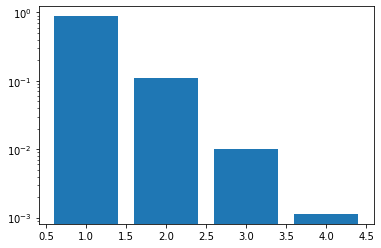

In [754]:
for i in range(eigval_iters.shape[0]):
    hist, xedges, yedges = np.histogram2d(
        eigval_iters[i,plot_skip_steps:].real.reshape(-1), 
        eigval_iters[i,plot_skip_steps:].imag.reshape(-1), 
        100
    )
    levels, counts = np.unique(hist, return_counts=True)
    plt.bar(levels[1:], counts[1:] / (np.prod(hist.shape) - counts[0]))
    plt.yscale('log')
    plt.show()

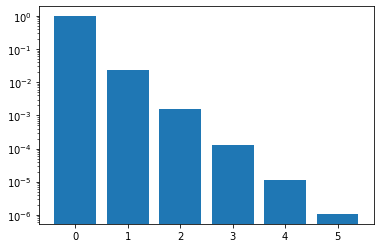

In [745]:

plt.bar(levels, counts / np.prod(hist.shape))
plt.yscale('log')
plt.show()

  0%|          | 0/1000000 [00:00<?, ?it/s]

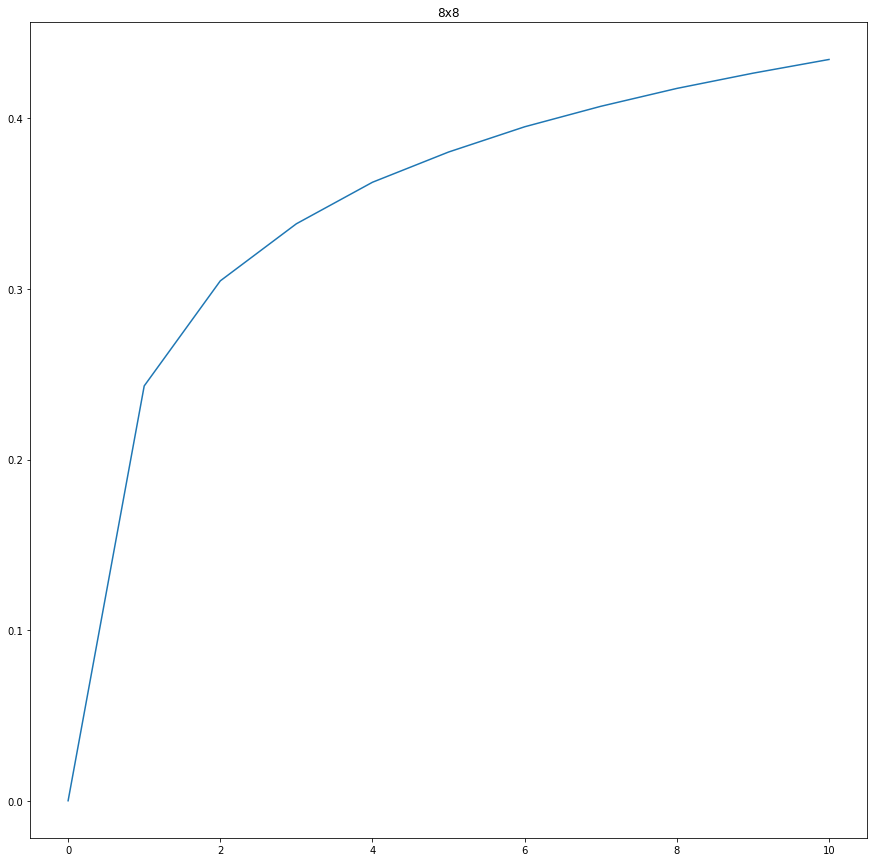

In [827]:
dims = 8
iters = 1000000
hist_check = 100000
bins = 1080
lim = np.sqrt(2)
extent = np.array([
    [-lim, lim],
    [-lim, lim]
])

mat = np.random.randn(dims, dims)
hists = []
eigvals = np.zeros((dims, iters), dtype=np.complex)
for i in tqdm.notebook.tqdm(range(iters)):
    vals, mat = np.linalg.eig(mat)
    eigvals[:,i] = vals
    if (i == 0) or ((i+1) % hist_check == 0):
        hist, xedges, yedges = np.histogram2d(
            eigvals.real[:i+1].reshape(-1), 
            eigvals.imag[:i+1].reshape(-1),
            bins=bins,
            range=extent
        )
        hists.append(np.count_nonzero(hist) / hist.size)
#hists = np.stack(hists)
#errors = np.abs(hists[1:] - hists[:-1]).sum(axis=-1).sum(axis=-1)
plt.gcf().set_size_inches(15, 15)
plt.plot(hists)
plt.title(F"{dims}x{dims}")
plt.show()

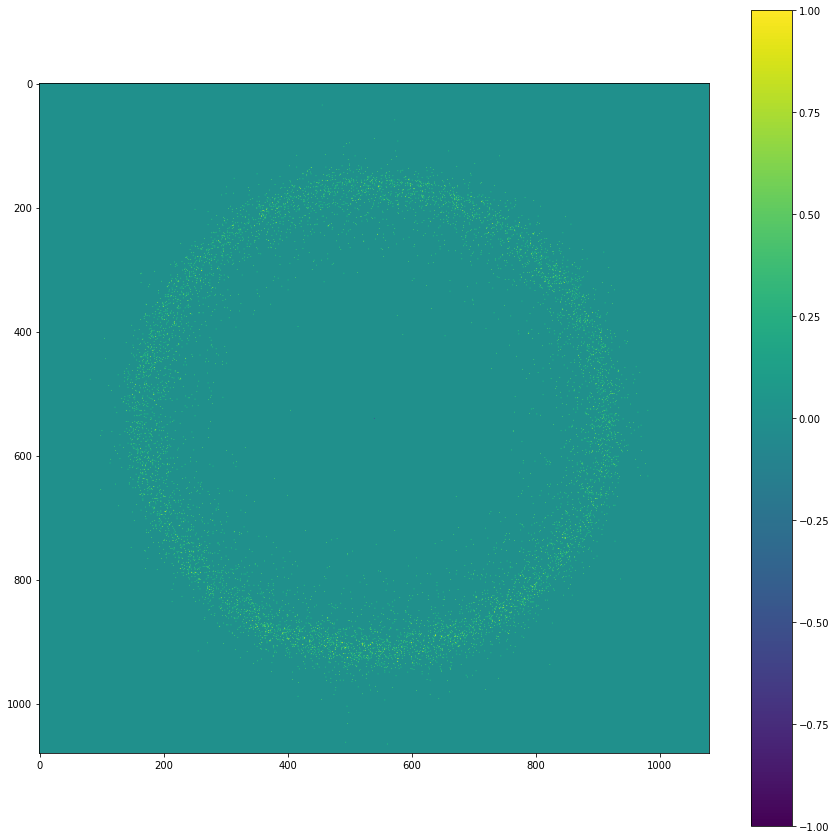

In [820]:
plt.gcf().set_size_inches(15, 15)
plt.imshow(np.sign(hists[-1] - hists[-2]))
plt.colorbar()
plt.show()

  0%|          | 0/100000 [00:00<?, ?it/s]

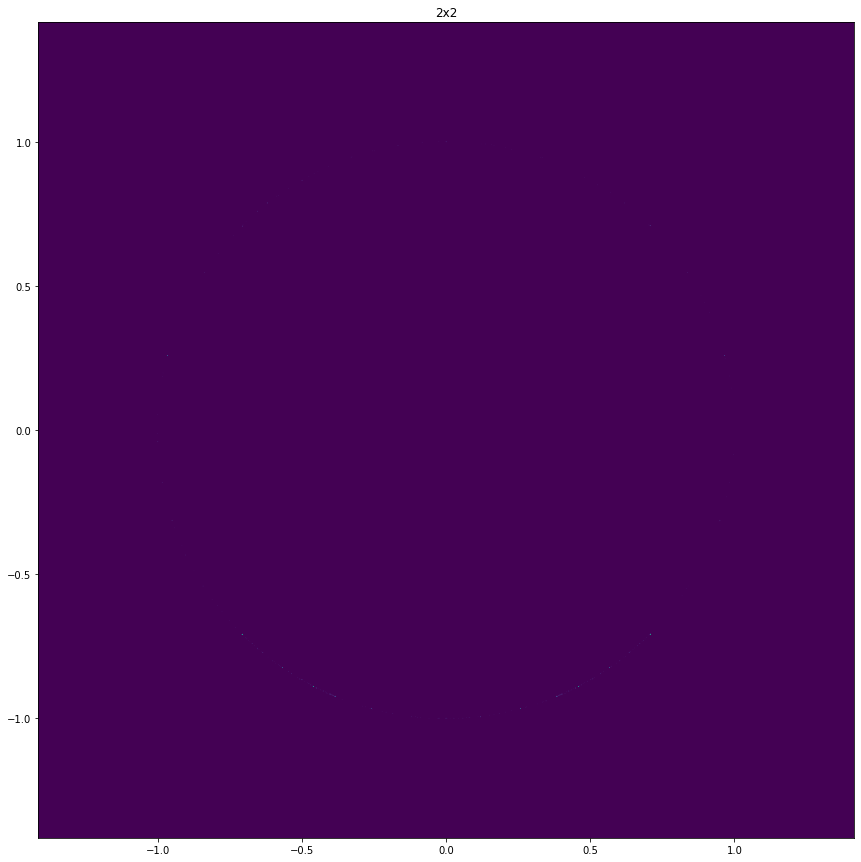

  0%|          | 0/100000 [00:00<?, ?it/s]

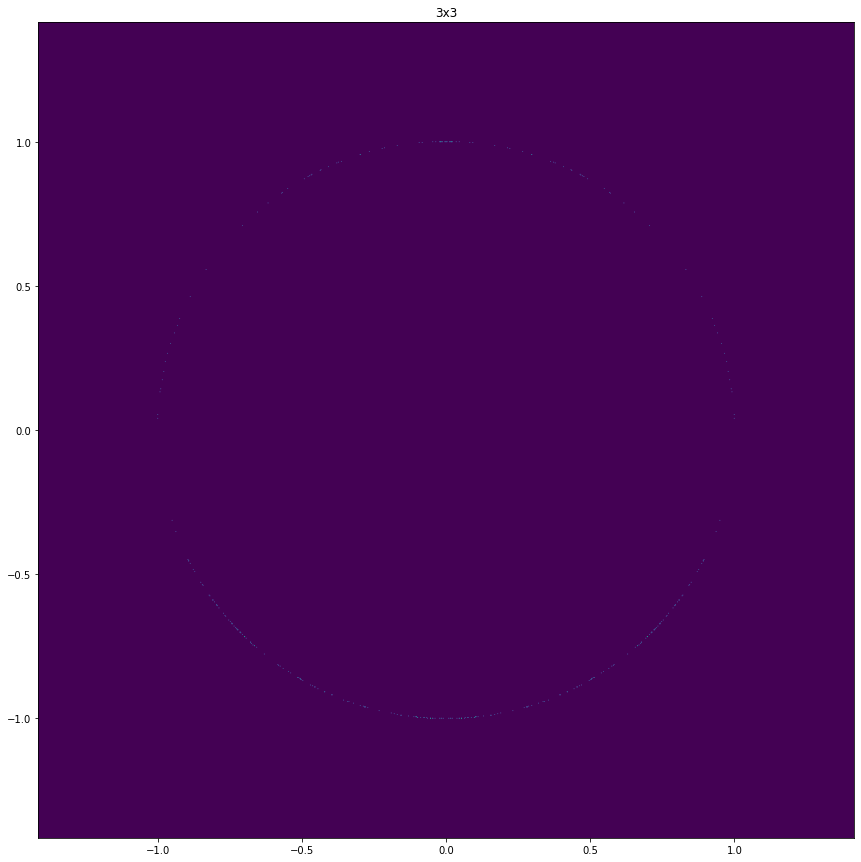

  0%|          | 0/100000 [00:00<?, ?it/s]

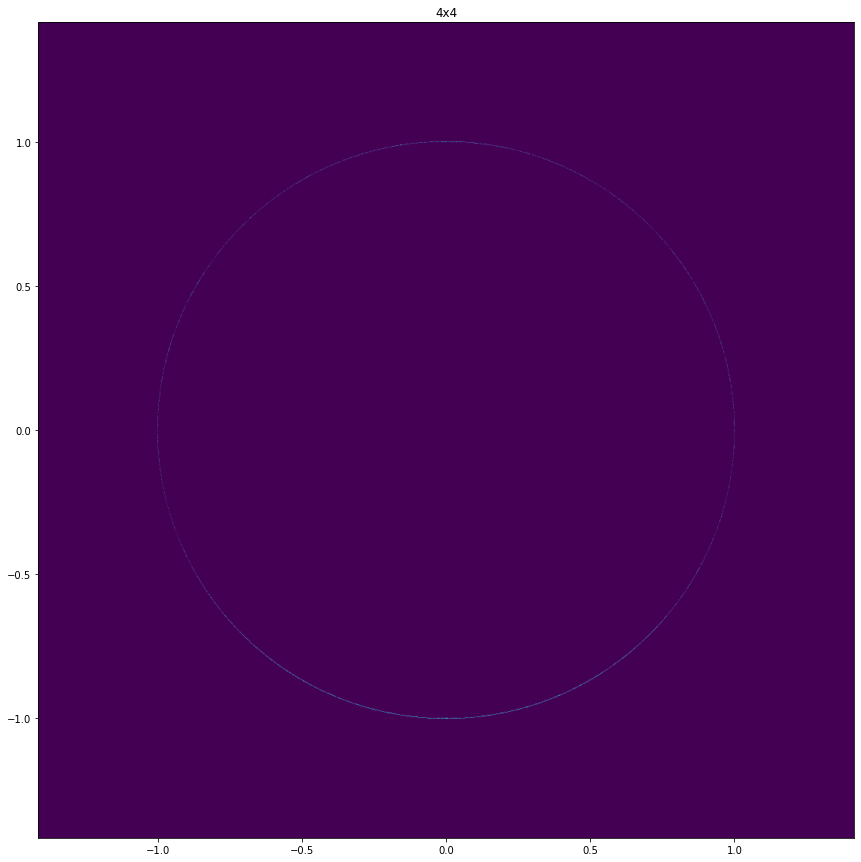

  0%|          | 0/100000 [00:00<?, ?it/s]

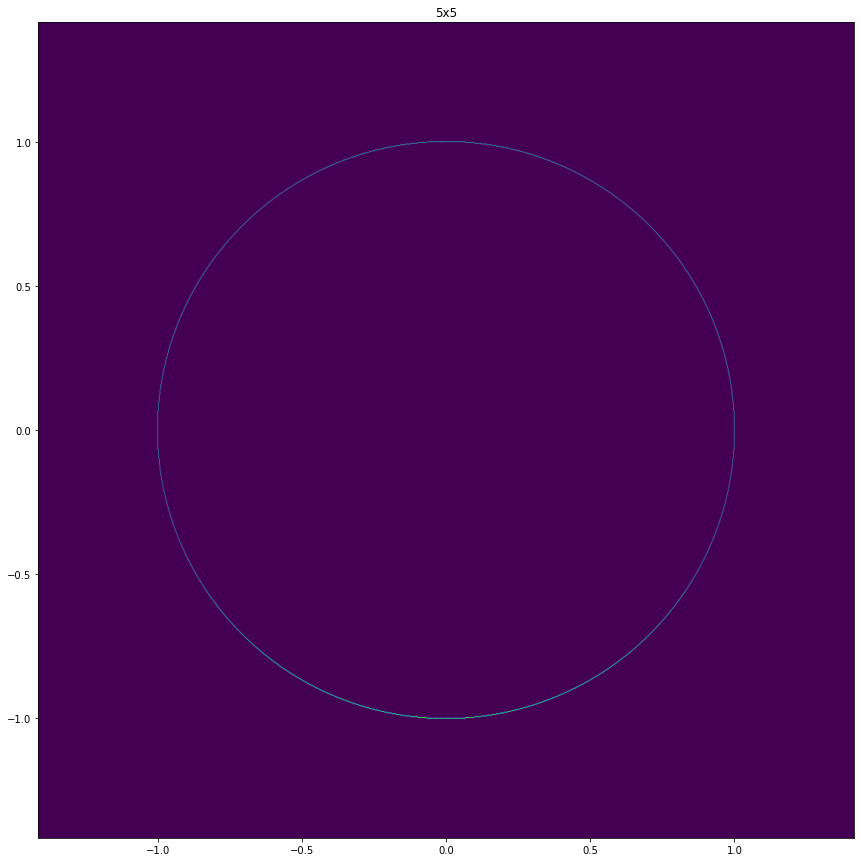

  0%|          | 0/100000 [00:00<?, ?it/s]

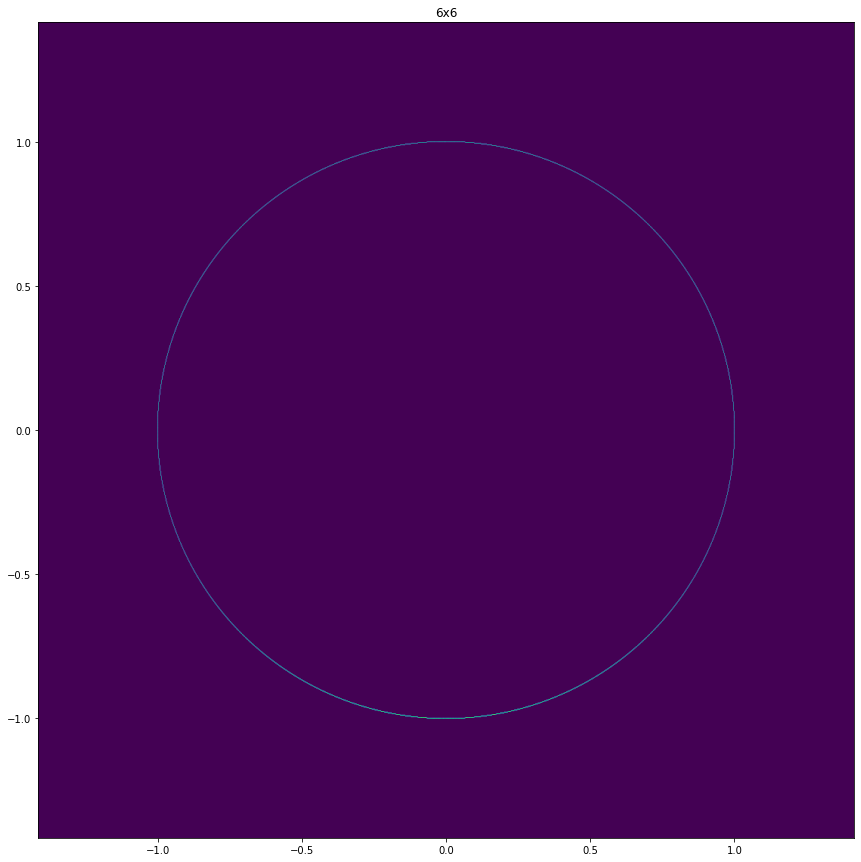

  0%|          | 0/100000 [00:00<?, ?it/s]

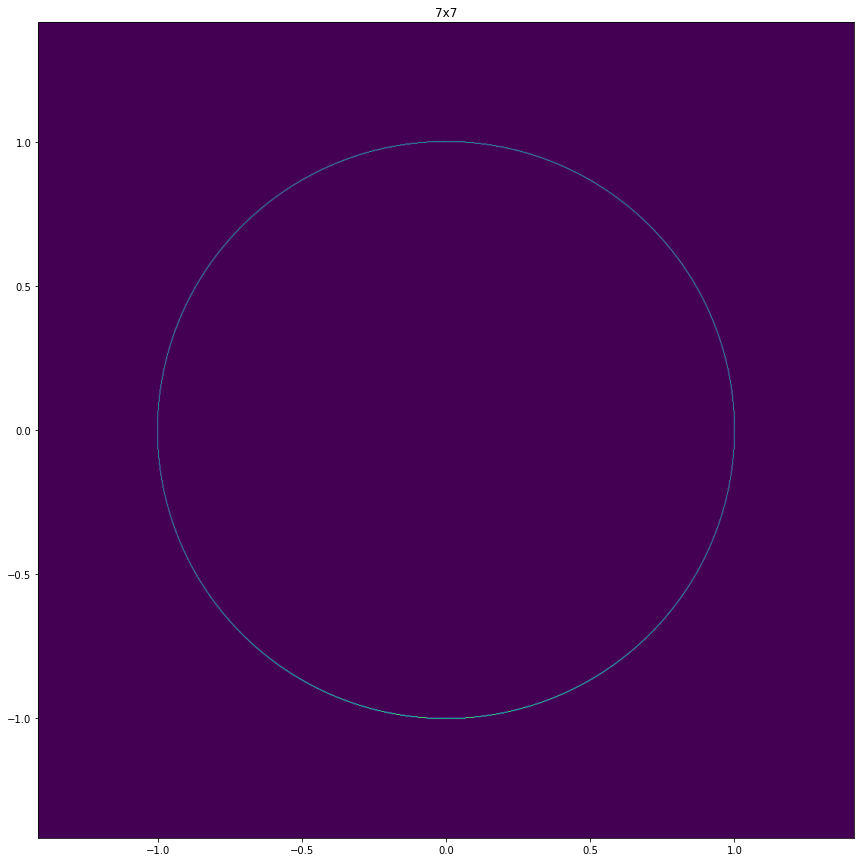

  0%|          | 0/100000 [00:00<?, ?it/s]

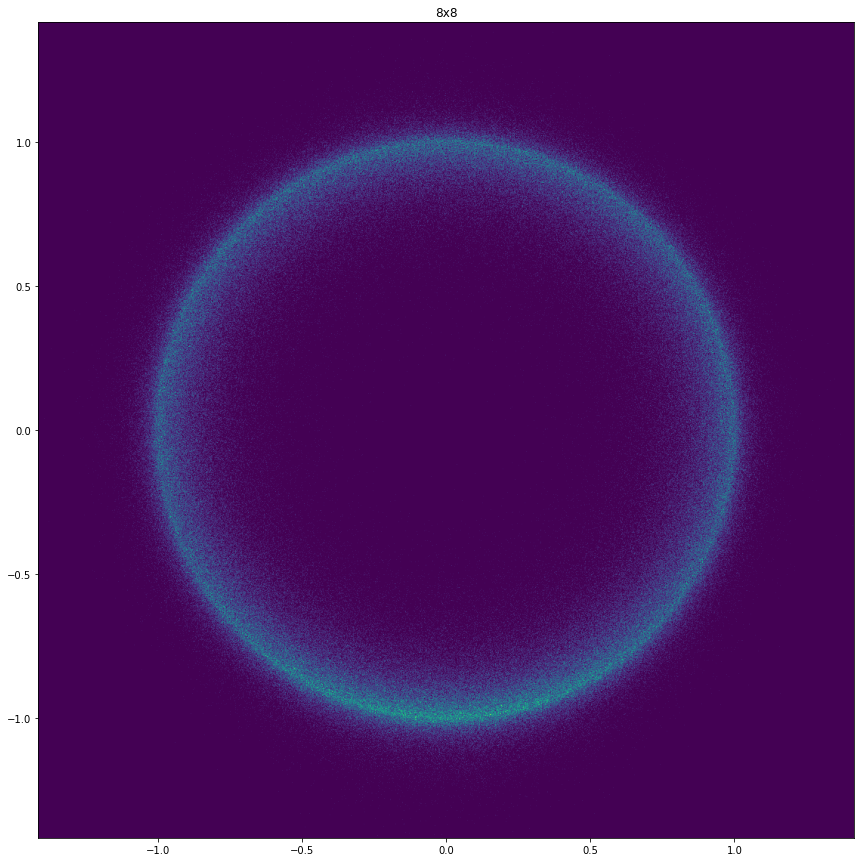

  0%|          | 0/100000 [00:00<?, ?it/s]

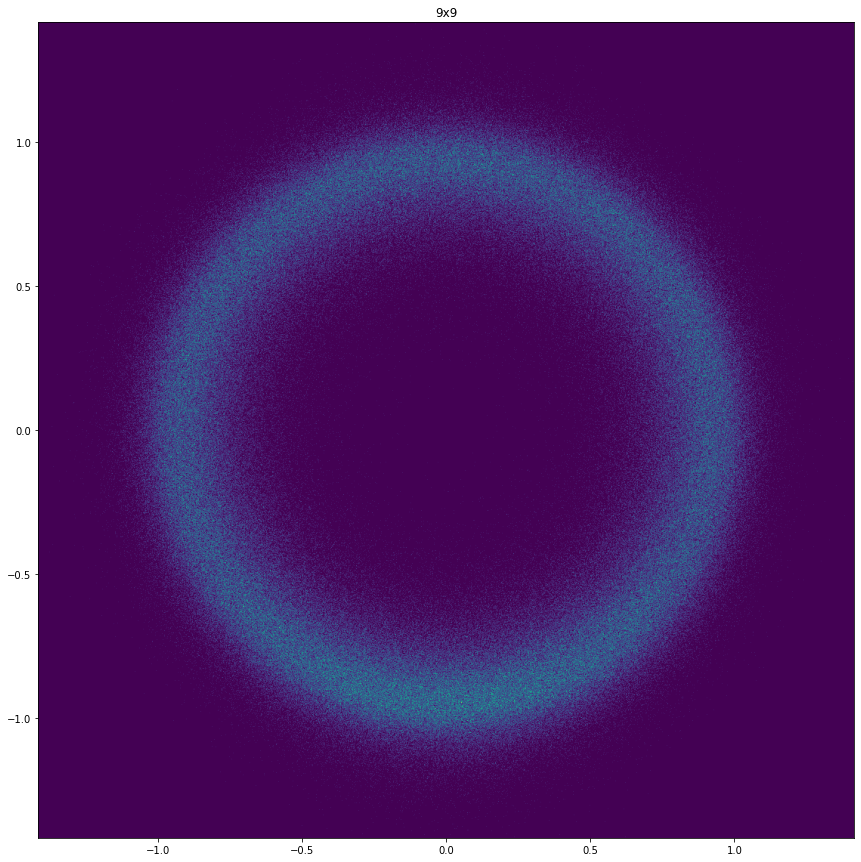

  0%|          | 0/100000 [00:00<?, ?it/s]

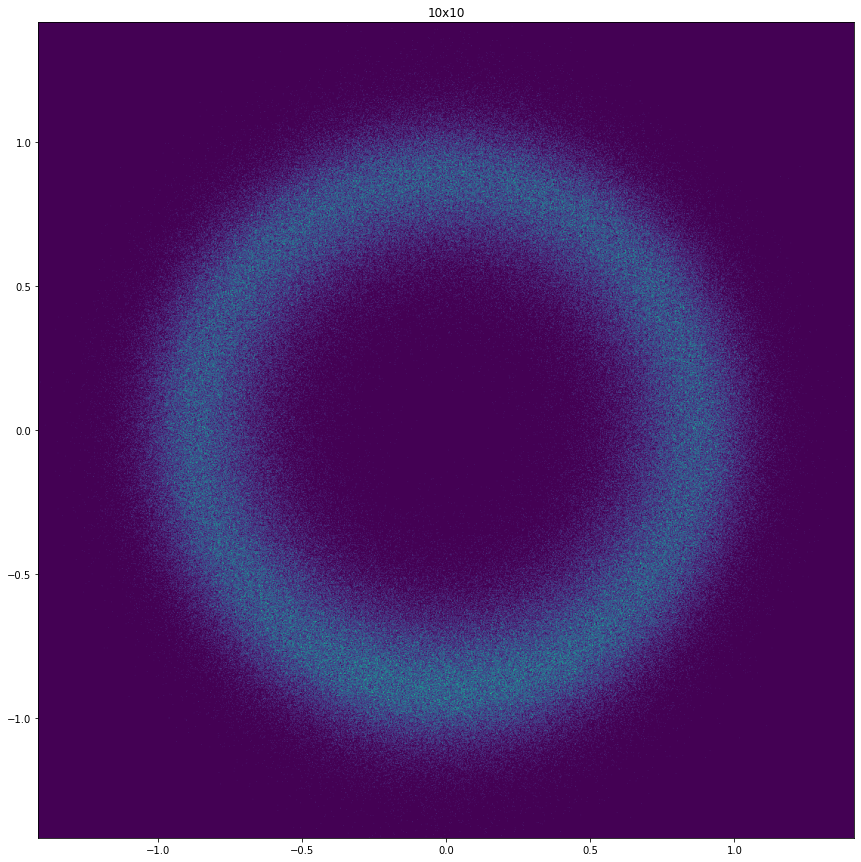

In [828]:
max_dims = 10
iters = 100000
bins = 1080
skip_iters = 2
lim = np.sqrt(2)
extent = np.array([
    [-lim, lim],
    [-lim, lim]
])
for dims in range(2, max_dims+1):
    mat = np.random.randn(dims, dims)
    eigvals = np.zeros((dims, iters-skip_iters), dtype=np.complex)
    for i in tqdm.notebook.tqdm(range(iters)):
        vals, mat = np.linalg.eig(mat)
        if i < skip_iters:
            continue
        eigvals[:,i-skip_iters] = vals

    hist, xedges, yedges = np.histogram2d(
        eigvals.real.reshape(-1), 
        eigvals.imag.reshape(-1),
        bins=bins,
        range=extent,
        density=True
    )
    plt.gcf().set_size_inches(15, 15)
    plt.imshow(hist, extent=extent.reshape(-1))
    plt.title(F"{dims}x{dims}")
    plt.show()

Dimensions:   0%|          | 0/39 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

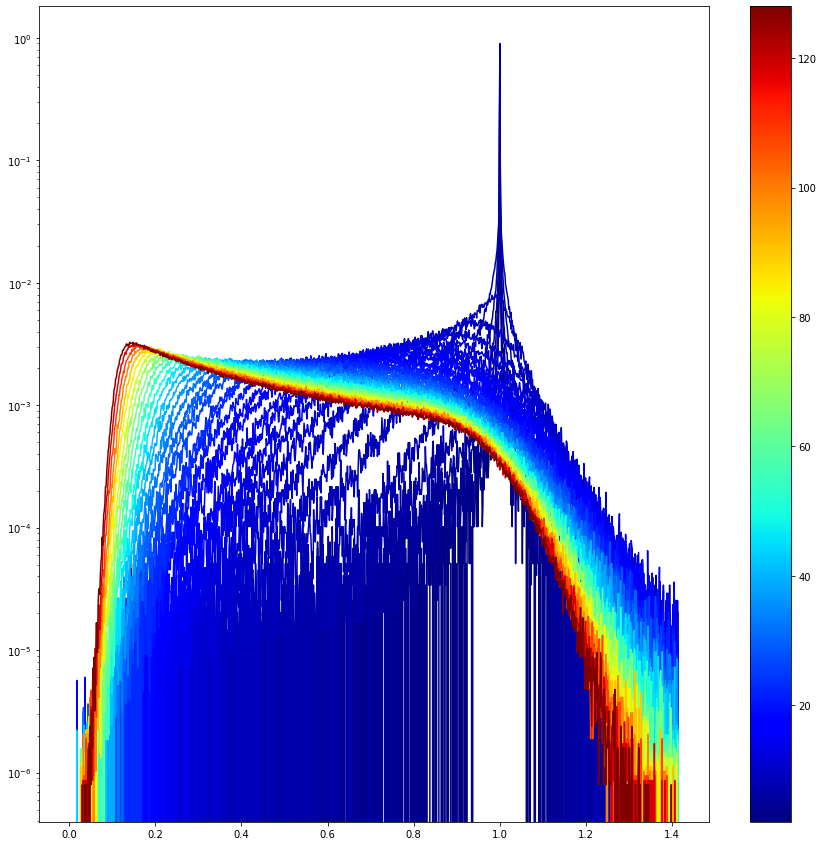

In [864]:
import matplotlib.colors as mcolors

max_dims = 128
n_dims = 50
samples = 100
iters = 100
bins = 1080
skip_iters = 2
lim = np.sqrt(2)
extent = np.array([
    [-lim, lim],
    [-lim, lim]
])
dim_range = np.unique(np.round(np.geomspace(2, max_dims, n_dims)).astype(np.int32))
#dim_range = np.arange(2, max_dims+1)
dim_hists = []
for dims in tqdm.notebook.tqdm(dim_range, "Dimensions"):
    eigvals = np.zeros((dims, samples, iters-skip_iters), dtype=np.complex)
    for sample in tqdm.notebook.tqdm(range(samples), "Random Samples", leave=False):
        mat = np.random.randn(dims, dims)
        for i in range(iters):
            vals, mat = np.linalg.eig(mat)
            if i < skip_iters:
                continue
            eigvals[:,sample,i-skip_iters] = vals

    hist, xedges = np.histogram(np.absolute(eigvals.reshape(-1)), bins=bins, range=[0, lim])
    plt.gcf().set_size_inches(27, 15)
    plt.plot(
        (xedges[1:] + xedges[:-1]) / 2, 
        hist / hist.sum(),
        color=plt.cm.jet((dims-2) / (max_dims-2)),
        label=F"n={dims}"
    )
    dim_hists.append(hist / hist.sum())
dim_hists = np.stack(dim_hists)

color_norm = mcolors.Normalize(vmin=2, vmax=max_dims)
colorbar = plt.cm.ScalarMappable(norm=color_norm, cmap=plt.cm.jet)
colorbar.set_array(dim_range)
plt.colorbar(colorbar)
plt.yscale('log')
plt.show()

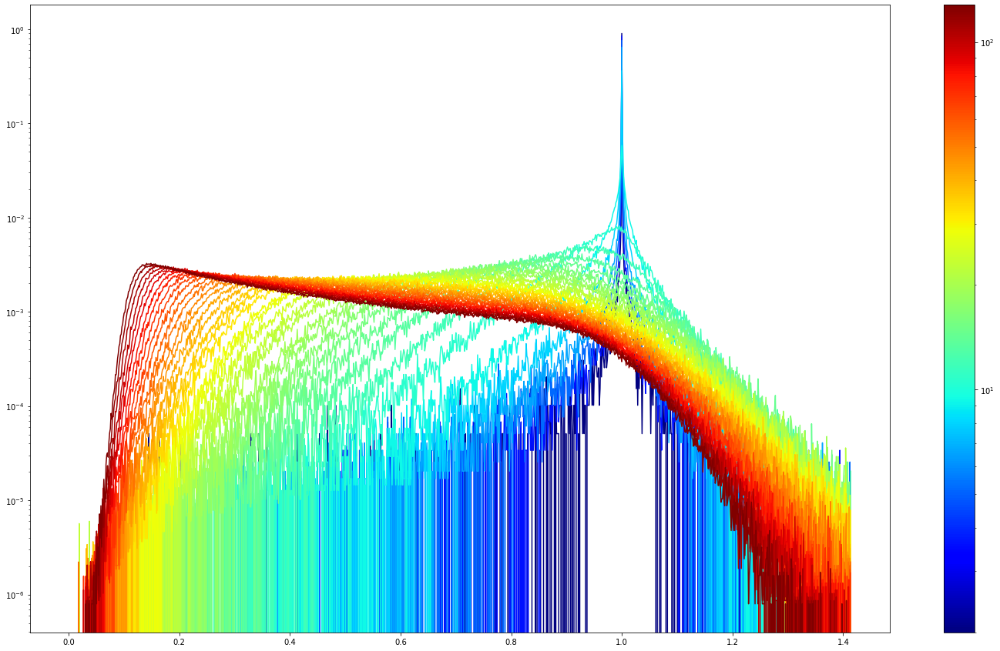

In [871]:
#dim_hists = np.stack(dim_hists)
plt.gcf().set_size_inches(25, 15)

for dims, hist in zip(dim_range[:len(dim_hists)], dim_hists):
    plt.plot(
        (xedges[1:] + xedges[:-1]) / 2, 
        hist / hist.sum(),
        color=plt.cm.jet(np.log(dims-1) / np.log(dim_range[len(dim_hists)-1]-1)),
        label=F"n={dims}"
    )
color_norm = mcolors.LogNorm(vmin=2, vmax=dim_range[len(dim_hists)-1])
colorbar = plt.cm.ScalarMappable(norm=color_norm, cmap=plt.cm.jet)
colorbar.set_array(dim_range[:len(dim_hists)])
plt.colorbar(colorbar)
plt.yscale('log')
plt.show()

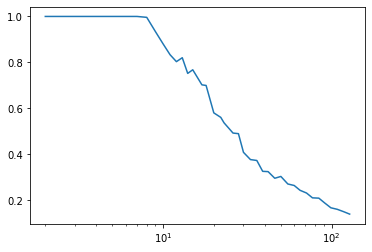

In [879]:
plt.plot(dim_range[:len(dim_hists)], ((xedges[1:] + xedges[:-1]) / 2)[dim_hists.argmax(axis=-1)])
plt.xscale('log')
plt.show()

In [993]:
max_dims = 128
n_dims = 50
samples = 50
iters = 20000
bins = 1080
skip_iters = 2
lim = np.sqrt(2)
extent = np.array([
    [-lim, lim],
    [-lim, lim]
])

def get_mag_hist(vals, bins=bins, range=[0, lim], skip_iters=skip_iters):
    hist, edges = np.histogram(
        np.absolute(vals[:,skip_iters:]).reshape(-1), 
        bins=bins, 
        range=[0, lim]
    )
    if hist.sum() > 0:
        hist = hist / hist.sum()
    return hist


dim_range = np.unique(np.round(np.geomspace(2, max_dims, n_dims)).astype(np.int32))
#dim_range = np.arange(2, max_dims+1)
dim_hists = np.zeros((9, dim_range.size, bins))
for dim_idx, dims in enumerate(tqdm.notebook.tqdm(dim_range, "Dimensions")):
    for sample in tqdm.notebook.tqdm(range(samples), "Random Samples", leave=False):
        eigvals = np.zeros((dims, iters), dtype=np.complex)
        mat = np.random.randn(dims, dims)
        for i in range(iters):
            vals, mat = np.linalg.eig(mat)
            eigvals[:,i] = vals
            
        pos_idxs = eigvals[:,0].real > 0
        zero_idxs = np.isclose(eigvals[:,0].real, 0)
        neg_idxs = eigvals[:,0].real < 0
        imag_zero_idxs = np.isclose(eigvals[:,0].imag, 0)
        
        dim_hists[0,dim_idx] += get_mag_hist(eigvals[pos_idxs])
        dim_hists[1,dim_idx] += get_mag_hist(eigvals[zero_idxs])
        dim_hists[2,dim_idx] += get_mag_hist(eigvals[neg_idxs])
        dim_hists[3,dim_idx] += get_mag_hist(eigvals[np.logical_and(pos_idxs, imag_zero_idxs)])
        dim_hists[4,dim_idx] += get_mag_hist(eigvals[np.logical_and(zero_idxs, imag_zero_idxs)])
        dim_hists[5,dim_idx] += get_mag_hist(eigvals[np.logical_and(neg_idxs, imag_zero_idxs)])
        dim_hists[6,dim_idx] += get_mag_hist(eigvals[np.logical_and(pos_idxs, ~imag_zero_idxs)])
        dim_hists[7,dim_idx] += get_mag_hist(eigvals[np.logical_and(zero_idxs, ~imag_zero_idxs)])
        dim_hists[8,dim_idx] += get_mag_hist(eigvals[np.logical_and(neg_idxs, ~imag_zero_idxs)])

Dimensions:   0%|          | 0/39 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/50 [00:00<?, ?it/s]

KeyboardInterrupt: 

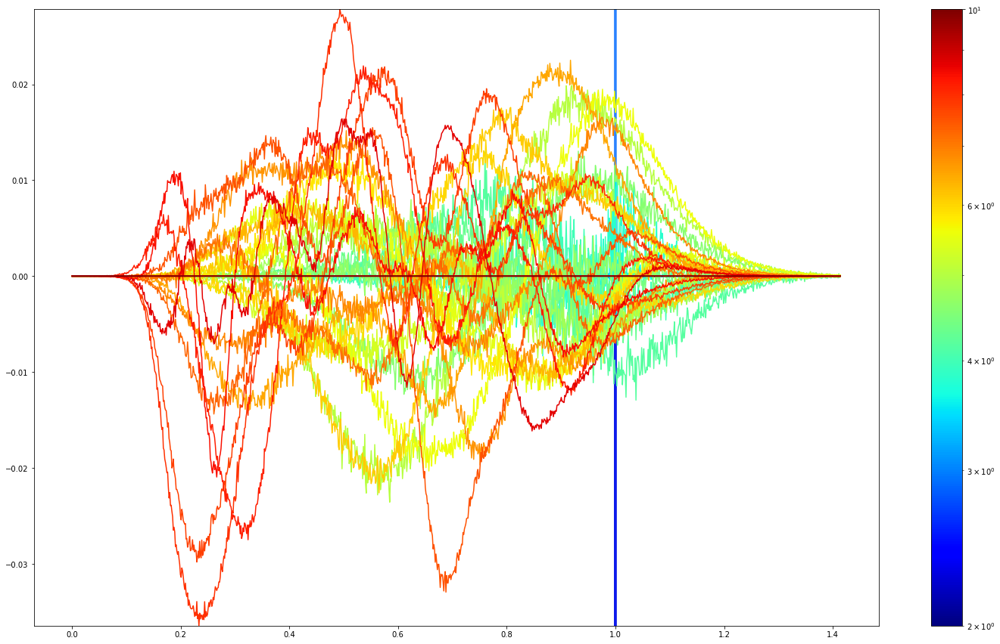

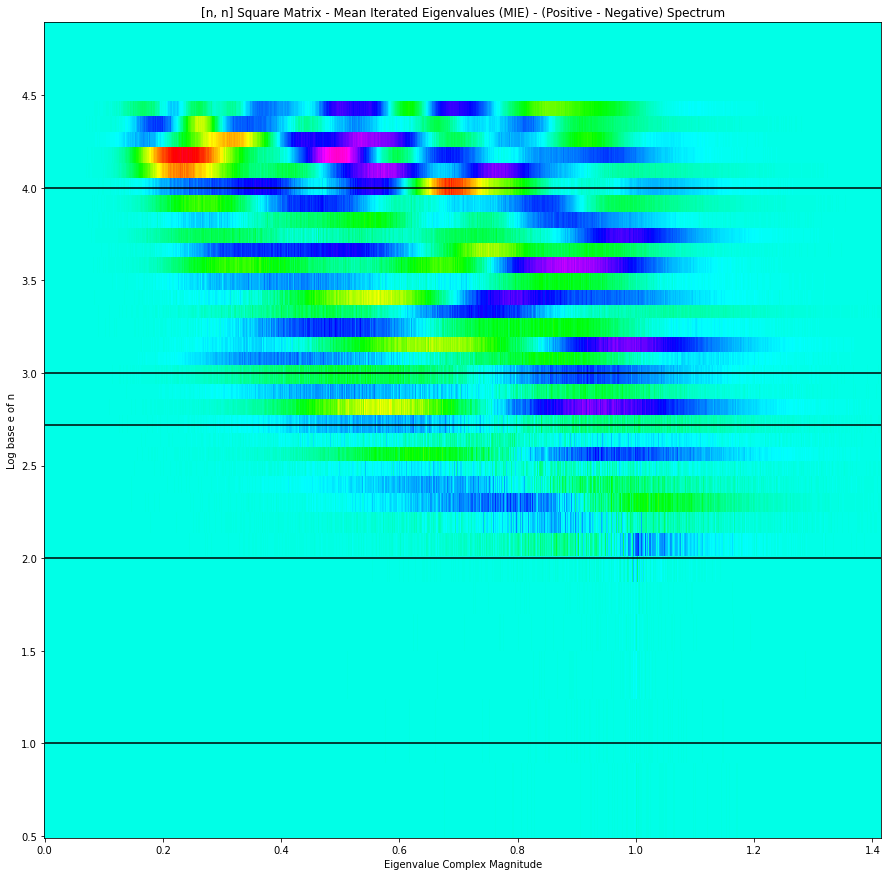

In [1068]:
term = dim_hists[0] - dim_hists[2]

for dims, hist in zip(dim_range[:dim_hists.shape[1]], term):
    plt.plot(
        (xedges[1:] + xedges[:-1]) / 2, 
        hist,
        color=plt.cm.jet(np.log(dims-1) / np.log(dim_range[dim_hists.shape[1]-1]-1)),
        label=F"n={dims}"
    )
color_norm = mcolors.LogNorm(vmin=2, vmax=dim_range[len(dim_hists)-1])
colorbar = plt.cm.ScalarMappable(norm=color_norm, cmap=plt.cm.jet)
colorbar.set_array(dim_range[:len(dim_hists)])
plt.colorbar(colorbar)
plt.ylim(term[np.abs(term) < .9].min(), term[np.abs(term) < .9].max())
#plt.yscale('symlog')
plt.gcf().set_size_inches(25, 15)
plt.show()

#plt.imshow(
#    np.sign(term) * np.log(np.abs(term) + 1e-6), 
#    extent=[0, np.sqrt(2), 0, np.sqrt(2)],
#    interpolation='lanczos'
#)
#plt.gcf().set_size_inches(15, 15)
#plt.show()

plt.pcolormesh(
    np.linspace(0, np.sqrt(2), term.shape[-1]),
    np.log(dim_range) / np.log(np.e),
    term,
    vmin=term[np.abs(term) < .9].min(),
    vmax=term[np.abs(term) < .9].max(),
    shading='nearest',
    cmap='gist_rainbow'
)
hlines = [1, 2, np.e, 3, 4]
plt.hlines(hlines, np.full(len(hlines), 0), np.full(len(hlines), np.sqrt(2)), color='black')
plt.title("[n, n] Square Matrix - Mean Iterated Eigenvalues (MIE) - (Positive - Negative) Spectrum")
plt.xlabel("Eigenvalue Complex Magnitude")
plt.ylabel("Log base e of n")
plt.gcf().set_size_inches(15, 15)
plt.show()

In [1032]:
from scipy.io import wavfile
strips = np.sign(term) * np.log(np.abs(term) + 1e-6)
for i in range(strips.shape[0]):
    signal = np.fft.irfft(strips[i], n=1100000)[50000:-50000]
    wavfile.write(F"out/eigensignals/{dim_range[i]}.wav", 44100, signal)

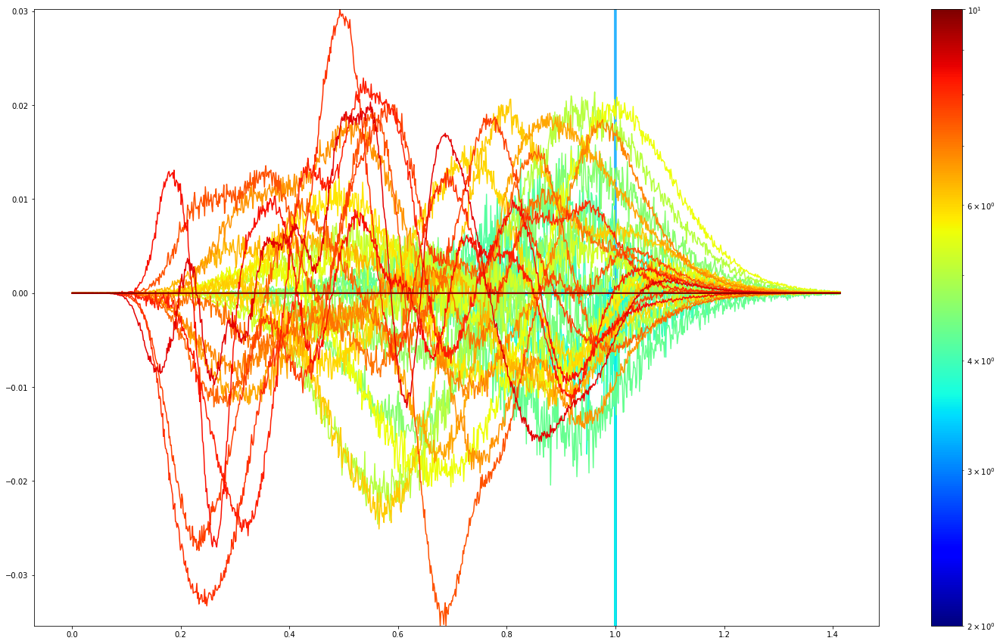

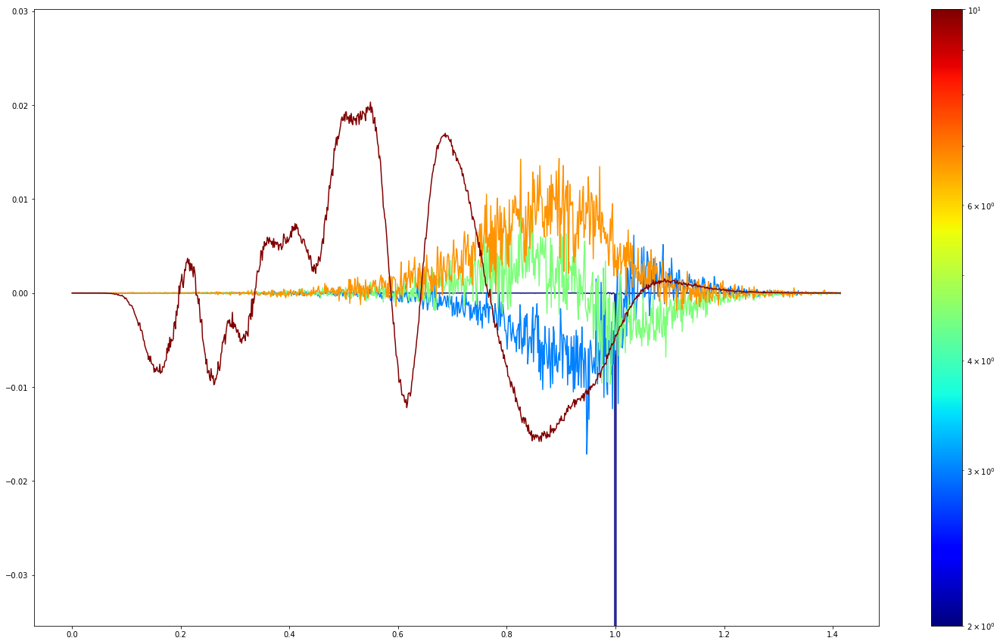

<Figure size 1080x1080 with 0 Axes>

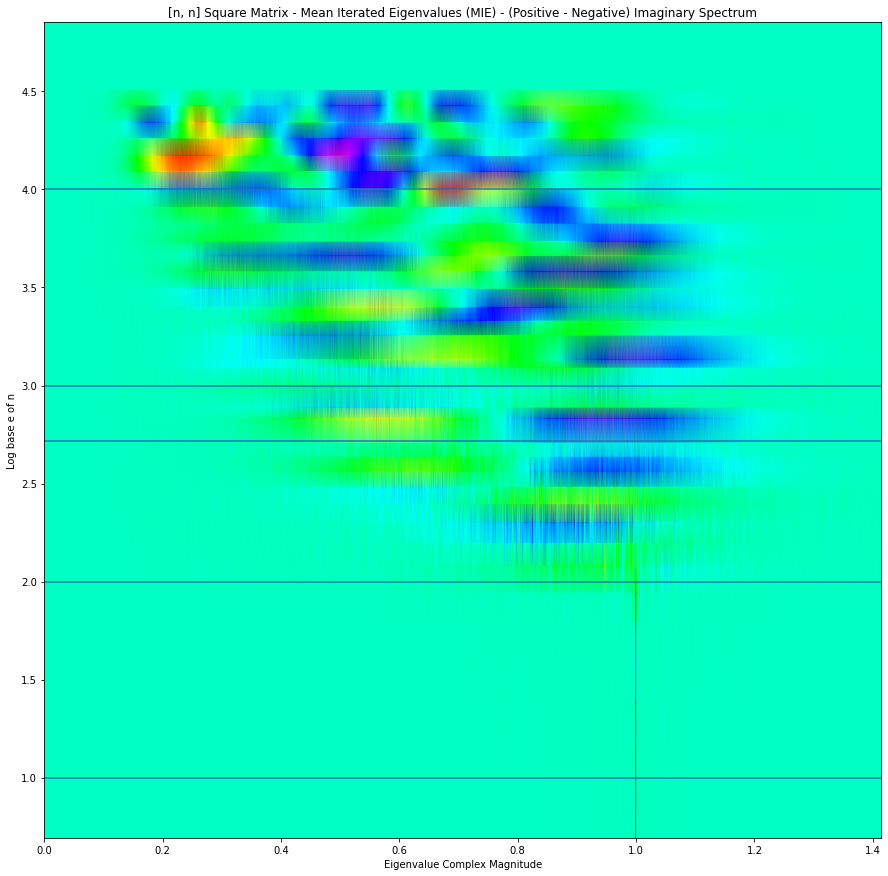

In [1066]:
term = dim_hists[6] - dim_hists[8]

for dims, hist in zip(dim_range[:dim_hists.shape[1]], term):
    plt.plot(
        (xedges[1:] + xedges[:-1]) / 2, 
        hist,
        color=plt.cm.jet(np.log(dims-1) / np.log(dim_range[dim_hists.shape[1]-1]-1)),
        label=F"n={dims}"
    )
color_norm = mcolors.LogNorm(vmin=2, vmax=dim_range[len(dim_hists)-1])
colorbar = plt.cm.ScalarMappable(norm=color_norm, cmap=plt.cm.jet)
colorbar.set_array(dim_range[:len(dim_hists)])
plt.colorbar(colorbar)
plt.ylim(term[np.abs(term) < .9].min(), term[np.abs(term) < .9].max())
#plt.yscale('log')
plt.gcf().set_size_inches(25, 15)
plt.show()

plot_terms = [0,6,7,8,33]
for i, plot_term in enumerate(plot_terms):
    plt.plot(
        (xedges[1:] + xedges[:-1]) / 2, 
        term[plot_term],
        color=plt.cm.jet(i/(len(plot_terms)-1)),
        label=F"n={dims}"
    )
color_norm = mcolors.LogNorm(vmin=2, vmax=dim_range[len(dim_hists)-1])
colorbar = plt.cm.ScalarMappable(norm=color_norm, cmap=plt.cm.jet)
colorbar.set_array(dim_range[:len(dim_hists)])
plt.colorbar(colorbar)
plt.ylim(term[np.abs(term) < .9].min(), term[np.abs(term) < .9].max())
#plt.yscale('symlog')
plt.gcf().set_size_inches(25, 15)
plt.show()

#plt.imshow(
#    np.log(term + 1e-6), 
#    extent=[0, np.sqrt(2), 0, np.sqrt(2)],
#    interpolation='lanczos'
#)
plt.gcf().set_size_inches(15, 15)
plt.show()

plt.pcolormesh(
    np.linspace(0, np.sqrt(2), term.shape[-1]),
    np.log(dim_range) / np.log(np.e),
    term,
    vmin=term[np.abs(term) < .9].min(),
    vmax=term[np.abs(term) < .9].max(),
    shading='gouraud',
    cmap='gist_rainbow'
)
hlines = [1, 2, np.e, 3, 4]
plt.hlines(hlines, np.full(len(hlines), 0), np.full(len(hlines), np.sqrt(2)))
plt.title("[n, n] Square Matrix - Mean Iterated Eigenvalues (MIE) - (Positive - Negative) Imaginary Spectrum")
plt.xlabel("Eigenvalue Complex Magnitude")
plt.ylabel("Log base e of n")
plt.gcf().set_size_inches(15, 15)
plt.show()

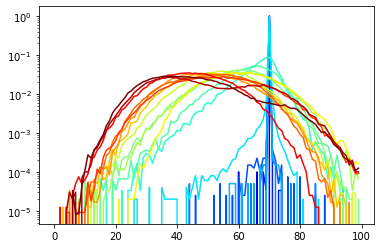

In [1093]:
for i in range(dim_hists2.shape[1]):
    plt.plot(dim_hists2[0,i], c=plt.cm.jet(dim_range2[i]/max_dims))
plt.yscale('log')
plt.show()

Dimensions:   0%|          | 0/199 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

Random Samples:   0%|          | 0/100 [00:00<?, ?it/s]

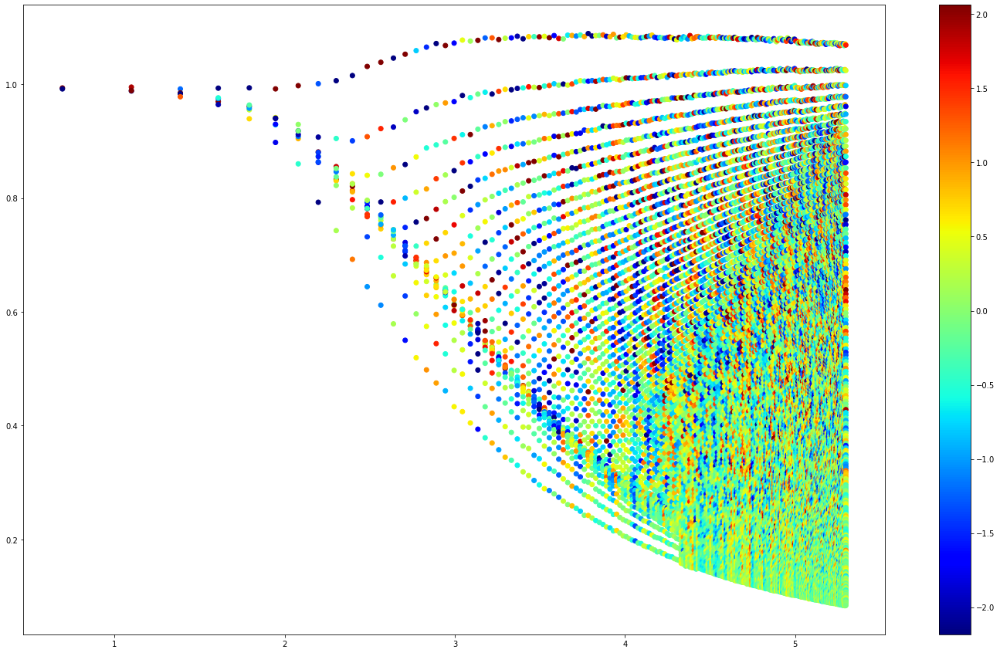

In [1137]:
max_dims = 200
samples = 100
iters = 20
bins = 500
skip_iters = 2
lim = np.sqrt(2)
extent = np.array([
    [-lim, lim],
    [-lim, lim]
])

def get_mag_hist(vals, bins=bins, range=[0, lim], skip_iters=skip_iters):
    hist, edges = np.histogram(
        np.absolute(vals[:,skip_iters:]).reshape(-1), 
        bins=bins, 
        range=[0, lim]
    )
    if hist.sum() > 0:
        hist = hist / hist.sum()
    return hist


dim_range2 = np.arange(2, max_dims+1)
dim_hists2 = np.zeros((9, dim_range2.size, bins))
eig_means, real_means = [], []
for dim_idx, dims in enumerate(tqdm.notebook.tqdm(dim_range2, "Dimensions")):
    means, mean_real = np.zeros(dims), np.zeros(dims)
    for sample in tqdm.notebook.tqdm(range(samples), "Random Samples", leave=False):
        eigvals = np.zeros((dims, iters), dtype=np.complex)
        mat = np.random.randn(dims, dims)
        for i in range(iters):
            vals, mat = np.linalg.eig(mat)
            eigvals[:,i] = vals
            
        #pos_idxs = eigvals[:,0].real > 0
        #zero_idxs = np.isclose(eigvals[:,0].real, 0)
        #neg_idxs = eigvals[:,0].real < 0
        #imag_zero_idxs = np.isclose(eigvals[:,0].imag, 0)
        
        all_dists = np.absolute(eigvals[:,skip_iters:])
        means += all_dists.mean(axis=-1)
        mean_real += eigvals[:,0].real
    means /= samples
    mean_real /= samples
    eig_means.append(means)
    real_means.append(mean_real)
    plt.scatter(
        np.full_like(means, np.log(dims) / np.log(np.e)),
        #np.absolute(eigvals[:,0]),#.real, 
        means, 
        #color=plt.cm.jet(np.log(dims) / np.log(max_dims))
        c=mean_real,
        cmap='jet'
    )
plt.colorbar()
plt.gcf().set_size_inches(25, 15)
plt.show()
        
        
        #dim_hists2[0,dim_idx] += get_mag_hist(eigvals[pos_idxs])
        #dim_hists2[1,dim_idx] += get_mag_hist(eigvals[zero_idxs])
        #dim_hists2[2,dim_idx] += get_mag_hist(eigvals[neg_idxs])
        #dim_hists2[3,dim_idx] += get_mag_hist(eigvals[np.logical_and(pos_idxs, imag_zero_idxs)])
        #dim_hists2[4,dim_idx] += get_mag_hist(eigvals[np.logical_and(zero_idxs, imag_zero_idxs)])
        #dim_hists2[5,dim_idx] += get_mag_hist(eigvals[np.logical_and(neg_idxs, imag_zero_idxs)])
        #dim_hists2[6,dim_idx] += get_mag_hist(eigvals[np.logical_and(pos_idxs, ~imag_zero_idxs)])
        #dim_hists2[7,dim_idx] += get_mag_hist(eigvals[np.logical_and(zero_idxs, ~imag_zero_idxs)])
        #dim_hists2[8,dim_idx] += get_mag_hist(eigvals[np.logical_and(neg_idxs, ~imag_zero_idxs)])

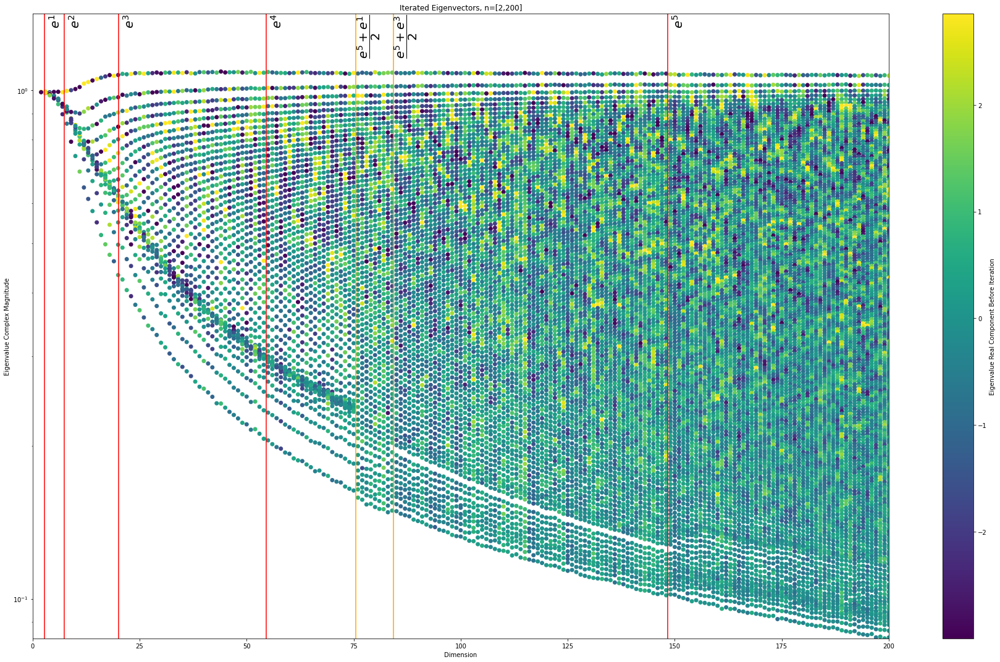

In [1384]:
from scipy.stats import zscore

for i in range(len(eig_means)):
    plt.scatter(
        np.full_like(eig_means[i], dim_range2[i]),
        #np.full_like(eig_means[i], np.log(dim_range2[i]) / np.log(np.e)),
        #np.absolute(eigvals[:,0]),#.real, 
        eig_means[i],
        #color=plt.cm.jet(np.log(dims) / np.log(max_dims))
        c=zscore(real_means[i]),
        cmap='viridis',
        s=35,
    )
    
x = np.arange(1, 6)
x = np.power(np.e, x)
plt.vlines(
    x, 
    np.full_like(x, np.log(min([em.min() for em in eig_means]))), 
    np.full_like(x, np.sqrt(2)),
    color='red'
)
for i in np.arange(1, 6):
    y = np.power(np.e, i)
    plt.text(
        y+1, 
        np.sqrt(2), 
        r"$e^{0}$".format(i), 
        rotation=90, 
        verticalalignment='top', 
        fontsize=20, 
        weight='bold'
    )

for i in range(5, 6):
    for j in range(i % 2, i, 2):
        if j < 1:
            continue
        x = (np.power(np.e, i) + np.power(np.e, j)) / 2
        plt.vlines(x, np.log(min([em.min() for em in eig_means])), np.sqrt(2), color='orange')
        ijstr = F"e^{i}+e^{j}".format(i=i, j=j)
        plt.text(
            x, 
            np.sqrt(2), 
            r"$\dfrac{" + ijstr + r"}{2}$", 
            rotation=90, 
            verticalalignment='top', 
            fontsize=20,
            weight='bold'
        )
        

plt.colorbar(label="Eigenvalue Real Component Before Iteration")
plt.xlim(0, dim_range2.max())
plt.ylim(min([em.min() for em in eig_means]), np.sqrt(2))
plt.yscale('log')
plt.title("Iterated Eigenvectors, n=[2,200]")
plt.ylabel("Eigenvalue Complex Magnitude")
plt.xlabel("Dimension")
plt.gcf().set_size_inches(25, 15)
plt.tight_layout()
labels = plt.gca().get_xticklabels()
plt.tight_layout()
plt.show()

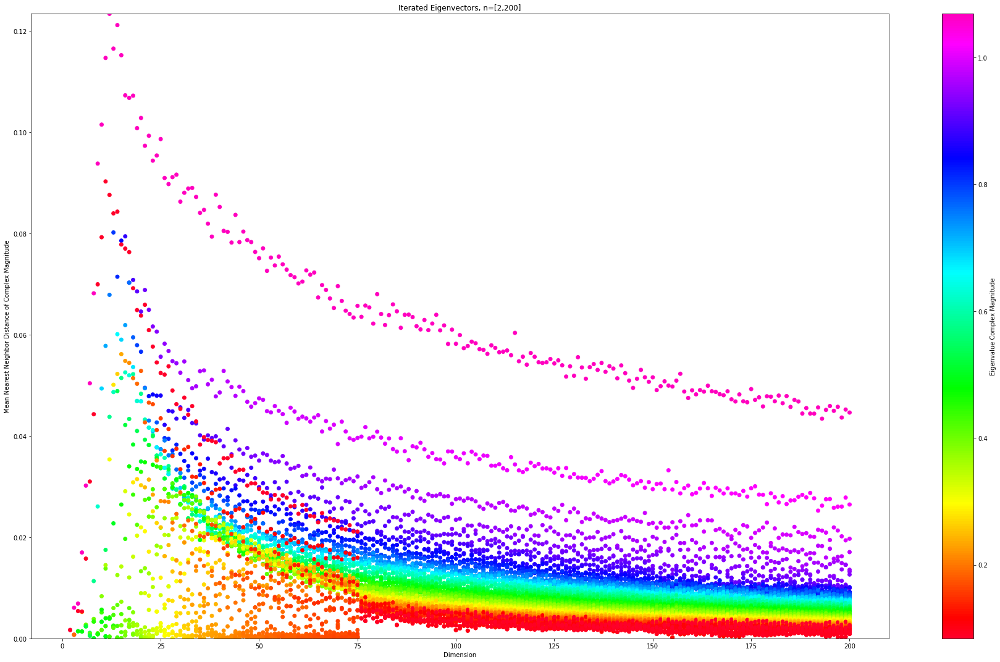

In [1377]:
from scipy.spatial.distance import cdist

max_dist = 0
for i in range(len(eig_means)):
    means = eig_means[i].reshape(-1, 1)
    dists = (cdist(means, means) + np.eye(eig_means[i].shape[0]) * 1e16)
    nn_idxs = dists.argmin(axis=-1)
    nn_dists = dists.min(axis=-1)

    max_dist = max(max_dist, nn_dists.max())
    plt.scatter(
        np.full_like(eig_means[i], dim_range2[i]),
        #np.full_like(eig_means[i], np.log(dim_range2[i]) / np.log(np.e)),
        #np.absolute(eigvals[:,0]),#.real, 
        nn_dists,
        #color=plt.cm.jet(np.log(dims) / np.log(max_dims))
        #c=real_means[i],
        c=eig_means[i],
        cmap='gist_rainbow',
        s=35,
    )
plt.colorbar(label="Eigenvalue Complex Magnitude")
plt.ylim(0, max_dist)
#plt.yscale('symlog')
plt.title("Iterated Eigenvectors, n=[2,200]")
plt.ylabel("Mean Nearest Neighbor Distance of Complex Magnitude")
plt.xlabel("Dimension")
plt.gcf().set_size_inches(25, 15)
plt.tight_layout()
labels = plt.gca().get_xticklabels()
plt.tight_layout()
plt.show()

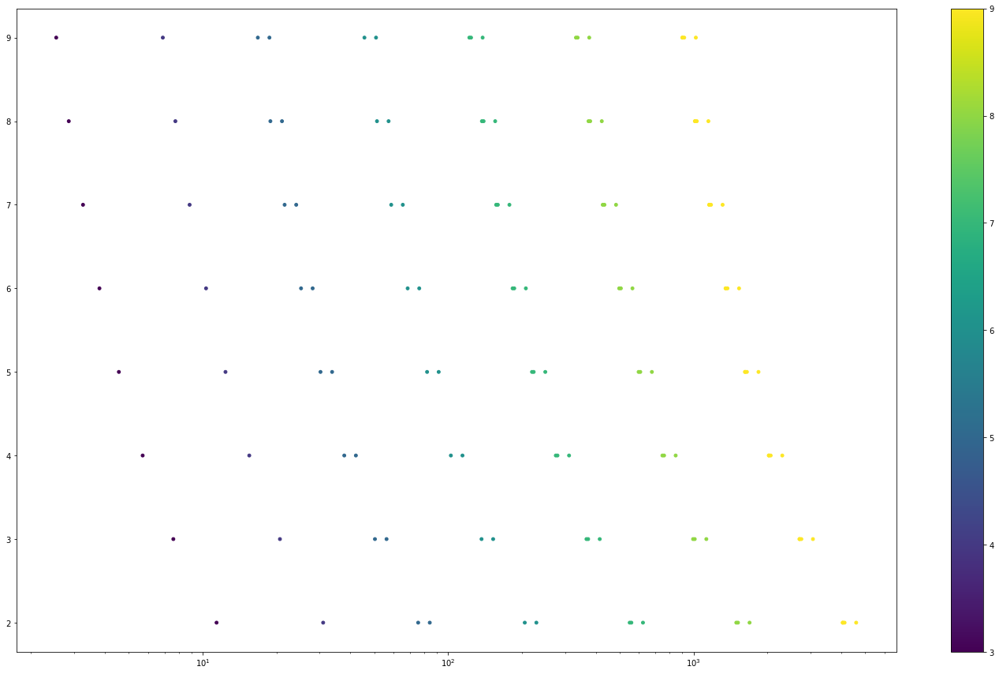

In [1263]:
line = np.arange(1, 10)
grids = np.meshgrid(line, line, line)
means = (np.power(np.e, grids[0]) + np.power(np.e, grids[1])) / grids[2]
for i in range(len(line)):
    inc_idxs = grids[0][...,i] > grids[1][...,i]
    inc_idxs = np.logical_and(inc_idxs, grids[0][...,i] % 2 == grids[1][...,i] % 2)
    inc_idxs = np.logical_and(inc_idxs, grids[2][...,i] > 1)
    plt.scatter(means[inc_idxs,i], grids[2][inc_idxs,i], c=grids[0][inc_idxs,i], s=15)
plt.xscale('log')
plt.colorbar()
plt.gcf().set_size_inches(25, 15)
plt.show()

In [14]:
key = jax.random.PRNGKey(0)

n = 128
iters = 1000

mat = jnp.asarray(jax.random.normal(key, (n, n)), dtype=jnp.complex64)
fn = jax.jit(jnp.linalg.eig, backend='cpu')
for i in tqdm.notebook.tqdm(range(iters)):
    vals, mat = jnp.linalg.eig(mat)
print(mat.shape)

  0%|          | 0/1000 [00:00<?, ?it/s]

NotImplementedError: Nonsymmetric eigendecomposition is only implemented on the CPU backend